In [2]:
import pandas as pd
from matplotlib import pyplot as plt
import numpy as np
from scipy.io import mmread
import sys
from anndata import AnnData
import scanpy as sc
import importlib
from collections import defaultdict, Counter
import json
import seaborn as sns
from scipy.stats import chisquare, spearmanr, pearsonr
from statsmodels.stats.multitest import multipletests
import warnings
from os.path import join

import spatialcorr

DATA_ROOT = './data'
RESULTS_ROOT = './results'

warnings.simplefilter(action='ignore', category=FutureWarning)

In [3]:
df_meta = pd.read_csv(join(DATA_ROOT, 'row_data.csv'), index_col=0)
df_meta['tissue'] = np.full(df_meta.shape[0], 1)
df_meta

,row,col,tissue
8x20,20,8,1
8x22,22,8,1
8x24,24,8,1
9x19,19,9,1
9x21,21,9,1
...,...,...,...
48x32,32,48,1
48x34,34,48,1
49x27,27,49,1
49x29,29,49,1


In [3]:
df_counts = pd.read_csv(join(DATA_ROOT, 'GSM4284326_P10_ST_rep2_stdata.filtered.tsv'), index_col=0, sep='\t')
df_counts

,FO538757.1,SAMD11,NOC2L,KLHL17,PLEKHN1,PERM1,HES4,ISG15,AGRN,RNF223,...,BPY2,DAZ1,DAZ2,AC012005.2,AC012005.1,BPY2B,DAZ3,DAZ4,AC006386.1,AC006328.1
8x20,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,2.0,0.0
8x22,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0
8x24,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
9x19,2.0,0.0,1.0,0.0,3.0,0.0,0.0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0
9x21,1.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,7.0,0.0,0.0,0.0,4.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48x32,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
48x34,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
49x27,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
49x29,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0


### Filter tissue spots

In [4]:
total_counts = np.sum(df_counts, axis=1)
df_meta['total_umi_count'] = total_counts
df_meta = df_meta.loc[df_meta['total_umi_count'] > 100]
df_counts = df_counts.loc[df_meta.index]

assert df_counts.shape[0] == df_meta.shape[0]

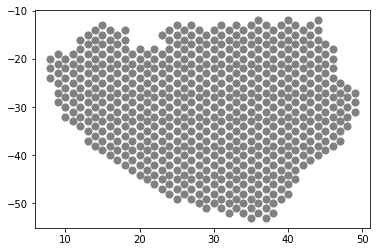

In [5]:
y = -1 * np.array(df_meta['row'])
x = df_meta['col']
fig = plt.gcf()
plt.scatter(x,y,c='grey', s=50)
plt.show()

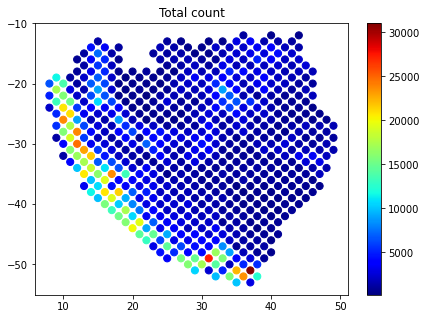

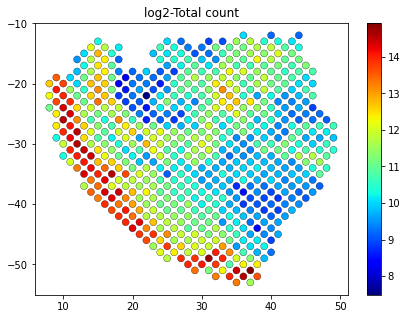

In [6]:
total_counts = np.sum(df_counts, axis=1)
spatialcorr.plot_slide(
    df_meta, 
    total_counts, 
    cmap='jet',
    colorbar=True,
    title="Total count",
    dsize=50
)

spatialcorr.plot_slide(
    df_meta, 
    np.log2(total_counts), 
    cmap='jet',
    colorbar=True,
    title="log2-Total count",
    dsize=50,
    spot_borders=True,
    border_color='black',
    border_size=0.3
)

In [7]:
df_dino = pd.read_csv(join(DATA_ROOT, 'GSM4284326_P10_ST_rep2_stdata.filtered.dino.tsv.gz'), sep='\t', index_col=0)
df_dino = df_dino.transpose()
df_dino.index = [x[1:] for x in df_dino.index]
df_dino = df_dino.loc[df_meta.index]
df_dino

,FO538757.1,SAMD11,NOC2L,KLHL17,PLEKHN1,PERM1,HES4,ISG15,AGRN,RNF223,...,BPY2,DAZ1,DAZ2,AC012005.2,AC012005.1,BPY2B,DAZ3,DAZ4,AC006386.1,AC006328.1
8x20,0.139,0.000,0.134,0.093,0.112,0.0,0.000,0.000,0.001,0.0,...,0.0,0.0,0.0,0.0,0.567,0.0,0.0,0.0,0.545,0.0
8x22,0.115,0.003,0.138,0.000,0.131,0.0,0.000,0.000,0.007,0.0,...,0.0,0.0,0.0,0.0,0.459,0.0,0.0,0.0,0.471,0.0
8x24,0.089,0.000,0.089,0.054,0.120,0.0,0.107,0.067,0.095,0.0,...,0.0,0.0,0.0,0.0,0.354,0.0,0.0,0.0,0.199,0.0
9x19,0.246,0.000,0.095,0.039,0.190,0.0,0.061,0.000,0.164,0.0,...,0.0,0.0,0.0,0.0,0.147,0.0,0.0,0.0,0.249,0.0
9x21,0.128,0.000,0.127,0.001,0.009,0.0,0.102,0.085,0.013,0.0,...,0.0,0.0,0.0,0.0,0.653,0.0,0.0,0.0,0.359,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48x32,0.158,0.043,0.150,0.047,0.121,0.0,0.000,0.048,0.079,0.0,...,0.0,0.0,0.0,0.0,0.708,0.0,0.0,0.0,0.389,0.0
48x34,0.160,0.015,0.139,0.087,0.115,0.0,0.000,0.095,0.006,0.0,...,0.0,0.0,0.0,0.0,0.314,0.0,0.0,0.0,0.703,0.0
49x27,0.117,0.000,0.140,0.068,0.118,0.0,0.089,0.117,0.010,0.0,...,0.0,0.0,0.0,0.0,0.379,0.0,0.0,0.0,0.434,0.0
49x29,0.263,0.021,0.138,0.000,0.122,0.0,0.000,0.046,0.000,0.0,...,0.0,0.0,0.0,0.0,1.283,0.0,0.0,0.0,1.000,0.0


In [8]:
df_clust = pd.read_csv(join(DATA_ROOT, 'BayesSpace_output.11_clusts.tsv'), sep='\t', index_col=0)
df_clust = df_clust.loc[df_meta.index]
new_clusts = []
for clust in df_clust['spatial.cluster']:
    if clust == 11:
        new_clusts.append(10)
    else:
        new_clusts.append(clust)
df_meta['BayesSpace'] = new_clusts
df_clust

/Users/matthewbernstein/Development/python3_dev/lib/python3.7/site-packages/ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  if __name__ == '__main__':


,row,col,sizeFactor,cluster.init,spatial.cluster
8x20,20,8,1.765542,1,1
8x22,22,8,1.340959,1,1
8x24,24,8,0.596164,1,1
9x19,19,9,3.177538,2,4
9x21,21,9,4.715489,2,2
...,...,...,...,...,...
48x32,32,48,0.524854,6,6
48x34,34,48,0.402452,6,6
49x27,27,49,0.436331,6,6
49x29,29,49,0.252728,9,6


In [9]:
adata = AnnData(df_dino)
adata.obs = df_meta
adata

AnnData object with n_obs × n_vars = 620 × 16642
    obs: 'row', 'col', 'tissue', 'total_umi_count', 'BayesSpace'

In [10]:
adata_counts = AnnData(df_counts)
adata_counts

AnnData object with n_obs × n_vars = 620 × 16642

In [12]:
n_spots_umi_gt_1 = np.sum((adata_counts.X > 0).astype(int), axis=0)
frac_spots_umi_gt_1 = np.sum((adata_counts.X > 0).astype(int), axis=0) / adata_counts.X.shape[0]
mean_umis = np.mean(adata_counts.X, axis=0)
variance_umis = np.var(adata_counts.X, axis=0)
median_umis = np.median(adata_counts.X, axis=0)
cv_umis = np.sqrt(variance_umis) / mean_umis
gene_stats_df = pd.DataFrame(
    data={
        'Mean UMI count': mean_umis,
        'Median UMI count': median_umis,
        'Variance UMI count': variance_umis,
        'Coefficient of variation UMI': cv_umis,
        'Number of spots w/ >1 UMI': n_spots_umi_gt_1,
        'Fraction of spots w/ >1 UMI':frac_spots_umi_gt_1
    },
    index=adata_counts.var.index
)
gene_stats_df

/Users/matthewbernstein/Development/python3_dev/lib/python3.7/site-packages/ipykernel_launcher.py:6: RuntimeWarning: invalid value encountered in true_divide
  


,Mean UMI count,Median UMI count,Variance UMI count,Coefficient of variation UMI,Number of spots w/ >1 UMI,Fraction of spots w/ >1 UMI
FO538757.1,0.335484,0.0,0.474547,2.053374,148,0.238710
SAMD11,0.024194,0.0,0.023608,6.350853,15,0.024194
NOC2L,0.274194,0.0,0.424818,2.377082,123,0.198387
KLHL17,0.058065,0.0,0.074048,4.686466,30,0.048387
PLEKHN1,0.229032,0.0,0.315286,2.451635,110,0.177419
...,...,...,...,...,...,...
BPY2B,0.000000,0.0,0.000000,NaN,0,0.000000
DAZ3,0.004839,0.0,0.004815,14.341084,3,0.004839
DAZ4,0.008065,0.0,0.007999,11.090537,5,0.008065
AC006386.1,0.883871,0.0,2.657482,1.844362,259,0.417742


### Rank genes by expression

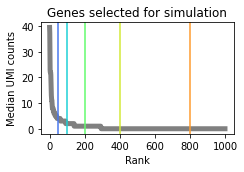

In [13]:
gene_stats_df_sort = gene_stats_df.sort_values('Median UMI count', axis=0, ascending=False)

fig, ax = plt.subplots(
    1,
    1,
    figsize = (3.5,2.5)
)
plt.plot(
    np.arange(0,1000),
    gene_stats_df_sort.iloc[:1000]['Median UMI count'],
    color='grey',
    lw=5
)

turbo_pal = sns.color_palette("turbo")
plt.axvline(x=50, c=turbo_pal[0])   
plt.axvline(x=100, c=turbo_pal[1])   
plt.axvline(x=200, c=turbo_pal[2])   
plt.axvline(x=400, c=turbo_pal[3]) 
plt.axvline(x=800, c=turbo_pal[4])   
#plt.axvline(x=1600, ymax=0.045, c='red')   # NDUFS8 Index
plt.title('Genes selected for simulation')
plt.xlabel('Rank')
plt.ylabel('Median UMI counts')

plt.tight_layout()
#fig.savefig(join(DATA_ROOT, 'figures/genes_ranked_highlight_selected.pdf'), format='pdf')

plt.show()

In [21]:
list(gene_stats_df.sort_values('Median UMI count', axis=0, ascending=False).index)[:50]

['S100A8',
 'S100A9',
 'KRT6A',
 'KRT16',
 'KRT10',
 'S100A7',
 'KRT6B',
 'KRT1',
 'KRT5',
 'KRT14',
 'MT-CO3',
 'KRT6C',
 'SFN',
 'MT-CO2',
 'RPL13',
 'RPLP1',
 'ACTB',
 'PERP',
 'MT-CO1',
 'LGALS7B',
 'S100A2',
 'SPRR1B',
 'KRT17',
 'RPLP2',
 'LGALS7',
 'KRTDAP',
 'DMKN',
 'RPS12',
 'GJB2',
 'RPS6',
 'EEF1A1',
 'TPT1',
 'RPL36',
 'RPL13A',
 'RPS18',
 'RPLP0',
 'RPL39',
 'RPS24',
 'RPL28',
 'MT-ND4',
 'PFN1',
 'RPL37A',
 'RPS17',
 'SBSN',
 'RPL37',
 'RPL34',
 'RPL11',
 'RPL27A',
 'CALML5',
 'RPS8']

In [28]:
print(list(gene_stats_df.sort_values('Median UMI count', axis=0, ascending=False).index).index('KRT16'))
print(list(gene_stats_df.sort_values('Median UMI count', axis=0, ascending=False).index).index('KRT6A'))
print(list(gene_stats_df.sort_values('Median UMI count', axis=0, ascending=False).index).index('KRT6B'))
print(list(gene_stats_df.sort_values('Median UMI count', axis=0, ascending=False).index).index('KRT6C'))
print(list(gene_stats_df.sort_values('Median UMI count', axis=0, ascending=False).index).index('KRT17'))
print(list(gene_stats_df.sort_values('Median UMI count', axis=0, ascending=False).index).index('KRT5'))
print(list(gene_stats_df.sort_values('Median UMI count', axis=0, ascending=False).index).index('KRT14'))
print(list(gene_stats_df.sort_values('Median UMI count', axis=0, ascending=False).index).index('KRT10'))
print(list(gene_stats_df.sort_values('Median UMI count', axis=0, ascending=False).index).index('KRT1'))

3
2
6
11
22
8
9
4
7


## Examine TSK scores

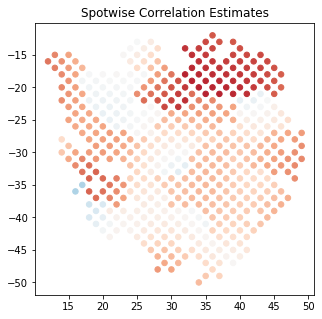

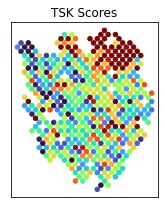

/Users/matthewbernstein/Development/python3_dev/lib/python3.7/site-packages/ipykernel_launcher.py:174: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "bbox_layout" which is no longer supported as of 3.3 and will become an error in 3.6


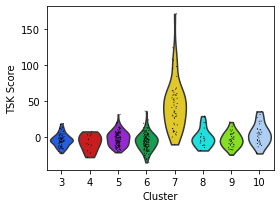

In [29]:
tsk_genes = [
    'MMP10',
    'PTHLH',
    'FEZ1',
    'IL24',
    'KCNMA1',
    'INHBA',
    'MAGEA4',
    'NT5E',
    'LAMC2',
    'SLITRK6',
    'MMP1',
    'SERPINE1',
    'SERPINE2',
    'IGFBP6',
    'TNC',
    'ITGA5',
    'ECM1',
    'SPINK6',
    'TMSB10',
    'KRT18',
    'FST',
    'ODC1',
    'LAMB3',
    'ITGA6',
    'ACTB',
    'ITGB1',
    'SORL1',
    'PFN1',
    'EMP3',
    'S100A10',
    'EREG',
    'LAMA3',
    'PRKCDBP',
    'OCIAD2',
    'CTSV',
    'ANXA3',
    'S100A2',
    'MET',
    'CD99',
    'TMSB4X',
    'TIMP3',
    'TPM4',
    'NEFM',
    'SCG5',
    'SH3BGRL3',
    'PLAU',
    'PKM',
    'CD63',
    'LGALS1',
    'BMP1',
    'TNFRSF12A',
    'ATP1B1',
    'CFL1',
    'MBOAT2',
    'F3',
    'TNFRSF21',
    'CLIC1',
    'CAP1',
    'PDPN',
    'SERINC2',
    'ANXA1',
    'BSG',
    'DSG2',
    'RHOC',
    'KRT17',
    'PDLIM7',
    'PHLDA1',
    'GLO1',
    'LTBP1',
    'TAGLN2',
    'CD151',
    'CAPN2',
    'COL5A2',
    'IGFBP2',
    'P4HA2',
    'COL17A1',
    'PLEK2',
    'AREG',
    'ARPC1B',
    'GLIPR1',
    'S100A6',
    'PLOD3',
    'YWHAZ',
    'CAV1',
    'ADIRF',
    'TGFBI',
    'RBP1',
    'FSTL3',
    'C16orf74',
    'UPP1',
    'TNNT1',
    'ANXA5',
    'SDC1',
    'PRDX5',
    'MYL12A',
    'GJB6',
    'SLC7A8',
    'RAB32',
    'FXYD5',
    'FSCN1'   
]
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
X_zs = scaler.fit_transform(adata.X)
adata_zs = AnnData(
    X=X_zs,
    obs=adata.obs,
    var=adata.var
)

tsk_zs = []
for gene in tsk_genes:
    try:
        tsk_zs.append(adata_zs.obs_vector(gene))
    except KeyError:
        print(f'{gene} not in data...')
tsk_zs = np.array(tsk_zs)

tsk_scores = np.sum(tsk_zs, axis=0)
adata_zs.obs['TSK Score'] = tsk_scores

# Filter spots
corrs, kept_inds_fig, _ = spatialcorr.plot.plot_correlation(
    adata,
    'KRT17', 'KRT6C',
    sigma=5,
    contrib_thresh=10,
    kernel_matrix=None,
    row_key='row',
    col_key='col',
    condition='BayesSpace',
    cmap='RdBu_r',
    colorbar=False,
    ticks=True,
    #ax=ax,
    #figure=None,
    estimate='local',
    dsize=30,
    title='Spotwise Correlation Estimates'
);

fig, ax = plt.subplots(1,1, figsize=(2.4, 3)) 
spatialcorr.plot_slide(
    adata.obs.iloc[kept_inds_fig], 
    tsk_scores[kept_inds_fig], 
    cmap='turbo',
    colorbar=False,
    title="TSK Scores",
    dsize=20,
    vmin=np.quantile(tsk_scores, 0.1),
    vmax=np.quantile(tsk_scores, 0.9),
    ax=ax,
    figure=fig,
    ticks=False
)
plt.tight_layout()
fig.savefig('./figures/Patient_10_TSK_Scores_heatmap.pdf', format='pdf')
plt.show()

fig, ax = plt.subplots(1,1, figsize=(4, 3))
sc.pl.violin(
    adata_zs[kept_inds_fig], 
    keys='TSK Score', 
    groupby='BayesSpace', 
    log=False, 
    palette=spatialcorr.plot.PALETTE_MANY, 
    ax=ax, 
    show=False
)
ax.set_xlabel('Cluster')
plt.tight_layout()
fig.savefig('./figures/Patient_10_TSK_Scores_violin.pdf', bbox_layout='tight', format='pdf')

## Summarize results 

BHR-Test
['GO_LEUKOCYTE_MIGRATION', 0.0001, 0.031]
['GO_MYELOID_LEUKOCYTE_MIGRATION', 0.0005, 0.0775]
['GO_NEGATIVE_REGULATION_OF_ENDOPLASMIC_RETICULUM_STRESS_INDUCED_INTRINSIC_APOPTOTIC_SIGNALING_PATHWAY', 0.006216972334473112, 0.6300813008130082]
['GO_GRANULOCYTE_MIGRATION', 0.008988764044943821, 0.6300813008130082]
['GO_REGULATION_OF_APOPTOTIC_SIGNALING_PATHWAY', 0.011204481792717087, 0.6300813008130082]
['GO_EXTRACELLULAR_MATRIX_DISASSEMBLY', 0.01483679525222552, 0.6300813008130082]
['GO_NEUTROPHIL_MIGRATION', 0.01774622892635315, 0.6300813008130082]
['GO_NEGATIVE_REGULATION_OF_EPITHELIAL_CELL_APOPTOTIC_PROCESS', 0.0182648401826484, 0.6300813008130082]
['GO_NEGATIVE_REGULATION_OF_EPITHELIAL_CELL_APOPTOTIC_PROCESS', 0.019762845849802372, 0.6300813008130082]
['GO_LEUKOCYTE_CELL_CELL_ADHESION', 0.023148148148148147, 0.6300813008130082]
['GO_ACTIVATION_OF_CYSTEINE_TYPE_ENDOPEPTIDASE_ACTIVITY_INVOLVED_IN_APOPTOTIC_PROCESS', 0.025157232704402517, 0.6300813008130082]
['GO_LYMPHOCYTE_MIGRA

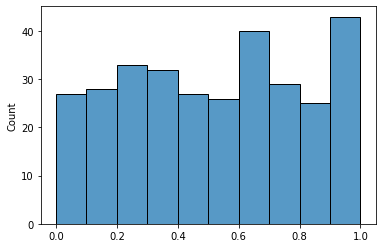

In [4]:
with open(join(RESULTS_ROOT, 'ANGIOGENESIS_RELATED.BHR.json'), 'r') as f:
    j_angiogenesis_bhr = json.load(f)
with open(join(RESULTS_ROOT, 'APOPTOSIS.BHR.json'), 'r') as f:
    j_apoptosis_bhr = json.load(f)
with open(join(RESULTS_ROOT, 'B_CELL.BHR.json'), 'r') as f:
    j_b_cell_bhr = json.load(f)
with open(join(RESULTS_ROOT, 'CALCIUM.BHR.json'), 'r') as f:
    j_calcium_bhr = json.load(f)
with open(join(RESULTS_ROOT, 'CELL_DEATH.BHR.json'), 'r') as f:
    j_cell_death_bhr = json.load(f)
with open(join(RESULTS_ROOT, 'CELL_CYCLE.BHR.json'), 'r') as f:
    j_cell_cycle_bhr = json.load(f)
with open(join(RESULTS_ROOT, 'CELL_DIVISION.BHR.json'), 'r') as f:
    j_cell_division_bhr = json.load(f)
with open(join(RESULTS_ROOT, 'DNA_REPAIR.BHR.json'), 'r') as f:
    j_dna_repair_bhr = json.load(f)
with open(join(RESULTS_ROOT, 'DNA_REPLICATION.BHR.json'), 'r') as f:
    j_dna_replication_bhr = json.load(f)
with open(join(RESULTS_ROOT, 'EPIDERMIS_DEVELOPMENT.BHR.json'), 'r') as f:
    j_epidermis_bhr = json.load(f)
with open(join(RESULTS_ROOT, 'EPITHELIAL.BHR.json'), 'r') as f:
    j_epithelial_bhr = json.load(f)
with open(join(RESULTS_ROOT, 'FIBROBLAST.BHR.json'), 'r') as f:
    j_fibroblast_bhr = json.load(f)
with open(join(RESULTS_ROOT, 'GO_CELL_CELL_ADHESION.BHR.json'), 'r') as f:
    j_cell_cell_adhesion_bhr = json.load(f)
with open(join(RESULTS_ROOT, 'GO_KERATINOCYTE_DIFFERENTIATION.BHR.json'), 'r') as f:
    j_keratinocyte_bhr = json.load(f)
with open(join(RESULTS_ROOT, 'HYPOXIA.BHR.json'), 'r') as f:
    j_hypoxia_bhr = json.load(f)
with open(join(RESULTS_ROOT, 'INTERFERON.BHR.json'), 'r') as f:
    j_interferon_bhr = json.load(f)
with open(join(RESULTS_ROOT, 'INTERLEUKIN_RELATED.BHR.json'), 'r') as f:
    j_interleukin_bhr = json.load(f)
with open(join(RESULTS_ROOT, 'MATRIX.BHR.json'), 'r') as f:
    j_matrix_bhr = json.load(f)
with open(join(RESULTS_ROOT, 'MIGRATION.BHR.json'), 'r') as f:
    j_migration_bhr = json.load(f)
with open(join(RESULTS_ROOT, 'T_CELL.BHR.json'), 'r') as f:
    j_t_cell_bhr = json.load(f)
    
res_l = [
    j_angiogenesis_bhr,
    j_apoptosis_bhr,
    j_b_cell_bhr,
    j_calcium_bhr,
    j_cell_cycle_bhr,
    j_cell_death_bhr,
    j_cell_division_bhr,
    j_dna_repair_bhr,
    j_dna_replication_bhr,
    j_epidermis_bhr,
    j_epithelial_bhr,
    j_fibroblast_bhr,
    j_cell_cell_adhesion_bhr,
    j_keratinocyte_bhr,
    j_hypoxia_bhr,
    j_interferon_bhr,
    j_interleukin_bhr,
    j_matrix_bhr,
    j_migration_bhr,
    j_t_cell_bhr
]
bhr_results = []
for res in res_l:
    bhr_results += res['gene_set_to_pval'].items()
    
print("BHR-Test")
gs_bhr_p_vals = [x[1] for x in bhr_results]
gs_bhr_p_vals_fdr, gs_bhr_p_vals_adj, _, _ = multipletests(
    gs_bhr_p_vals, 
    method='fdr_bh',
    alpha=0.05
)
bhr_results = [list(x) for x in bhr_results]
for adj, res in zip(gs_bhr_p_vals_adj, bhr_results):
    res.append(adj)
print('\n'.join(map(str, sorted(bhr_results, key=lambda x: x[1])[:50])))
print(Counter(gs_bhr_p_vals_fdr))
sns.histplot(gs_bhr_p_vals)
plt.show()

WHR-Test
['GO_EPIDERMIS_DEVELOPMENT', 0.0001, 0.010333333333333333]
['GO_EPITHELIAL_CELL_DIFFERENTIATION', 0.0001, 0.010333333333333333]
['GO_KERATINOCYTE_DIFFERENTIATION', 0.0001, 0.010333333333333333]
['GO_REGULATION_OF_CALCIUM_MEDIATED_SIGNALING', 0.0019, 0.1314116150911403]
['GO_INTRINSIC_APOPTOTIC_SIGNALING_PATHWAY_IN_RESPONSE_TO_ENDOPLASMIC_RETICULUM_STRESS', 0.00211954217888936, 0.1314116150911403]
['GO_POSITIVE_REGULATION_OF_EPIDERMIS_DEVELOPMENT', 0.002605184316790413, 0.13460118970083798]
['GO_DNA_SYNTHESIS_INVOLVED_IN_DNA_REPAIR', 0.0033967391304347825, 0.15042701863354038]
['GO_NEGATIVE_REGULATION_OF_LEUKOCYTE_CELL_CELL_ADHESION', 0.004793863854266539, 0.18576222435282838]
['GO_POSTREPLICATION_REPAIR', 0.005635390250774866, 0.1941078864155787]
['GO_REGULATION_OF_CELL_CELL_ADHESION', 0.00865051903114187, 0.268166089965398]
['GO_T_CELL_DIFFERENTIATION', 0.012953367875647668, 0.365049458313707]
['GO_POSITIVE_REGULATION_OF_CALCIUM_MEDIATED_SIGNALING', 0.02047082906857728, 0.492

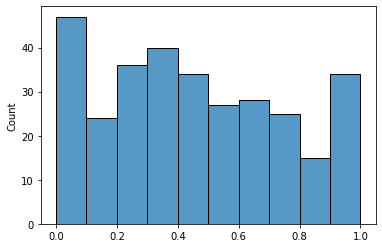

In [8]:
with open(join(RESULTS_ROOT, 'ANGIOGENESIS_RELATED.WHR.json'), 'r') as f:
    j_angiogenesis_whr = json.load(f)
with open(join(RESULTS_ROOT, 'APOPTOSIS.WHR.json'), 'r') as f:
    j_apoptosis_whr = json.load(f)
with open(join(RESULTS_ROOT, 'B_CELL.WHR.json'), 'r') as f:
    j_b_cell_whr = json.load(f)
with open(join(RESULTS_ROOT, 'CALCIUM.WHR.json'), 'r') as f:
    j_calcium_whr = json.load(f)
with open(join(RESULTS_ROOT, 'CELL_CYCLE.WHR.json'), 'r') as f:
    j_cell_cycle_whr = json.load(f)
with open(join(RESULTS_ROOT, 'CELL_DEATH.WHR.json'), 'r') as f:
    j_cell_death_whr = json.load(f)
with open(join(RESULTS_ROOT, 'CELL_DIVISION.WHR.json'), 'r') as f:
    j_cell_division_whr = json.load(f)
with open(join(RESULTS_ROOT, 'DNA_REPAIR.WHR.json'), 'r') as f:
    j_dna_repair_whr = json.load(f)
with open(join(RESULTS_ROOT, 'DNA_REPLICATION.WHR.json'), 'r') as f:
    j_dna_replication_whr = json.load(f)
with open(join(RESULTS_ROOT, 'EPIDERMIS_DEVELOPMENT.WHR.json'), 'r') as f:
    j_epidermis_whr = json.load(f)
with open(join(RESULTS_ROOT, 'EPITHELIAL.WHR.json'), 'r') as f:
    j_epithelial_whr = json.load(f)
with open(join(RESULTS_ROOT, 'FIBROBLAST.WHR.json'), 'r') as f:
    j_fibroblast_whr = json.load(f)
with open(join(RESULTS_ROOT, 'GO_CELL_CELL_ADHESION.WHR.json'), 'r') as f:
    j_cell_cell_adhesion_whr = json.load(f)
with open(join(RESULTS_ROOT, 'GO_KERATINOCYTE_DIFFERENTIATION.WHR.json'), 'r') as f:
    j_keratinocyte_whr = json.load(f)
with open(join(RESULTS_ROOT, 'HYPOXIA.WHR.json'), 'r') as f:
    j_hypoxia_whr = json.load(f)
with open(join(RESULTS_ROOT, 'INTERFERON.WHR.json'), 'r') as f:
    j_interferon_whr = json.load(f)
with open(join(RESULTS_ROOT, 'INTERLEUKIN_RELATED.WHR.json'), 'r') as f:
    j_interleukin_whr = json.load(f)
with open(join(RESULTS_ROOT, 'MATRIX.WHR.json'), 'r') as f:
    j_matrix_whr = json.load(f)
with open(join(RESULTS_ROOT, 'MIGRATION.WHR.json'), 'r') as f:
    j_migration_whr = json.load(f)
with open(join(RESULTS_ROOT, 'T_CELL.WHR.json'), 'r') as f:
    j_t_cell_whr = json.load(f)
    
res_l = [
    j_angiogenesis_whr,
    j_apoptosis_whr,
    j_b_cell_whr,
    j_calcium_whr,
    j_cell_cycle_whr,
    j_cell_death_whr,
    j_cell_division_whr,
    j_dna_repair_whr,
    j_dna_replication_whr,
    j_epidermis_whr,
    j_epithelial_whr,
    j_fibroblast_whr,
    j_cell_cell_adhesion_whr,
    j_keratinocyte_whr,
    j_hypoxia_whr,
    j_interferon_whr,
    j_interleukin_whr,
    j_matrix_whr,
    j_migration_whr,
    j_t_cell_whr
]
whr_results = []
for res in res_l:
    whr_results += res['gene_set_to_pval'].items()
    
gs_to_genes = {}
for res in res_l:
    gs_to_genes.update(res['gene_set_to_genes'])
    
print("WHR-Test")
gs_whr_p_vals = [x[1] for x in whr_results]

gs_whr_p_vals_fdr, gs_whr_p_vals_adj, _, _ = multipletests(
    gs_whr_p_vals, 
    method='fdr_bh',
    alpha=0.05
)
whr_results = [list(x) for x in whr_results]
for adj, res in zip(gs_whr_p_vals_adj, whr_results):
    res.append(adj)

print('\n'.join(map(str, sorted(whr_results, key=lambda x: x[1])[:20])))
print(Counter(gs_whr_p_vals_fdr))
sns.histplot(gs_whr_p_vals)
plt.show()

In [38]:
print(', '.join(gs_to_genes['GO_KERATINOCYTE_DIFFERENTIATION']))
print(', '.join(gs_to_genes['GO_EPIDERMIS_DEVELOPMENT']))
print(', '.join(gs_to_genes['GO_EPITHELIAL_CELL_DIFFERENTIATION']))
print(', '.join(gs_to_genes['GO_REGULATION_OF_CALCIUM_MEDIATED_SIGNALING']))
print(', '.join(gs_to_genes['GO_INTRINSIC_APOPTOTIC_SIGNALING_PATHWAY_IN_RESPONSE_TO_ENDOPLASMIC_RETICULUM_STRESS']))

CSTA, FLG, KRT1, KRT10, KRT14, KRT16, KRT17, KRT5, KRT6A, KRT6B, KRT6C, PERP, S100A7, SFN, SPRR1B
FLG, KRT1, KRT10, KRT14, KRT16, KRT17, KRT5, KRT6A, KRT6B, KRT6C, KRTDAP, PERP, S100A7, SFN, SPRR1B
CSTA, FLG, KRT1, KRT10, KRT14, KRT16, KRT17, KRT5, KRT6A, KRT6B, KRT6C, PERP, S100A7, SFN, SPRR1B
ATP2B4, CALM1, CALM2, CHP1, CIB1, ERBB3, FKBP1A, GSTO1, HINT1, PRNP, PTBP1, SPPL3
ATF4, BAG6, CASP4, CEBPB, ERO1A, ERP29, GRINA, HERPUD1, PARK7, SERINC3, TMBIM6, UBE2K, XBP1


In [33]:
print(', '.join(gs_to_genes['GO_LEUKOCYTE_MIGRATION']))
print(', '.join(gs_to_genes['GO_MYELOID_LEUKOCYTE_MIGRATION']))
print(', '.join(gs_to_genes['GO_NEGATIVE_REGULATION_OF_ENDOPLASMIC_RETICULUM_STRESS_INDUCED_INTRINSIC_APOPTOTIC_SIGNALING_PATHWAY']))
print(', '.join(gs_to_genes['GO_GRANULOCYTE_MIGRATION']))
print(', '.join(gs_to_genes['GO_REGULATION_OF_APOPTOTIC_SIGNALING_PATHWAY']))

ANXA1, ATP1B3, CD44, CD74, COL1A1, COL1A2, CXCL14, MYH9, PPIA, RPS19, S100A14, S100A7, S100A8, S100A9, SDC1
ANXA1, CD74, CD81, CD9, CD99, CXADR, HMGB1, IL1RN, RAC1, RPS19, S100A14, S100A7, S100A8, S100A9, WDR1
GRINA, HERPUD1, PARK7, TMBIM6, XBP1
ANXA1, CD74, CD99, CXADR, IL1RN, LGALS3, MAPK14, MAPK3, PECAM1, RAC1, S100A14, S100A7, S100A8, S100A9, WDR1
CD44, CD74, ENO1, GSTP1, HSPB1, RACK1, RPL11, RPL26, RPS3, RPS7, S100A8, S100A9, SFN, TPT1, YWHAZ


In [17]:
total_gene_sets = set()
for genes in gs_to_genes.values():
    total_gene_sets.add(frozenset(genes))
print("Total gene sets analyzed:", len(total_gene_sets))

Total gene sets analyzed: 287


### Generate figures for paper

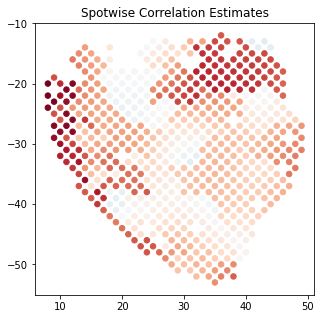

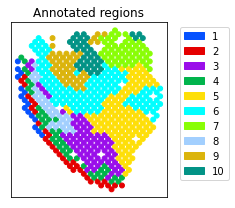

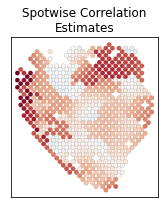

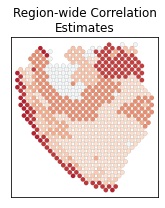

In [26]:
corrs, kept_inds_fig, _ = spatialcorr.plot.plot_correlation(
    adata,
    'KRT17', 'KRT6C',
    sigma=5,
    contrib_thresh=3,
    kernel_matrix=None,
    row_key='row',
    col_key='col',
    condition='BayesSpace',
    cmap='RdBu_r',
    colorbar=False,
    ticks=True,
    #ax=ax,
    #figure=None,
    estimate='local',
    dsize=30,
    title='Spotwise Correlation Estimates'
)
plt.show()

fig, ax = plt.subplots(1,1, figsize=(3.4, 3))
spatialcorr.plot_slide(
    adata[kept_inds_fig,:].obs, 
    adata[kept_inds_fig,:].obs['BayesSpace'], 
    cmap='categorical', 
    title="Annotated regions",
    colorbar=True,
    dsize=24,
    ticks=False,
    figure=fig,
    ax=ax
)

plt.tight_layout()
fig.savefig('./figures/MainFig_Clusters.pdf', format='pdf')

fig, ax = plt.subplots(1,1, figsize=(2.4, 3))
corrs, kept_inds, _ = spatialcorr.plot.plot_correlation(
    adata,
    'KRT17', 'KRT6C',
    sigma=5,
    contrib_thresh=3,
    kernel_matrix=None,
    row_key='row',
    col_key='col',
    condition='BayesSpace',
    cmap='RdBu_r',
    colorbar=False,
    ticks=False,
    ax=ax,
    #figure=None,
    estimate='local',
    dsize=20,
    title='Spotwise Correlation\nEstimates',
    spot_borders=True,
    border_color='black',
    border_size=0.1
)
plt.tight_layout()
fig.savefig('./figures/MainFig_LocalCorr.pdf', format='pdf')

fig, ax = plt.subplots(1,1, figsize=(2.4, 3))
corrs_reg, kept_inds, _ = spatialcorr.plot.plot_correlation(
    adata,
    'KRT17', 'KRT6C',
    sigma=5,
    contrib_thresh=3,
    kernel_matrix=None,
    row_key='row',
    col_key='col',
    condition='BayesSpace',
    cmap='RdBu_r',
    colorbar=False,
    ticks=False,
    ax=ax,
    #figure=None,
    estimate='regional',
    dsize=20,
    title='Region-wide Correlation\nEstimates',
    spot_borders=True,
    border_color='black',
    border_size=0.08
)
plt.tight_layout()
fig.savefig('./figures/MainFig_RegionCorr.pdf', format='pdf')

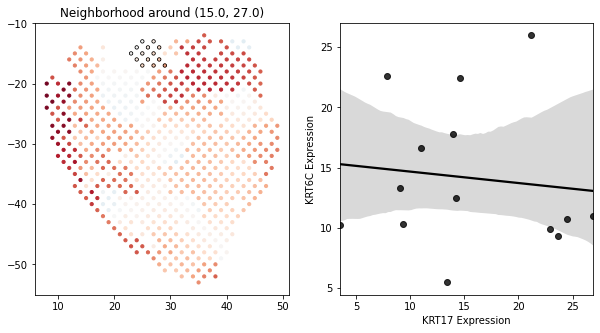

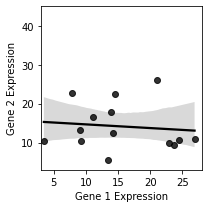

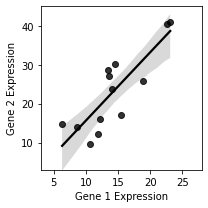

In [20]:
spatialcorr.plot.plot_local_scatter(
    adata[kept_inds_fig,:],
    'KRT17',
    'KRT6C',
    15,
    27,
    corrs,
    color_spots=None,
    condition='BayesSpace',
    vmin=-1,
    vmax=1,
    row_key='row',
    col_key='col',
    cmap='RdBu_r',
    neighb_color='black'
)

spatialcorr.plot.plot_local_scatter(
    adata[kept_inds_fig,:],
    'KRT17',
    'KRT6C',
    15,
    27,
    corrs,
    color_spots=None,
    condition='BayesSpace',
    vmin=-1,
    vmax=1,
    row_key='row',
    col_key='col',
    cmap='RdBu_r',
    neighb_color='black',
    plot_neigh=False,
    height=3,
    width=3,
    scatter_xlim=(3,28),
    scatter_ylim=(3,45),
    scatter_xlabel='Gene 1 Expression',
    scatter_ylabel='Gene 2 Expression',
    fig_path='./figures/MainFig_local_scatter_r15_c27.pdf',
    fig_format='pdf'
)
spatialcorr.plot.plot_local_scatter(
    adata[kept_inds_fig,:],
    'KRT17',
    'KRT6C',
    21,
    31,
    corrs,
    color_spots=None,
    condition='BayesSpace',
    vmin=-1,
    vmax=1,
    row_key='row',
    col_key='col',
    cmap='RdBu_r',
    neighb_color='black',
    plot_neigh=False,
    height=3,
    width=3,
    scatter_xlim=(3,28),
    scatter_ylim=(3,45),
    scatter_xlabel='Gene 1 Expression',
    scatter_ylabel='Gene 2 Expression',
    line_color='black',
    fig_path='./figures/MainFig_local_scatter_r21_c31.pdf',
    fig_format='pdf'
)

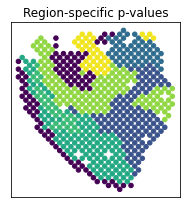

In [21]:
fig, ax = plt.subplots(1,1, figsize=(2.7, 3))
p_val, additional = spatialcorr.run_test(
    adata,
    ['KRT17', 'KRT6C'],
    5,
    cond_key='BayesSpace',
    contrib_thresh=10,
    row_key='row',
    col_key='col',
    verbose=0,
    n_procs=1,
    run_bhr=False,
    compute_spotwise_pvals=True,
    max_perms=500,
    mc_pvals=False
)
clust_to_p_val = additional['region_to_p_val']

spot_p_vals = []
for ct in adata.obs.iloc[kept_inds_fig]['BayesSpace']:
    if ct in clust_to_p_val:
        spot_p_vals.append(clust_to_p_val[ct])
    else:
        spot_p_vals.append(1)
   
spatialcorr.plot_slide(
    adata.obs.iloc[kept_inds_fig],
    spot_p_vals,
    cmap='viridis_r',
    colorbar=False,
    vmin=0,
    vmax=1,
    title='Region-specific p-values',
    ax=ax,
    figure=None,
    ticks=False,
    dsize=20,
    colorticks=None,
    row_key='row',
    col_key='col'
)
#plt.show()

plt.tight_layout()
fig.savefig('./figures/MainFig_WHRPval.pdf', format='pdf')

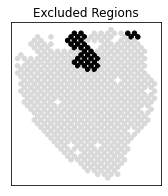

<Figure size 432x288 with 0 Axes>

In [17]:
fig, ax = plt.subplots(1,1, figsize=(2.7, 3))
thresh_spot_p_vals = [
    pval < 0.05
    for pval in spot_p_vals
]   
spatialcorr.plot_slide(
    adata.obs.iloc[kept_inds_fig],
    thresh_spot_p_vals,
    cmap='categorical',
    colorbar=False,
    vmin=0,
    vmax=1,
    title='Excluded Regions',
    ax=ax,
    figure=None,
    ticks=False,
    dsize=20,
    colorticks=None,
    row_key='row',
    col_key='col',
    cat_palette=['#d9d9d9', 'black']
)
plt.show()

plt.tight_layout()
fig.savefig('./figures_V2/MainFig_FiltBHR.pdf', format='pdf')

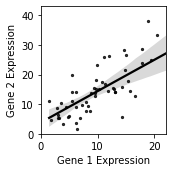

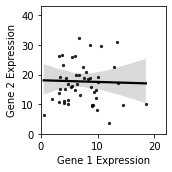

In [18]:
fig, ax = plt.subplots(1,1, figsize=(2.5, 2.5))
spatialcorr.plot.plot_cluster_scatter(
    'KRT17',
    'KRT6C',
    adata,
    'BayesSpace',
    7,
    col_vals=None,
    cmap=None,
    color='black',
    xlim=(0,22),
    ylim=(0,43),
    ax=ax,
    xlabel='Gene 1 Expression',
    ylabel='Gene 2 Expression'
)
plt.tight_layout()
fig.savefig('./figures_V2/MainFig_region_scatter_c7.pdf', format='pdf')

fig, ax = plt.subplots(1,1, figsize=(2.5, 2.5))
spatialcorr.plot.plot_cluster_scatter(
    'KRT17',
    'KRT6C',
    adata,
    'BayesSpace',
    9,
    col_vals=None,
    cmap=None,
    color='black',
    xlim=(0,22),
    ylim=(0,43),
    ax=ax,
    xlabel='Gene 1 Expression',
    ylabel='Gene 2 Expression'
)
plt.tight_layout()
fig.savefig('./figures_V2/MainFig_region_scatter_c9.pdf', format='pdf')

defaultdict(<function run_test_between_region_pairs.<locals>.<lambda> at 0x7f9f9ebc8560>, {4: {3: 0.79, 5: 0.53, 6: 0.96, 7: 0.41, 8: 0.01, 9: 0.59}, 3: {4: 0.79, 5: 0.42, 6: 0.2, 7: 0.02, 8: 0.28, 9: 0.65}, 5: {3: 0.42, 4: 0.53, 6: 1.0, 7: 0.02, 8: 0.8, 9: 0.56}, 6: {3: 0.2, 4: 0.96, 5: 1.0, 7: 0.04, 8: 0.39, 9: 0.98}, 7: {3: 0.02, 4: 0.41, 5: 0.02, 6: 0.04, 8: 0.65, 9: 0.04}, 8: {3: 0.28, 4: 0.01, 5: 0.8, 6: 0.39, 7: 0.65, 9: 0.57}, 9: {3: 0.65, 4: 0.59, 5: 0.56, 6: 0.98, 7: 0.04, 8: 0.57}})


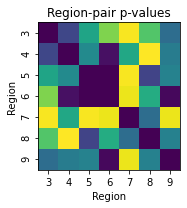

In [25]:
fig, ax = plt.subplots(1,1, figsize=(2.7, 3))
run_regions = [
    ct
    for ct, p_val in clust_to_p_val.items()
    if p_val >= 0.05
]
ct_to_ct_to_pval = spatialcorr.statistical_test.run_test_between_region_pairs(
    adata,
    ['KRT17', 'KRT6C'],
    5,
    'BayesSpace',
    contrib_thresh=10,
    row_key='row',
    col_key='col',
    verbose=0,
    n_procs=1,
    standardize_var=False,
    max_perms=100,
    mc_pvals=False,
    spot_to_neighbors=None,
    run_regions=run_regions
)
print(ct_to_ct_to_pval)
da = []
for ct_1 in sorted(set(ct_to_ct_to_pval.keys())):
    row = []
    for ct_2 in sorted(set(ct_to_ct_to_pval.keys())):
        if ct_1 == ct_2:
            row.append(1)
        else:
            row.append(ct_to_ct_to_pval[ct_1][ct_2])
    da.append(row)
df_plot = pd.DataFrame(
    data=da,
    columns=sorted(set(ct_to_ct_to_pval.keys())),
    index=sorted(set(ct_to_ct_to_pval.keys()))
)

mask = np.triu(np.ones_like(np.array(df_plot)))
#sns.despine()
res = sns.heatmap(df_plot, cmap='viridis_r', cbar=False, ax=ax)#,  mask=mask)
for _, spine in res.spines.items():
    spine.set_visible(True)
ax.set_title(f'Region-pair p-values')
ax.set_ylabel('Region')
ax.set_xlabel('Region')

plt.tight_layout()
fig.savefig('./figures/MainFig_region_pair_pvals.pdf', format='pdf')

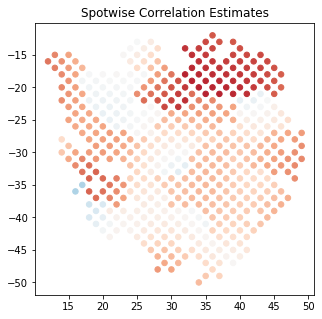

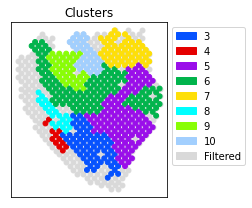

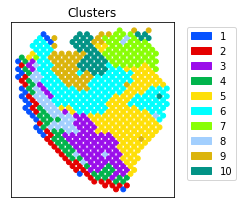

In [10]:
import matplotlib.patches as mpatches

# Filter spots
corrs, kept_inds_fig, _ = spatialcorr.plot.plot_correlation(
    adata,
    'KRT17', 'KRT6C',
    sigma=5,
    contrib_thresh=10,
    kernel_matrix=None,
    row_key='row',
    col_key='col',
    condition='BayesSpace',
    cmap='RdBu_r',
    colorbar=False,
    ticks=True,
    #ax=ax,
    #figure=None,
    estimate='local',
    dsize=30,
    title='Spotwise Correlation Estimates'
);



fig, ax = plt.subplots(1,1, figsize=(3.6, 3))
y = -1 * np.array(adata.obs['row'])
x = adata.obs['col']
ax.scatter(x,y,c='#d9d9d9', s=24)
spatialcorr.plot_slide(
    adata.obs.iloc[kept_inds_fig], 
    adata.obs.iloc[kept_inds_fig]['BayesSpace'], 
    cmap='categorical', 
    title="Clusters",
    colorbar=True,
    dsize=24,
    ticks=False,
    figure=fig,
    ax=ax
)
handles, labels = ax.get_legend_handles_labels() 
handles = []
for ci, clust in enumerate(sorted(set(adata.obs.iloc[kept_inds_fig]['BayesSpace']))):
    handles.append(
        mpatches.Patch(
            color=spatialcorr.plot.PALETTE_MANY[ci], 
            label=clust
        )
    )
patch = mpatches.Patch(color='#d9d9d9', label='Filtered')
handles.append(patch) 
ax.legend(handles=handles, bbox_to_anchor=(1, 1))
plt.tight_layout()
fig.savefig('./figures/P10_clusters_filt.pdf', format='pdf')

fig, ax = plt.subplots(1,1, figsize=(3.5, 3))
spatialcorr.plot_slide(
    adata.obs, 
    adata.obs['BayesSpace'], 
    cmap='categorical', 
    title="Clusters",
    colorbar=True,
    dsize=24,
    ticks=False,
    figure=fig,
    ax=ax
)

plt.tight_layout()
fig.savefig('./figures/P10_clusters.pdf', format='pdf')

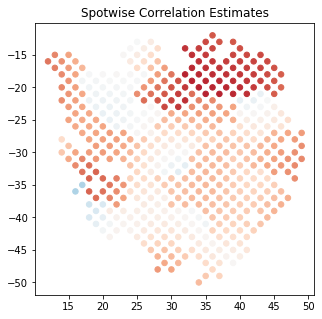

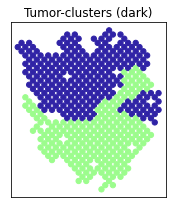

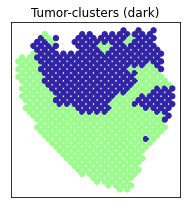

In [64]:
# Filter spots
corrs, kept_inds_fig, _ = spatialcorr.plot.plot_correlation(
    adata,
    'KRT17', 'KRT6C',
    sigma=5,
    contrib_thresh=10,
    kernel_matrix=None,
    row_key='row',
    col_key='col',
    condition='BayesSpace',
    cmap='RdBu_r',
    colorbar=False,
    ticks=True,
    #ax=ax,
    #figure=None,
    estimate='local',
    dsize=30,
    title='Spotwise Correlation Estimates'
);

fig, ax = plt.subplots(1,1, figsize=(2.5, 3))
spatialcorr.plot_slide(
    adata.obs.iloc[kept_inds_fig], 
    [x in set([6, 7, 9, 10]) for x in adata.obs.iloc[kept_inds_fig]['BayesSpace']], 
    cmap='categorical', 
    title="Tumor-clusters (dark)",
    dsize=28,
    ticks=False,
    figure=fig,
    ax=ax,
    cat_palette=['#9cfc8d', '#3023a6']
)

plt.tight_layout()
fig.savefig('./figures/P10_tumor_region_filt.pdf', format='pdf')

fig, ax = plt.subplots(1,1, figsize=(2.7, 3))
spatialcorr.plot_slide(
    adata.obs, 
    [x in set([6, 7, 9, 10]) for x in adata.obs['BayesSpace']], 
    cmap='categorical', 
    title="Tumor-clusters (dark)",
    dsize=28,
    ticks=False,
    figure=fig,
    ax=ax,
    cat_palette=['#9cfc8d', '#3023a6']
)

plt.tight_layout()
fig.savefig('./figures/P10_tumor_region.pdf', format='pdf')

Kept 476/620 spots.


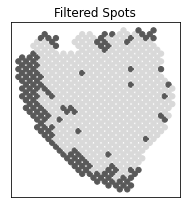

In [50]:
fig, ax = plt.subplots(1,1, figsize=(2.7, 3))
kernel_matrix = spatialcorr.statistical_test._compute_kernel_matrix(
    adata.obs,
    sigma=5,
    y_col='row',
    x_col='col',
    condition_on_cell_type=True,
    cell_type_key='BayesSpace'
)
spatialcorr.plot.plot_filtered_spots(
    adata,
    kernel_matrix,
    contrib_thresh=10,
    row_key='row',
    col_key='col',
    ax=ax,
    figure=None,
    dsize=28,
    ticks=False,
    colorticks=None
)
plt.tight_layout()
fig.savefig('./figures/P10_filtered_spots.pdf', format='pdf')

In [11]:
def mult_genes_expression_specifcy_genes(
        genes_grid,
        adata,
        cond_key,
        sigma=5,
        contrib_thresh=10,
        estimate_type='local',
        row_key='row',
        col_key='col',
        dsize=7,
        fig_path=None,
        fig_format='png',
        fig_dpi=150
    ):

    
    fig, axarr = plt.subplots(
        len(genes_grid),
        len(genes_grid[0]),
        figsize=(1.6*len(genes_grid[0]), 2*len(genes_grid))
    )
    
    # Compute kept indices
    corrs, keep_inds = spatialcorr.utils.compute_local_correlation(
        adata,
        genes_grid[0][0], genes_grid[0][1],
        kernel_matrix=None,
        row_key=row_key,
        col_key=col_key,
        condition=cond_key,
        sigma=sigma,
        contrib_thresh=contrib_thresh
    )
    
    # Get range of expression values for colormap
    # of expression
    all_genes = set()
    for gene_row in genes_grid:
        all_genes.update(gene_row)
    all_expr = []
    for gene in all_genes:
        expr = adata[keep_inds,:].obs_vector(gene)
        all_expr += list(expr)
    min_expr = min(all_expr)
    max_expr = max(all_expr)
    print("Min expression: ", min_expr)
    print("Max expression: ", max_expr)

    
    for ax_row, genes in zip(axarr, genes_grid):
        if len(genes) < len(ax_row):
            for ax in ax_row[len(genes):]:
                ax.set_visible(False)
        for g_i, gene in enumerate(genes):
            ax = ax_row[g_i]
            spatialcorr.plot_slide(
                adata[keep_inds,:].obs,
                adata[keep_inds,:].obs_vector(gene),
                cmap='turbo',
                title=gene,
                dsize=dsize,
                ax=ax,
                figure=fig,
                ticks=False,
                vmin=min_expr,
                vmax=max_expr
            )

    if fig_path:
        plt.tight_layout()
        fig.savefig(
            fig_path,
            format=fig_format,
            dpi=fig_dpi
        )
        plt.show()

    

Min expression:  0.506
Max expression:  77.343


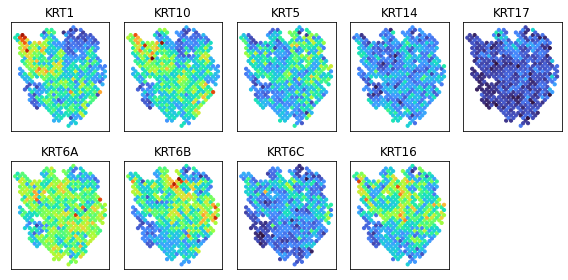

In [14]:
mult_genes_expression_specifcy_genes(
    [
        #["KRT1", "KRT10", "KRT5"],
        #["KRT14", "KRT6A", "KRT6B"],
        #["KRT6C", "KRT16", "KRT17"]
        
        ["KRT1", "KRT10", "KRT5", "KRT14", "KRT17"], 
        ["KRT6A", "KRT6B", "KRT6C", "KRT16"], 
    ],
    adata,
    'BayesSpace',
    dsize=10,
    fig_path='./figures/P10_keratin_expression_heatmaps.pdf',
    fig_format='pdf'
)

In [32]:
np.quantile(
    np.array(sorted(set(adata.X.flatten()))), 
    0.004
)

0.07540400078892708

In [15]:
def mult_genes_plot_correlation_specify_pairs(
        pair_grid,
        adata,
        cond_key,
        sigma=5,
        contrib_thresh=10,
        estimate_type='local',
        row_key='row',
        col_key='col',
        dsize=7,
        fig_path=None,
        fig_format='png',
        fig_dpi=150
    ):

    fig, axarr = plt.subplots(
        len(pair_grid),
        len(pair_grid[0]),
        figsize=(1.6*len(pair_grid[0]), 2*len(pair_grid))
    )
    
    # Compute kept indices
    corrs, keep_inds = spatialcorr.utils.compute_local_correlation(
        adata,
        pair_grid[0][0][0], pair_grid[0][0][1],
        kernel_matrix=None,
        row_key=row_key,
        col_key=col_key,
        condition=cond_key,
        sigma=sigma,
        contrib_thresh=contrib_thresh
    )

    
    for ax_row, pairs in zip(axarr, pair_grid):
        if len(pairs) < len(ax_row):
            for ax in ax_row[len(pairs):]:
                ax.set_visible(False)
        for p_i, pair in enumerate(pairs):
            ax = ax_row[p_i]
            gene_1 = pair[0]
            gene_2 = pair[1]
            if estimate_type in ['local', 'regional']:
                corrs, kept_inds, _ = spatialcorr.plot.plot_correlation(
                    adata[keep_inds,:],
                    gene_1, gene_2,
                    sigma=sigma,
                    contrib_thresh=contrib_thresh,
                    kernel_matrix=None,
                    row_key=row_key,
                    col_key=col_key,
                    condition=cond_key,
                    cmap='RdBu_r',
                    colorbar=False,
                    ticks=False,
                    ax=ax,
                    figure=None,
                    estimate=estimate_type,
                    dsize=dsize,
                    title=f'{gene_1}, {gene_2}'
                )
            elif estimate_type == 'local_ci':
                spatialcorr.plot.plot_ci_overlap(
                    gene_1,
                    gene_2,
                    adata,
                    cond_key,
                    kernel_matrix=None,
                    bandwidth=sigma,
                    row_key=row_key,
                    col_key=col_key,
                    title=f'{gene_1}, {gene_2}',
                    ax=ax,
                    figure=None,
                    ticks=False,
                    dsize=dsize,
                    colorticks=None,
                    neigh_thresh=contrib_thresh
                )
    if fig_path:
        plt.tight_layout()
        fig.savefig(
            fig_path,
            format=fig_format,
            dpi=fig_dpi
        )
        plt.show()

    

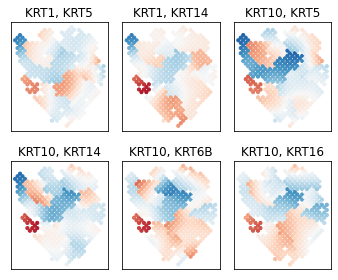

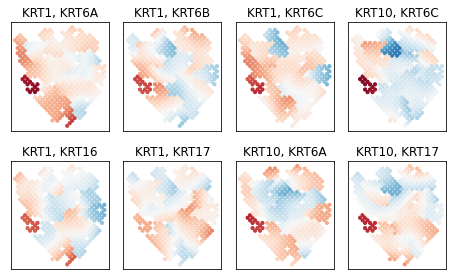

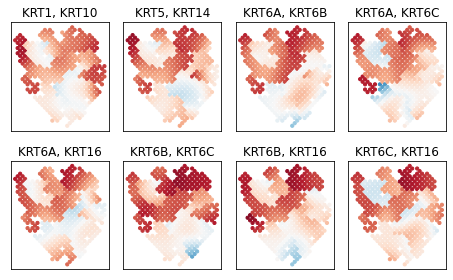

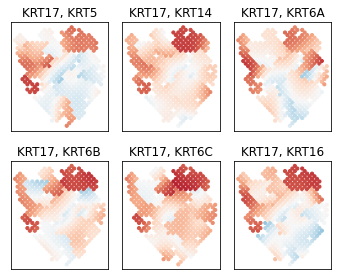

In [52]:
mult_genes_plot_correlation_specify_pairs(
    [
        [["KRT1", "KRT5"], ["KRT1", "KRT14"], ["KRT10", "KRT5"]],
        [["KRT10", "KRT14"], ["KRT10", "KRT6B"], ["KRT10", "KRT16"]]  
    ],
    adata,
    'BayesSpace_11',
    dsize=10,
    estimate_type='local',
    fig_path='./figures_V2/P10_keratin_corr_heatmaps_Clust1.pdf',
    fig_format='pdf'
)

mult_genes_plot_correlation_specify_pairs(
    [
        [["KRT1", "KRT6A"], ["KRT1", "KRT6B"], ["KRT1", "KRT6C"], ["KRT10", "KRT6C"]],
        [["KRT1", "KRT16"], ["KRT1", "KRT17"], ["KRT10", "KRT6A"], ["KRT10", "KRT17"]]
        
    ],
    adata,
    'BayesSpace_11',
    dsize=10,
    estimate_type='local',
    fig_path='./figures_V2/P10_keratin_corr_heatmaps_Clust2.pdf',
    fig_format='pdf'
)

mult_genes_plot_correlation_specify_pairs(
    [
        [["KRT1", "KRT10"], ["KRT5", "KRT14"], ["KRT6A", "KRT6B"], ["KRT6A", "KRT6C"]],
        [["KRT6A", "KRT16"], ["KRT6B", "KRT6C"], ["KRT6B", "KRT16"], ["KRT6C", "KRT16"]]
        
    ],
    adata,
    'BayesSpace_11',
    dsize=10,
    estimate_type='local',
    fig_path='./figures_V2/P10_keratin_corr_heatmaps_Clust3.pdf',
    fig_format='pdf'
)

mult_genes_plot_correlation_specify_pairs(
    [
        [["KRT17", "KRT5"], ["KRT17", "KRT14"], ["KRT17", "KRT6A"]],
        [["KRT17", "KRT6B"], ["KRT17", "KRT6C"], ["KRT17", "KRT16"]]
        
    ],
    adata,
    'BayesSpace_11',
    dsize=10,
    estimate_type='local',
    fig_path='./figures_V2/P10_keratin_corr_heatmaps_Clust4.pdf',
    fig_format='pdf'
)

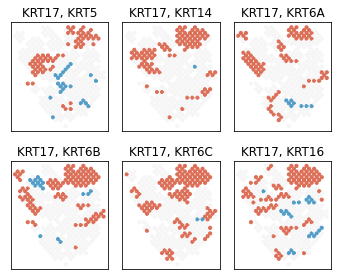

In [16]:
mult_genes_plot_correlation_specify_pairs(
    [
        [["KRT17", "KRT5"], ["KRT17", "KRT14"], ["KRT17", "KRT6A"]],
        [["KRT17", "KRT6B"], ["KRT17", "KRT6C"], ["KRT17", "KRT16"]]
        
    ],
    adata,
    'BayesSpace',
    dsize=10,
    estimate_type='local_ci',
    fig_path='./figures/P10_keratin_corr_conf_interval_heatmaps_Clust4.pdf',
    fig_format='pdf'
)

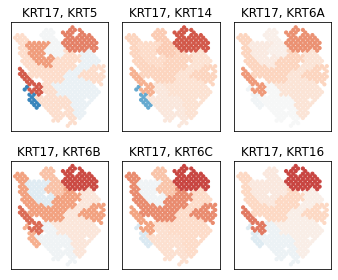

In [17]:
mult_genes_plot_correlation_specify_pairs(
    [
        [["KRT17", "KRT5"], ["KRT17", "KRT14"], ["KRT17", "KRT6A"]],
        [["KRT17", "KRT6B"], ["KRT17", "KRT6C"], ["KRT17", "KRT16"]]
        
    ],
    adata,
    'BayesSpace',
    dsize=10,
    estimate_type='regional',
    fig_path='./figures/P10_keratin_corr_regional_heatmaps_Clust4.pdf',
    fig_format='pdf'
)

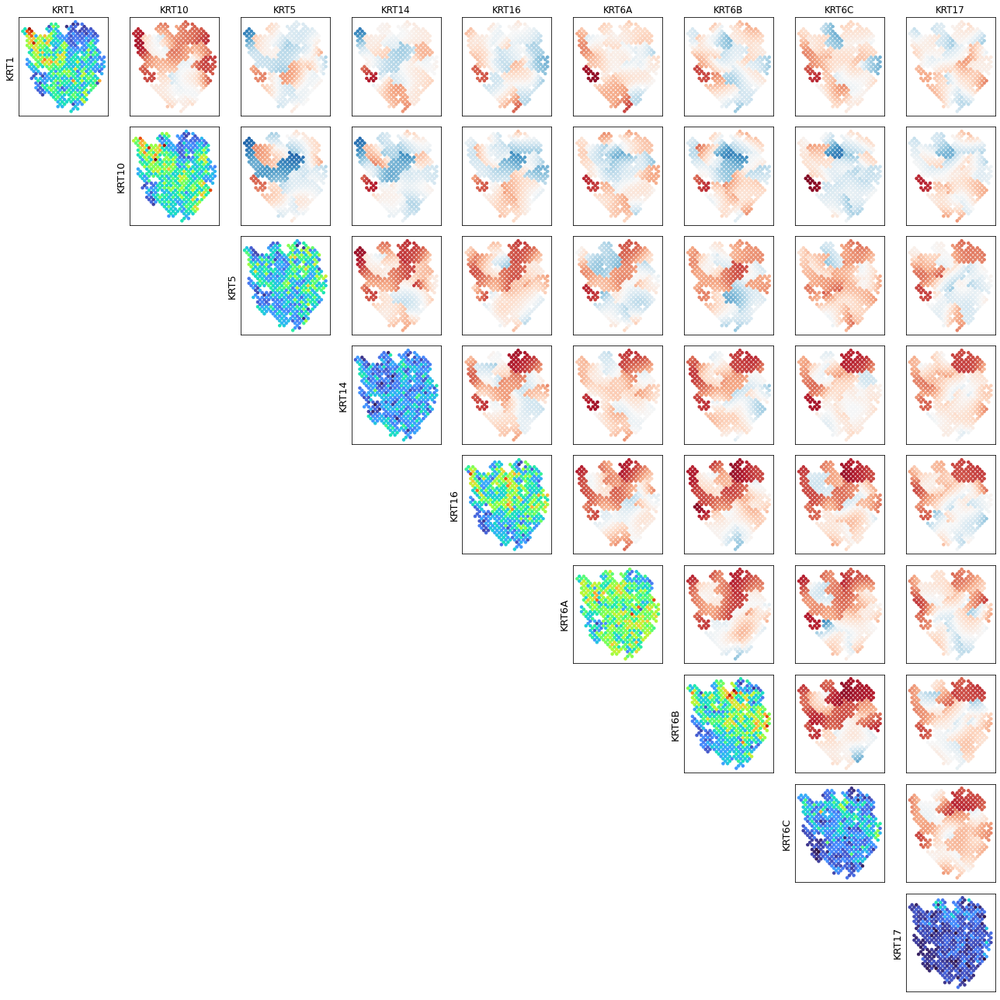

In [13]:
spatialcorr.plot.mult_genes_plot_correlation(
    [
        "KRT1",
        "KRT10",
        "KRT5",
        "KRT14",
        "KRT16",
        "KRT6A",
        "KRT6B",
        "KRT6C",
        "KRT17"
    ],
    adata,
    'BayesSpace_11',
    dsize=12,
    estimate_type='local',
    fig_path='./figures_V2/P10_keratin_corr_heatmaps.pdf',
    fig_format='pdf'
)

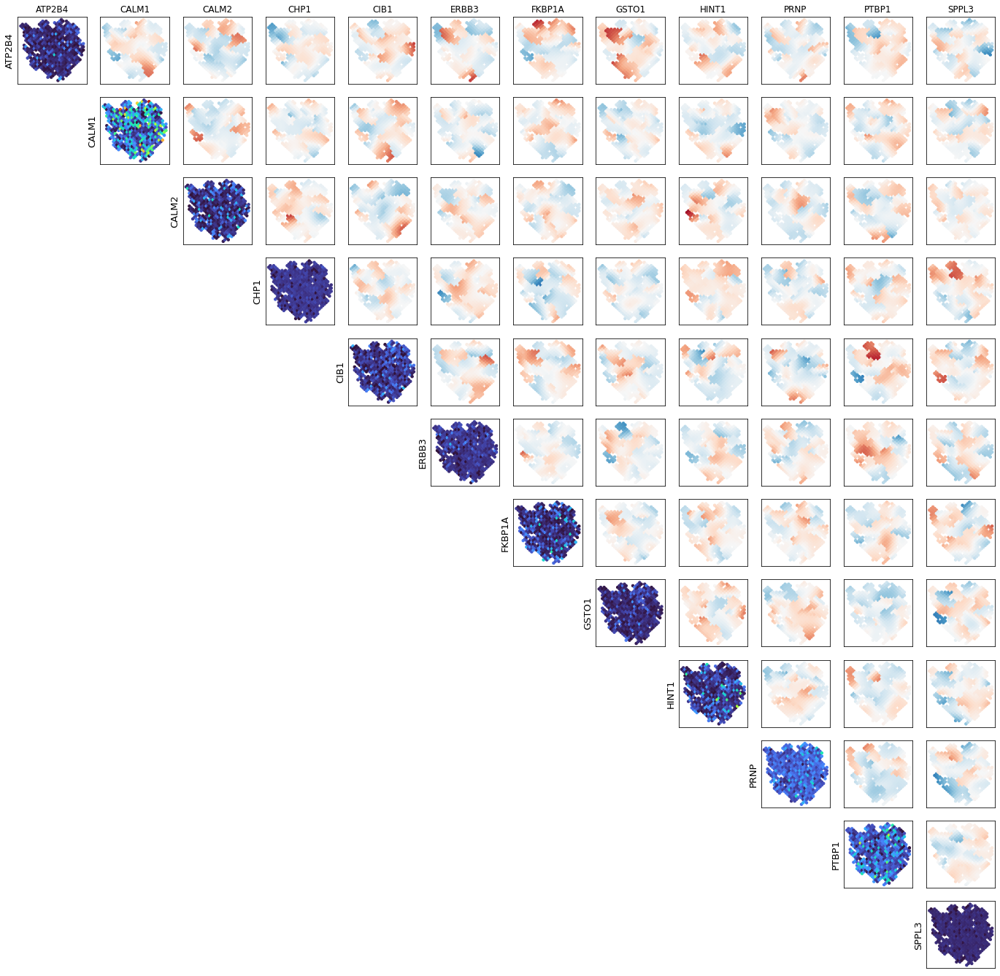

In [17]:
spatialcorr.plot.mult_genes_plot_correlation(
    [
        "ATP2B4",
        "CALM1",
        "CALM2",
        "CHP1",
        "CIB1",
        "ERBB3",
        "FKBP1A",
        "GSTO1",
        "HINT1",
        "PRNP",
        "PTBP1",
        "SPPL3"
    ],
    adata,
    'BayesSpace_11',
    dsize=12,
    estimate_type='local'
    #fig_path='./figures_V2/P10_keratin_corr_heatmaps.pdf',
    #fig_format='pdf'
)

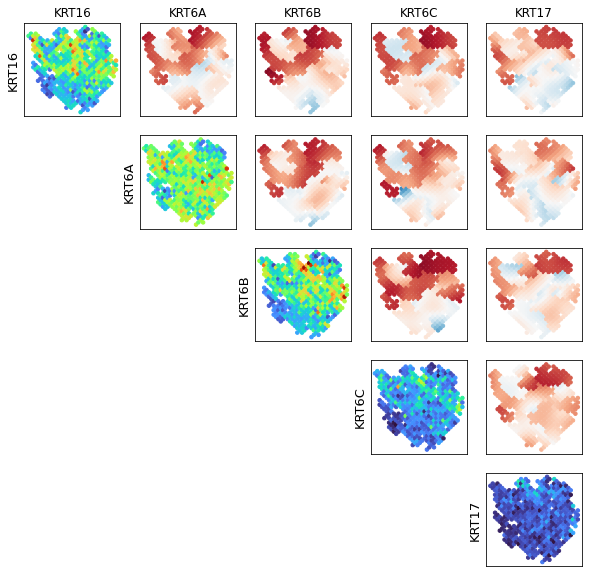

In [21]:
spatialcorr.plot.mult_genes_plot_correlation(
    [
        "KRT16",
        "KRT6A",
        "KRT6B",
        "KRT6C",
        "KRT17"
    ],
    adata,
    'BayesSpace_11',
    dsize=12,
    estimate_type='local'
    #fig_path='./figures_V2/P10_keratin_corr_heatmaps.pdf',
    #fig_format='pdf'
)

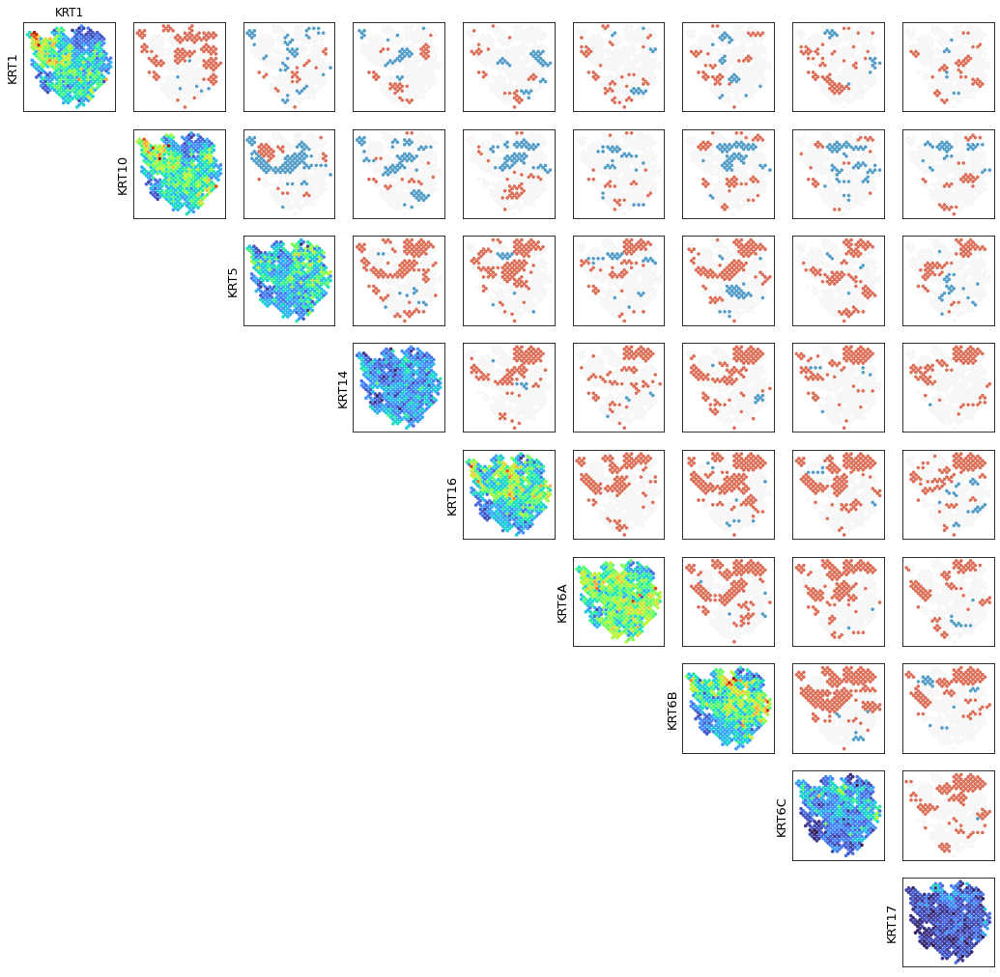

In [15]:
spatialcorr.plot.mult_genes_plot_correlation(
    [
        "KRT1",
        "KRT10",
        "KRT5",
        "KRT14",
        "KRT16",
        "KRT6A",
        "KRT6B",
        "KRT6C",
        "KRT17"
    ],
    adata,
    'BayesSpace_11',
    estimate_type='local_ci'
)

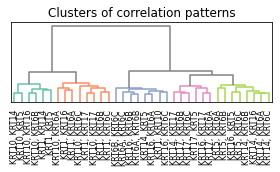

<Figure size 432x288 with 0 Axes>

In [12]:
spatialcorr.plot.cluster_pairwise_correlations(
    [
        "KRT1",
        "KRT10",
        "KRT14",
        "KRT16",
        "KRT17",
        "KRT5",
        "KRT6A",
        "KRT6B",
        "KRT6C"
    ],
    adata,
    'BayesSpace',
    color_thresh=10,
    remove_y_ticks=True,
    title='Clusters of correlation patterns',
    fig_size=(4,2.5),
    fig_path='./figures/P10_keratin_pairwise_cluster.pdf',
    fig_format='pdf'
)
    

Trying to set attribute `.X` of view, copying.


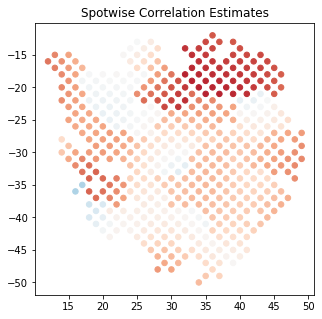

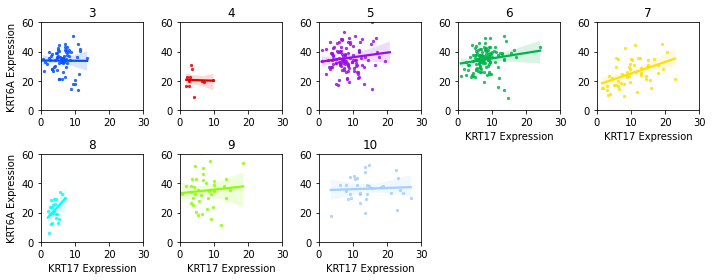

Trying to set attribute `.X` of view, copying.


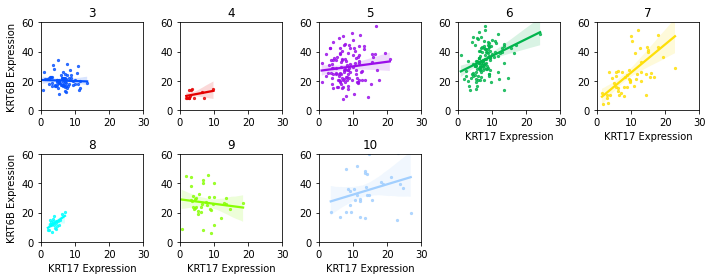

Trying to set attribute `.X` of view, copying.


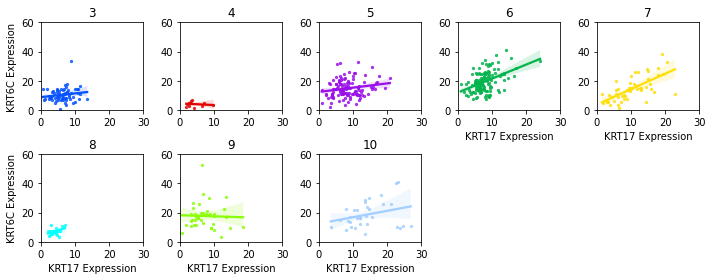

Trying to set attribute `.X` of view, copying.


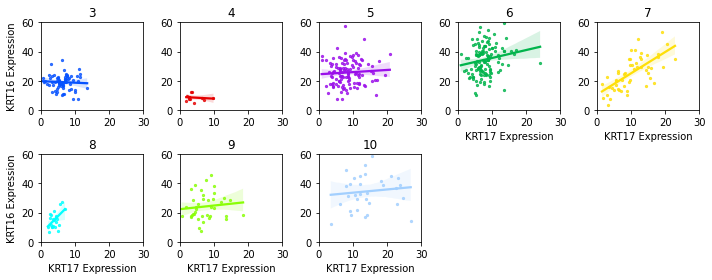

In [11]:
corrs, kept_inds_fig, _ = spatialcorr.plot.plot_correlation(
    adata,
    'KRT17', 'KRT6C',
    sigma=5,
    contrib_thresh=10,
    kernel_matrix=None,
    row_key='row',
    col_key='col',
    condition='BayesSpace',
    cmap='RdBu_r',
    colorbar=False,
    ticks=True,
    #ax=ax,
    #figure=None,
    estimate='local',
    dsize=30,
    title='Spotwise Correlation Estimates'
);
spatialcorr.plot.cluster_pairwise_scatterplots(
    'KRT17',
    'KRT6A',
    adata[kept_inds_fig,:],
    'BayesSpace',
    sigma=5,
    row_key='row',
    col_key='col',
    xlim=(0,30),
    ylim=(0,60),
    fig_path='./figures/P10_KRT17_KRT6A_region_scatters.pdf',
    fig_format='pdf',
    fig_dpi=150
)
spatialcorr.plot.cluster_pairwise_scatterplots(
    'KRT17',
    'KRT6B',
    adata[kept_inds_fig,:],
    'BayesSpace',
    sigma=5,
    row_key='row',
    col_key='col',
    xlim=(0,30),
    ylim=(0,60),
    fig_path='./figures/P10_KRT17_KRT6B_region_scatters.pdf',
    fig_format='pdf',
    fig_dpi=150
)
spatialcorr.plot.cluster_pairwise_scatterplots(
    'KRT17',
    'KRT6C',
    adata[kept_inds_fig,:],
    'BayesSpace',
    sigma=5,
    row_key='row',
    col_key='col',
    xlim=(0,30),
    ylim=(0,60),
    fig_path='./figures/P10_KRT17_KRT6C_region_scatters.pdf',
    fig_format='pdf',
    fig_dpi=150
)
spatialcorr.plot.cluster_pairwise_scatterplots(
    'KRT17',
    'KRT16',
    adata[kept_inds_fig,:],
    'BayesSpace',
    sigma=5,
    row_key='row',
    col_key='col',
    xlim=(0,30),
    ylim=(0,60),
    fig_path='./figures/P10_KRT17_KRT16_region_scatters.pdf',
    fig_format='pdf',
    fig_dpi=150
)

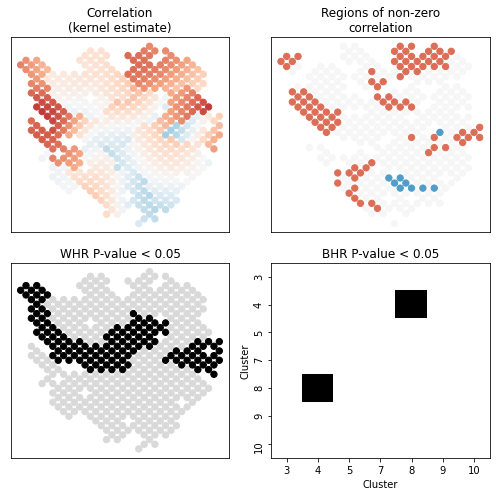

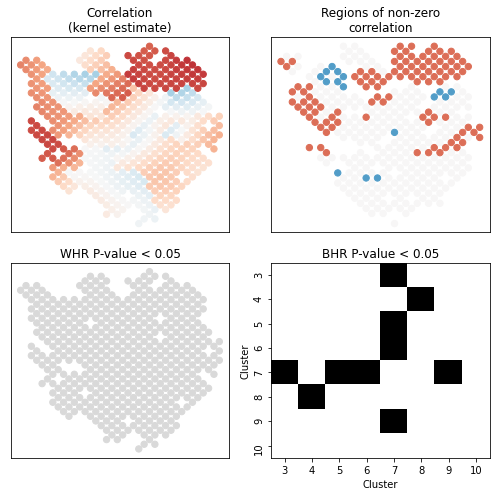

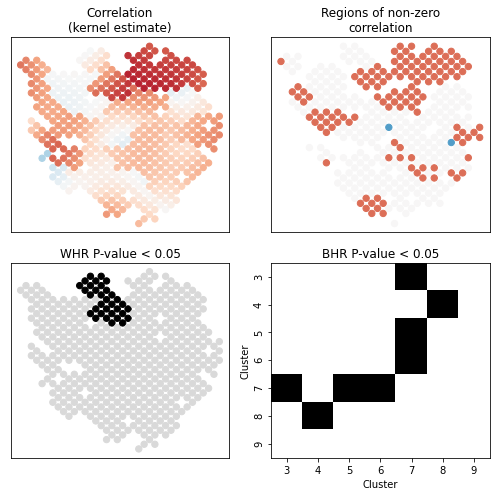

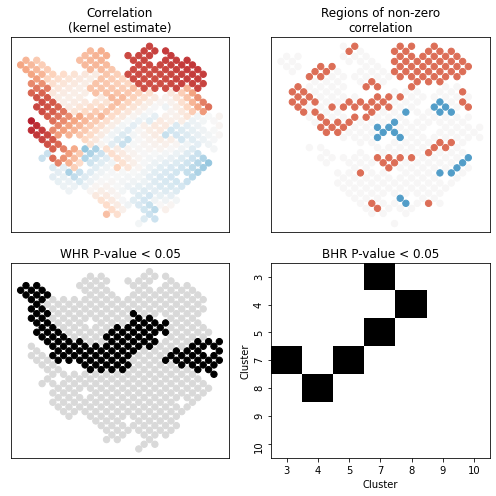

In [11]:
spatialcorr.analysis_pipeline_pair(
    'KRT17', 'KRT6A',  
    adata,
    5,
    'BayesSpace',                
    max_perms=1000,
    dsize=40,
    verbose=0,
    only_stats=True,
    fig_path='./figures/P10_KRT17_KRT6A_pairwise_analysis.pdf',
    fig_format='pdf'
)
spatialcorr.analysis_pipeline_pair(
    'KRT17', 'KRT6B',  
    adata,
    5,
    'BayesSpace',                
    max_perms=1000,
    dsize=40,
    verbose=0,
    only_stats=True,
    fig_path='./figures/P10_KRT17_KRT6B_pairwise_analysis.pdf',
    fig_format='pdf'
)
spatialcorr.analysis_pipeline_pair(
    'KRT17', 'KRT6C',  
    adata,
    5,
    'BayesSpace',                
    max_perms=1000,
    dsize=40,
    verbose=0,
    only_stats=True,
    fig_path='./figures/P10_KRT17_KRT6C_pairwise_analysis.pdf',
    fig_format='pdf'
)
spatialcorr.analysis_pipeline_pair(
    'KRT17', 'KRT16',  
    adata,
    5,
    'BayesSpace',                
    max_perms=1000,
    dsize=40,
    verbose=0,
    only_stats=True,
    fig_path='./figures/P10_KRT17_KRT16_pairwise_analysis.pdf',
    fig_format='pdf'
)

Kept 476/620 spots.


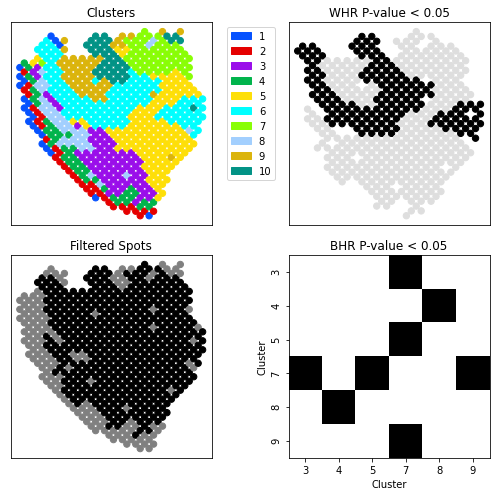

In [13]:
spatialcorr.analysis_pipeline_set(
    ['KRT17', 'KRT16', 'KRT6A', 'KRT6B', 'KRT6C'],  
    adata,                    
    'BayesSpace_11',                
    max_perms=500,
    dsize=40,
    verbose=0
)

Kept 476/620 spots.


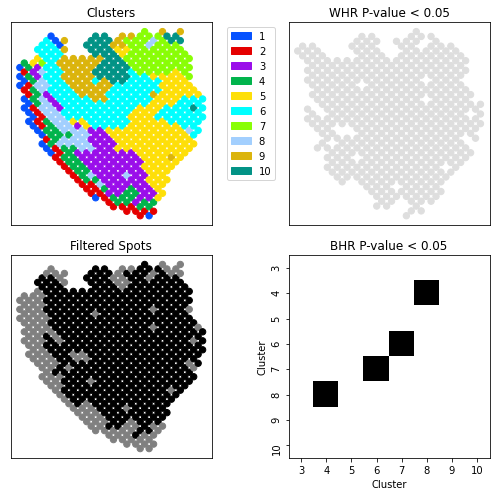

In [12]:
spatialcorr.analysis_pipeline_set(
    ['KRT17', 'KRT6A'],  
    adata,                    
    'BayesSpace_11',                
    max_perms=100,
    dsize=40,
    verbose=0
)

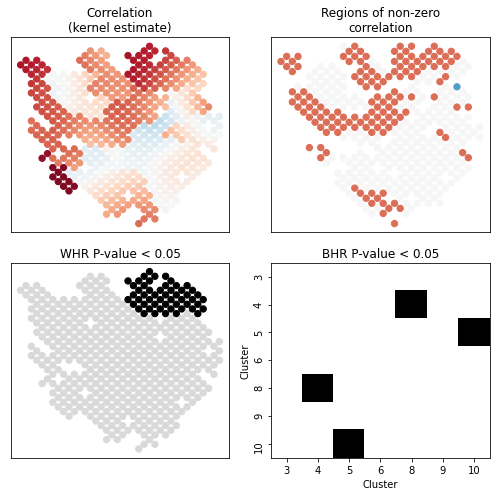

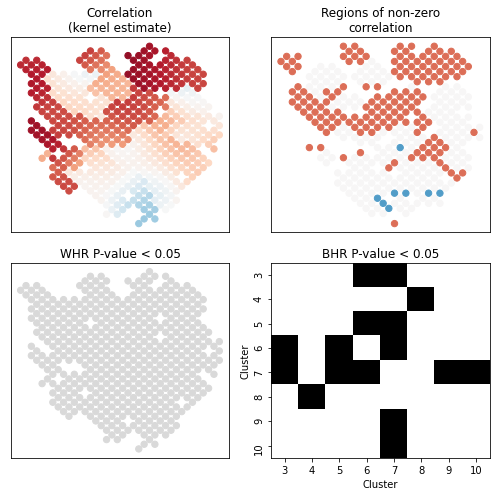

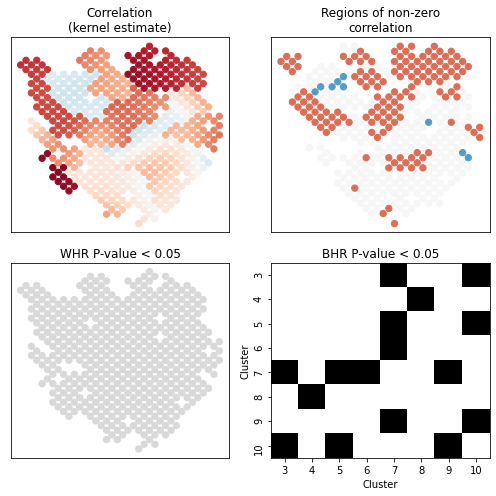

In [18]:
spatialcorr.analysis_pipeline_pair(
    'KRT16', 'KRT6A',  
    adata,
    5,
    'BayesSpace_11',                
    max_perms=1000,
    dsize=40,
    verbose=0,
    only_stats=True,
    fig_path='./figures_V2/P10_KRT16_KRT6A_pairwise_analysis.pdf',
    fig_format='pdf'
)
spatialcorr.analysis_pipeline_pair(
    'KRT16', 'KRT6B',  
    adata,
    5,
    'BayesSpace_11',                
    max_perms=1000,
    dsize=40,
    verbose=0,
    only_stats=True,
    fig_path='./figures_V2/P10_KRT16_KRT6B_pairwise_analysis.pdf',
    fig_format='pdf'
)
spatialcorr.analysis_pipeline_pair(
    'KRT16', 'KRT6C',  
    adata,
    5,
    'BayesSpace_11',                
    max_perms=1000,
    dsize=40,
    verbose=0,
    only_stats=True,
    fig_path='./figures_V2/P10_KRT16_KRT6C_pairwise_analysis.pdf',
    fig_format='pdf'
)

Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attrib

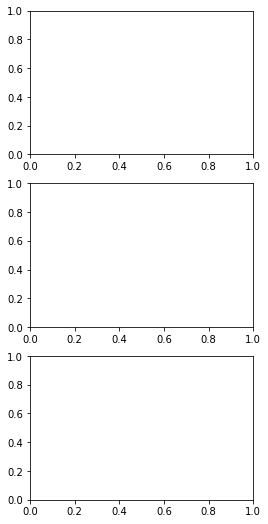

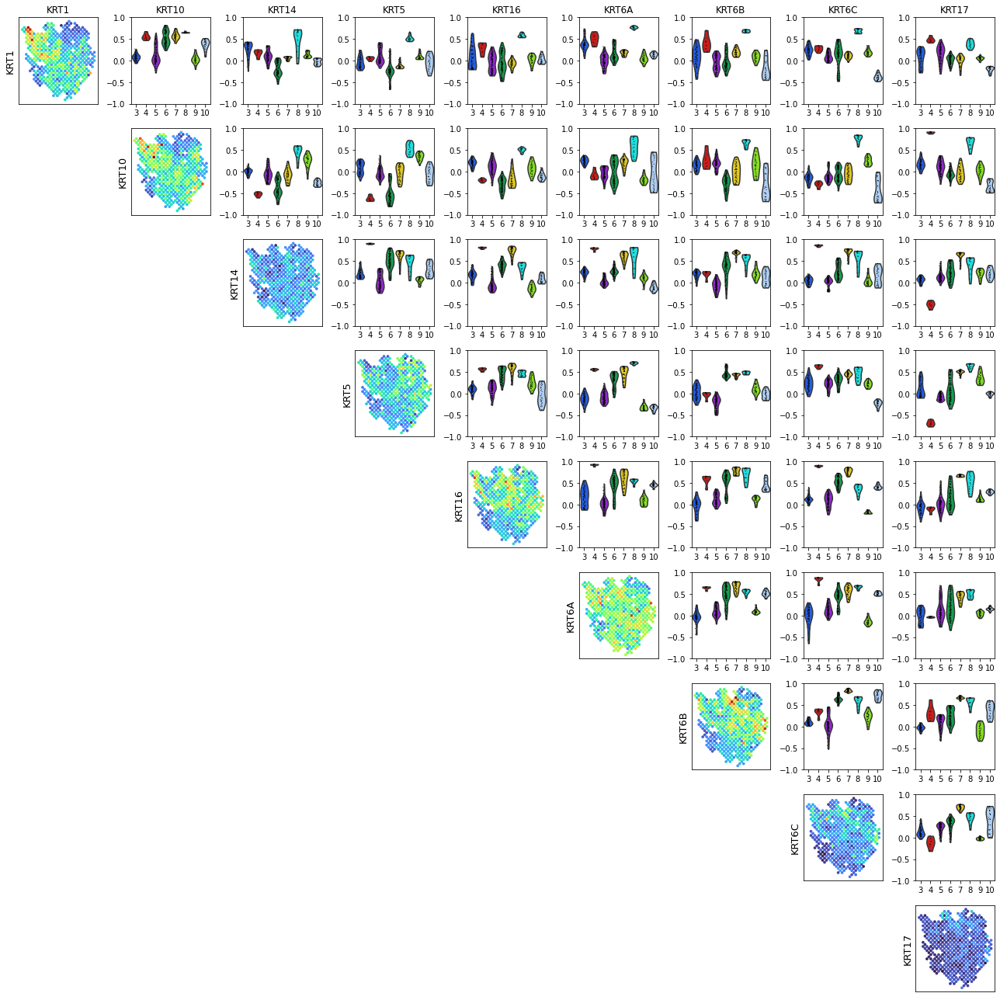

In [25]:

def draw_violin_corrs(g1, g2, ax, ylabel='', title=''):
    cust_pal = np.array(spatialcorr.plot.PALETTE_MANY)[
        [0, 1, 2, 3, 4, 5, 6, 7, 8, 9]
    ]
    
    adata_keep = adata.copy()
    corrs, keep_inds = spatialcorr.utils.compute_local_correlation(
        adata, 
        g1, g2,
        kernel_matrix=None, 
        row_key='row', 
        col_key='col', 
        condition='BayesSpace', 
        sigma=5,
        contrib_thresh=10
    )
    adata_keep = adata_keep[keep_inds,:]
    adata_keep.obs[f'Correlation {g1} & {g2}'] = corrs

    
    sc.pl.violin(
        adata_keep, 
        f'Correlation {g1} & {g2}', 
        groupby='BayesSpace', 
        palette=cust_pal, 
        ax=ax, 
        show=False
    )
    ax.set_ylim((-1,1))

    if ylabel is not None:
        ax.set_ylabel(ylabel)
    if title is not None:
        ax.set_title(title)
    ax.set_xlabel('')


def plot_pairwise_violins(
        plot_genes,
        cond_key,
        bandwidth=5,
        precomputed_kernel=None,
        contrib_thresh=10,
        estimate_type='local',
        row_key='row',
        col_key='col',
        dsize=7,
        fig_path=None,
        fig_format='png',
        fig_dpi=150
    ):
    condition = cond_key is not None
    kernel_matrix = spatialcorr.statistical_test._compute_kernel_matrix(
        adata.obs,
        sigma=bandwidth,
        cell_type_key=cond_key,
        condition_on_cell_type=condition,
        y_col=row_key,
        x_col=col_key
    )
    
    # Compute kept indices
    corrs, keep_inds = spatialcorr.utils.compute_local_correlation(
        adata,
        plot_genes[0], plot_genes[1],
        kernel_matrix=kernel_matrix,
        row_key=row_key,
        col_key=col_key,
        condition=cond_key,
        sigma=bandwidth,
        contrib_thresh=contrib_thresh
    )

    # Filter kernel matrix, if it's provided
    kernel_matrix = kernel_matrix[keep_inds,:]
    kernel_matrix = kernel_matrix[:,keep_inds]

    
    # Get range of expression values for colormap
    # of expression
    all_expr = []
    for gene in plot_genes:
        expr = adata[keep_inds,:].obs_vector(gene)
        all_expr += list(expr)
    min_expr = min(all_expr)
    max_expr = max(all_expr)
    
    fig, axarr = plt.subplots(
        len(plot_genes),
        len(plot_genes),
        figsize=(2*len(plot_genes),2*len(plot_genes))
    )

    for row, ax_row in enumerate(axarr):
        for col, ax in enumerate(ax_row):
            gene_1 = plot_genes[row]
            gene_2 = plot_genes[col]

            if row == 0:
                title = gene_2
            else:
                title = None

            if col == row:
                spatialcorr.plot.plot_slide(
                    adata[keep_inds,:].obs,
                    adata[keep_inds,:].obs_vector(gene_1),
                    cmap='turbo',
                    title=title,
                    dsize=dsize,
                    ax=ax,
                    figure=fig,
                    ticks=False,
                    vmin=min_expr,
                    vmax=max_expr,
                    row_key=row_key,
                    col_key=col_key
                )
                ax.set_ylabel(gene_1, fontsize=13)
            elif col > row:
                ylabel=''
                if col == 0:
                    ylabel = gene_1
                title = ''
                if row == 0:
                    title = gene_2
                draw_violin_corrs(gene_1, gene_2, ax, ylabel=ylabel, title=title)
            else:
                ax.set_visible(False)

    plt.tight_layout()
    fig.savefig('./figures/P10_pairwise_corr_distr_violin_matrix.pdf', bbox_layout='tight', format='pdf')
    fig.savefig('./figures/P10_pairwise_corr_distr_violin_matrix.png', bbox_layout='tight', format='png', dpi=150)
    
plot_genes = ['KRT1', 'KRT10', 'KRT14', 'KRT5', 'KRT16', 'KRT6A', 'KRT6B', 'KRT6C', 'KRT17']
plot_pairwise_violins(plot_genes, cond_key='BayesSpace')

Kept 476/620 spots.


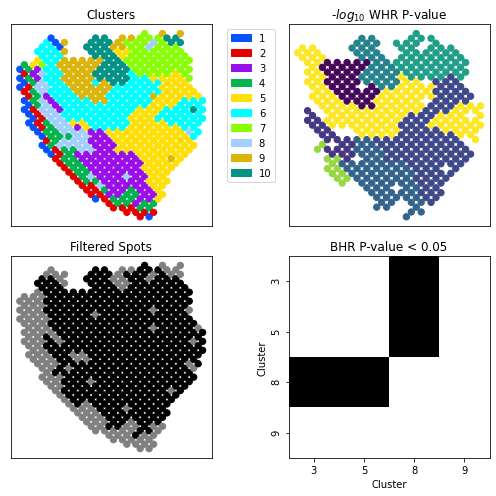

In [13]:
spatialcorr.analysis_pipeline_set(
    [
        "KRT1",
        "KRT10",
        "KRT14",
        "KRT16",
        "KRT17",
        "KRT5",
        "KRT6A",
        "KRT6B",
        "KRT6C"
    
    ],  
    adata,                    
    'BayesSpace_11',                
    max_perms=1000,            
    dsize=40,                 
    verbose=0                 
)

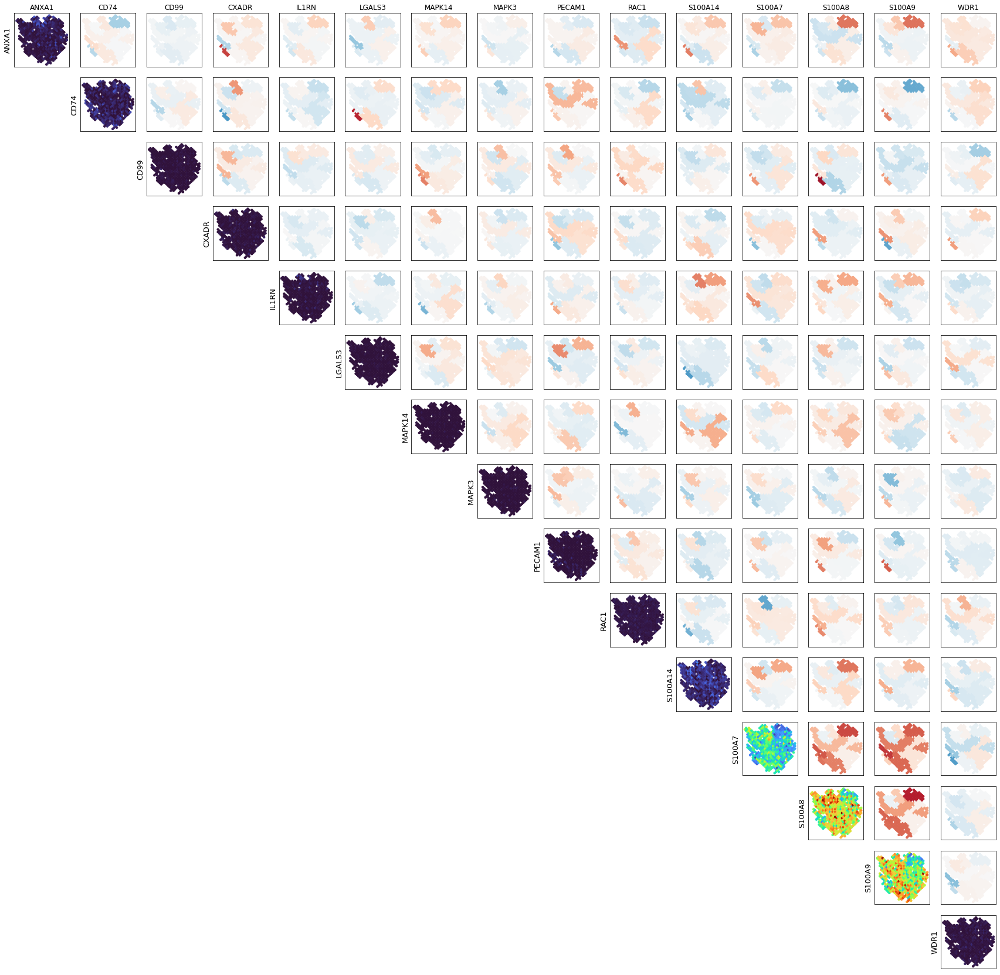

In [30]:
spatialcorr.plot.mult_genes_plot_correlation(
    [
        "ANXA1",
        "CD74",
        "CD99",
        "CXADR",
        "IL1RN",
        "LGALS3",
        "MAPK14",
        "MAPK3",
        "PECAM1",
        "RAC1",
        "S100A14",
        "S100A7",
        "S100A8",
        "S100A9",
        "WDR1"
    ],
    adata,
    'BayesSpace_11',
    dsize=12,
    estimate_type='regional'
    #fig_path='./figures_V2/P10_keratin_corr_heatmaps.pdf',
    #fig_format='pdf'
)


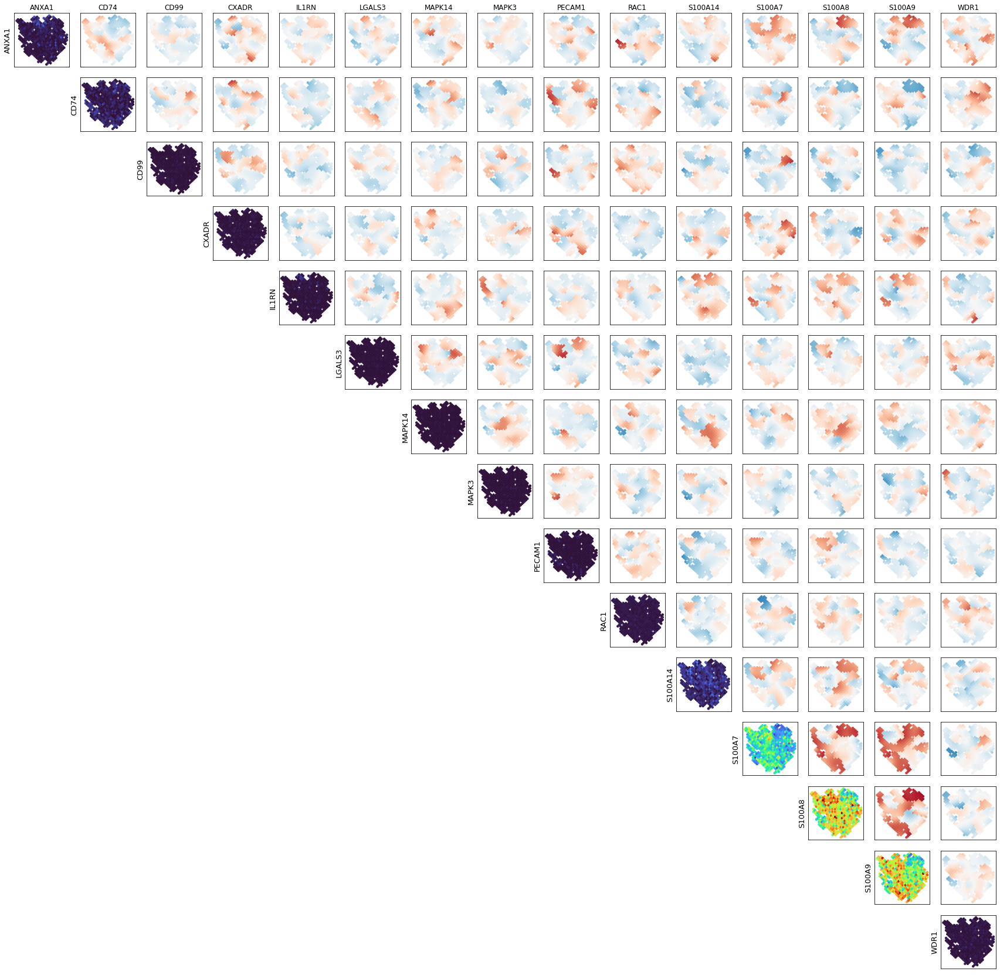

In [31]:
spatialcorr.plot.mult_genes_plot_correlation(
    [
        "ANXA1",
        "CD74",
        "CD99",
        "CXADR",
        "IL1RN",
        "LGALS3",
        "MAPK14",
        "MAPK3",
        "PECAM1",
        "RAC1",
        "S100A14",
        "S100A7",
        "S100A8",
        "S100A9",
        "WDR1"
    ],
    adata,
    'BayesSpace_11',
    dsize=12,
    estimate_type='local'
    #fig_path='./figures_V2/P10_keratin_corr_heatmaps.pdf',
    #fig_format='pdf'
)

In [ ]:
spatialcorr.plot.mult_genes_plot_correlation(
    [
        "ANXA1",
        "CD74",
        "CD99",
        "CXADR",
        "IL1RN",
        "LGALS3",
        "MAPK14",
        "MAPK3",
        "PECAM1",
        "RAC1",
        "S100A14",
        "S100A7",
        "S100A8",
        "S100A9",
        "WDR1"
    ],
    adata,
    'BayesSpace_11',
    dsize=12,
    estimate_type='regional'
    #fig_path='./figures_V2/P10_keratin_corr_heatmaps.pdf',
    #fig_format='pdf'
)



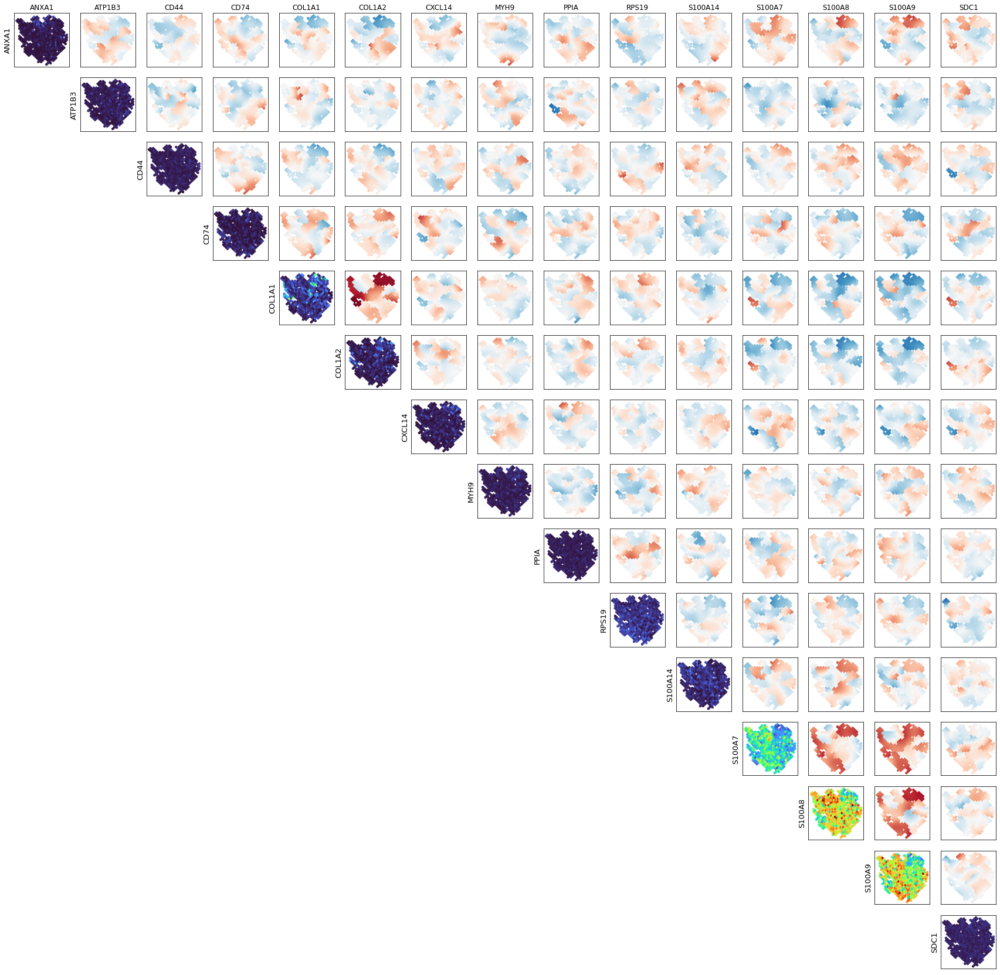

In [13]:
spatialcorr.plot.mult_genes_plot_correlation(
    [
        "ANXA1",
        "ATP1B3",
        "CD44",
        "CD74",
        "COL1A1",
        "COL1A2",
        "CXCL14",
        "MYH9",
        "PPIA",
        "RPS19",
        "S100A14",
        "S100A7",
        "S100A8",
        "S100A9",
        "SDC1"
    ],
    adata,
    'BayesSpace_11',
    dsize=12,
    estimate_type='local'
    #fig_path='./figures_V2/P10_keratin_corr_heatmaps.pdf',
    #fig_format='pdf'
)

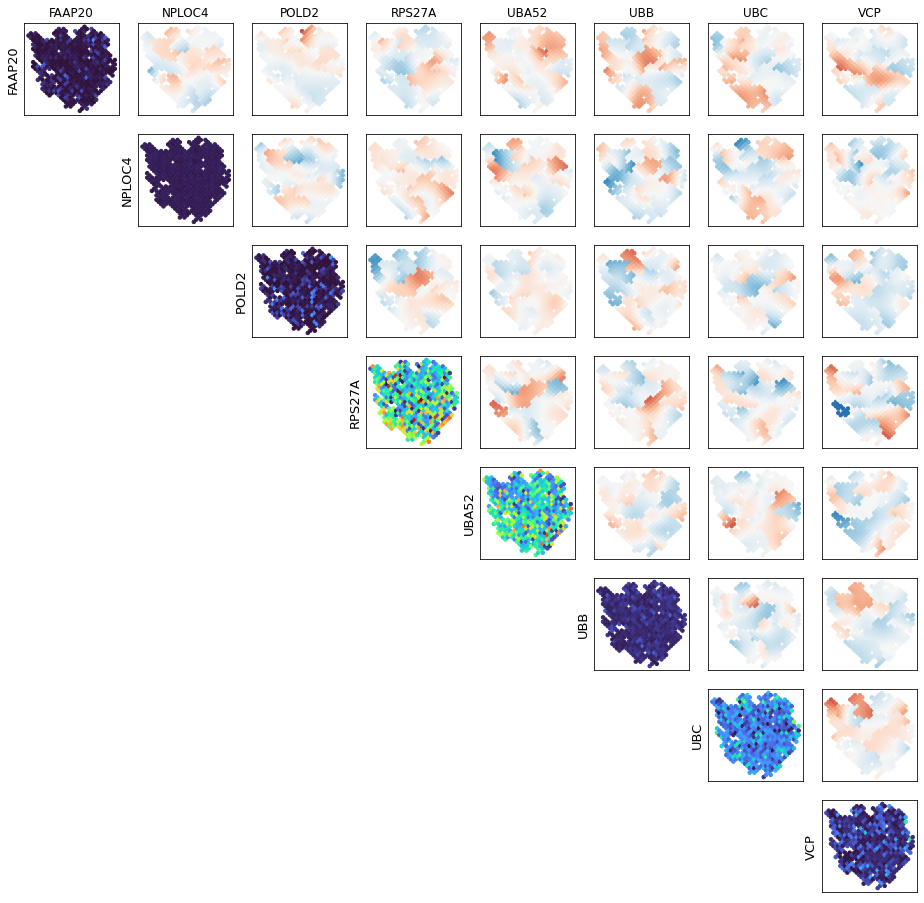

In [14]:
spatialcorr.plot.mult_genes_plot_correlation(
    [
        "FAAP20",
        "NPLOC4",
        "POLD2",
        "RPS27A",
        "UBA52",
        "UBB",
        "UBC",
        "VCP"
    ],
    adata,
    'BayesSpace_11',
    dsize=12,
    estimate_type='local'
    #fig_path='./figures_V2/P10_keratin_corr_heatmaps.pdf',
    #fig_format='pdf'
)


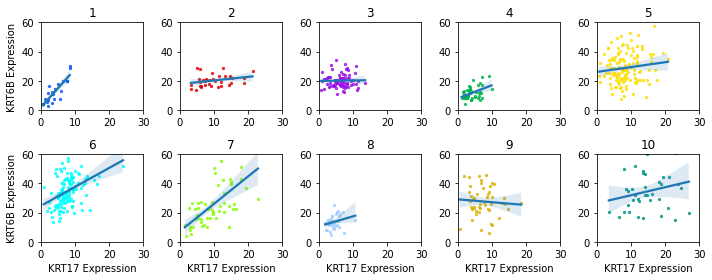

In [24]:
spatialcorr.plot.cluster_pairwise_scatterplots(
    'KRT17',
    'KRT6B',
    adata,
    'BayesSpace_11',
    sigma=5,
    row_key='row',
    col_key='col',
    xlim=(0,30),
    ylim=(0,60)
)

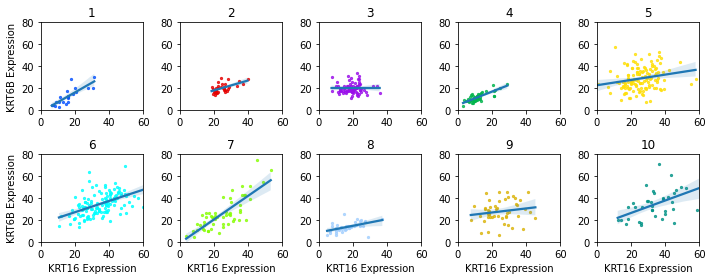

In [21]:
spatialcorr.plot.cluster_pairwise_scatterplots(
    'KRT16',
    'KRT6B',
    adata,
    'BayesSpace_11',
    sigma=5,
    row_key='row',
    col_key='col',
    xlim=(0,60),
    ylim=(0,80)
)

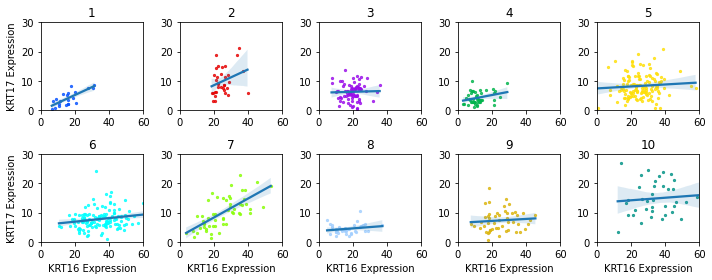

In [12]:
spatialcorr.plot.cluster_pairwise_scatterplots(
    'KRT16',
    'KRT17',
    adata,
    'BayesSpace_11',
    sigma=5,
    row_key='row',
    col_key='col',
    xlim=(0,60),
    ylim=(0,30)
)

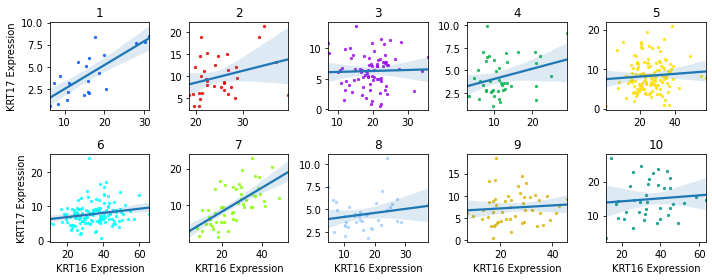

In [16]:
spatialcorr.plot.cluster_pairwise_scatterplots(
    'KRT16',
    'KRT17',
    adata,
    'BayesSpace_11',
    sigma=5,
    row_key='row',
    col_key='col'
)

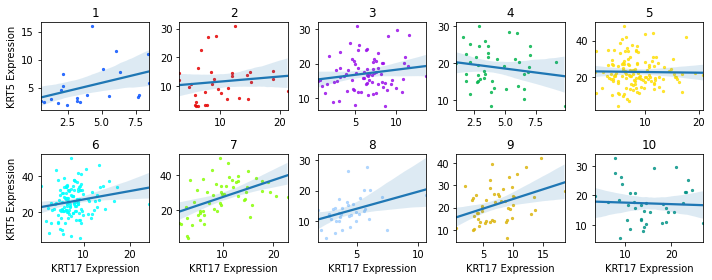

In [25]:
spatialcorr.plot.cluster_pairwise_scatterplots(
    'KRT17',
    'KRT5',
    adata,
    'BayesSpace_11',
    sigma=5,
    row_key='row',
    col_key='col'
)

In [30]:
from sklearn.mixture import GaussianMixture
from kneed import KneeLocator
import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches

def plot_gmm_fit(gmm, X, title=''):
    
    means = gmm.means_ 
    covariances = gmm.covariances_
    
    print(X.shape)
    color_iter = spatialcorr.plot.PALETTE_MANY
    fig, axarr = plt.subplots(1,2, figsize=(10,5))
    for i, (mean, covar, color) in enumerate(zip(means, covariances, color_iter)):    
        
        if covar.shape == (2,):
            covar_new = np.zeros((2,2))
            np.fill_diagonal(covar_new, covar)
            covar = covar_new
            
        v, w = np.linalg.eigh(covar)
        v = 2. * np.sqrt(2.) * np.sqrt(v)
        u = w[0] / np.linalg.norm(w[0])

        axarr[0].scatter(X[:, 0], X[:, 1], .8, color='black')
        # Plot an ellipse to show the Gaussian component
        angle = np.arctan(u[1] / u[0])
        angle = 180. * angle / np.pi  # convert to degrees
        ell = mpl.patches.Ellipse(mean, v[0], v[1], 180. + angle, color=color)
        ell.set_clip_box(axarr[0].bbox)
        ell.set_alpha(0.5)
        axarr[0].add_artist(ell)
        
        clusts = gmm.predict(X)
        axarr[1].scatter(X[:, 0], X[:, 1], .8, color=[spatialcorr.plot.PALETTE_MANY[c] for c in clusts])
    #ax.set_xticks(())
    #ax.set_yticks(())
    axarr[0].set_title(title)    
    plt.show()
    
def examine_clusters(g1, g2, adata):
    expr = np.array([adata.obs_vector(g1), adata.obs_vector(g2)])
    df = adata.obs
    
    y = -1 * np.array(df['row'])
    x = df['col']
    plt.scatter(x,y,c=expr[0], s=40)
    plt.title(g1)
    plt.show()

    y = -1 * np.array(df['row'])
    x = df['col']
    plt.scatter(x,y,c=expr[1], s=40)
    plt.title(g2)
    plt.show()
    
    n_components = np.arange(2,10)
    
    #expr = np.array([df[g1], df[g2]])
    cov_type = 'full'
    #cov_type = 'diag'
    models = [
        GaussianMixture(n, covariance_type=cov_type, init_params='kmeans').fit(
            expr.T
        )      
        for n in n_components
    ]

    bics = [m.bic(expr.T) for m in models]
    #for i in range(len(n_components))[1:]:
    #    if bics[i] > bics[i-1]:
    #        selected_bic_k = n_components[i-1]
    #        break
    
    kneedle = KneeLocator(n_components, bics, S=1.0, curve="convex", direction="decreasing")
    selected_bic_k = kneedle.knee
    #selected_bic_k = 2
    
    plt.plot(n_components, bics)
    plt.show()

    print(f'{g1} and {g2} number of BIC clusters: {selected_bic_k}')
    gmm_bic = GaussianMixture(selected_bic_k, covariance_type=cov_type, init_params='kmeans')    
    gmm_bic.fit(expr.T)
    plot_gmm_fit(gmm_bic, expr.T)

    df['gene_pair_clusters_vary_k'] = gmm_bic.predict(expr.T)
    spatialcorr.plot_slide(adata.obs, adata.obs['gene_pair_clusters_vary_k'], dsize=40, cmap='categorical')

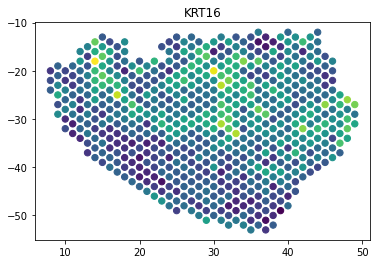

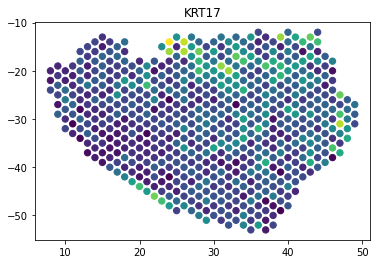

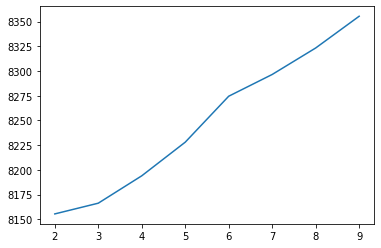

KRT16 and KRT17 number of BIC clusters: 2
(620, 2)


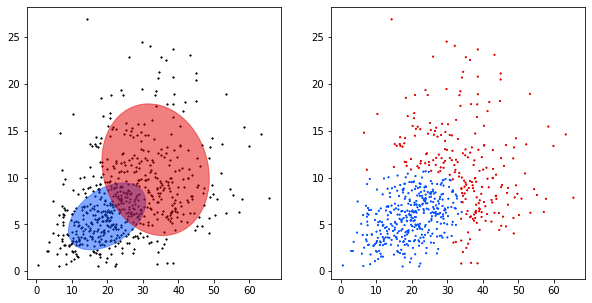

/Users/matthewbernstein/Development/python3_dev/lib/python3.7/site-packages/ipykernel_launcher.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


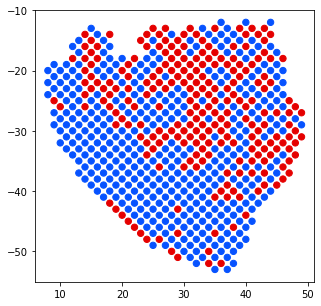

In [33]:
examine_clusters('KRT16', 'KRT17', adata)

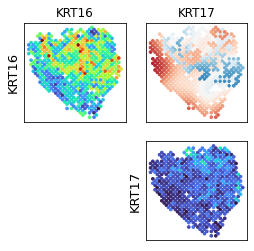

In [35]:
spatialcorr.plot.mult_genes_plot_correlation(
    ['KRT16', 'KRT17'],
    adata,
    'gene_pair_clusters_vary_k',
    estimate_type='local'
)

Kept 476/620 spots.


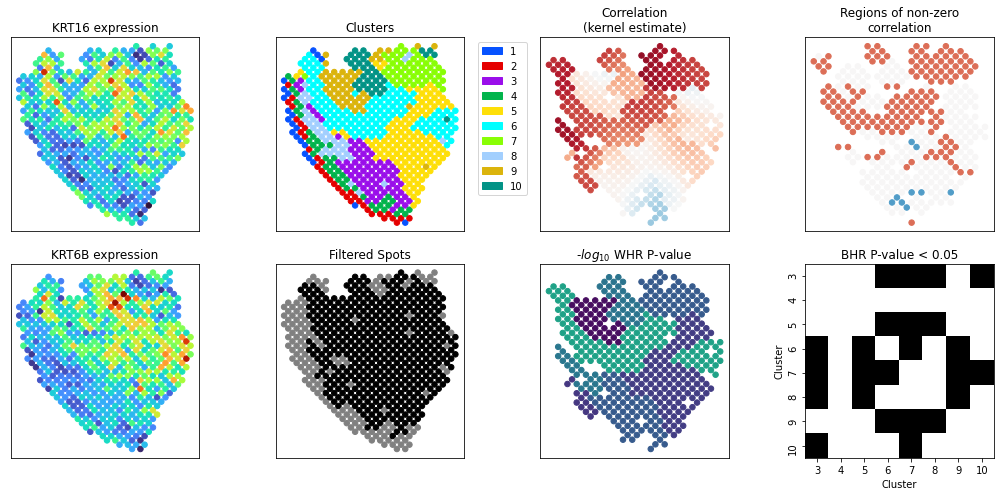

In [13]:
spatialcorr.analysis_pipeline_pair(
    'KRT16',            
    'KRT6B',            
    adata,              
    bandwidth=5,        
    cond_key='BayesSpace_11', 
    max_perms=100,      
    dsize=30,           
    verbose=0
)

Kept 476/620 spots.


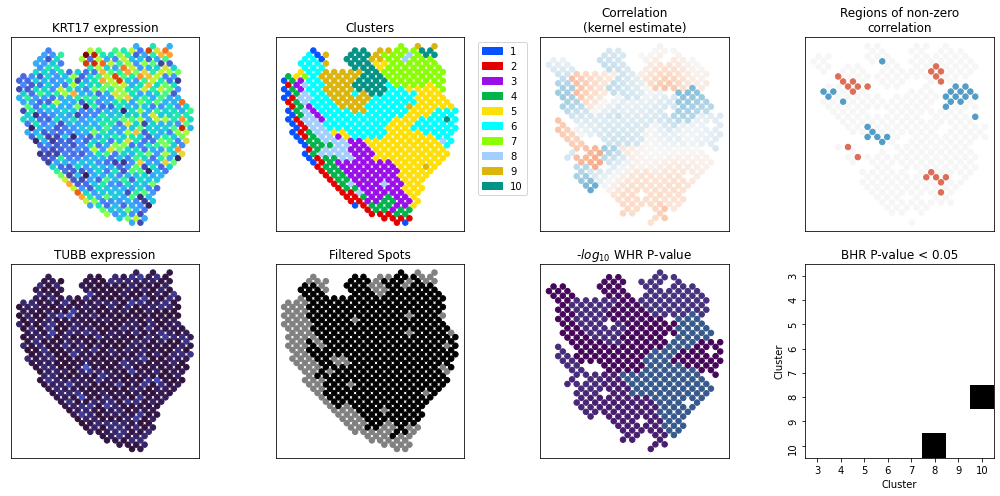

In [24]:
spatialcorr.analysis_pipeline_pair(
    'KRT17',            
    'TUBB',            
    adata,              
    bandwidth=5,        
    cond_key='BayesSpace_11', 
    max_perms=100,      
    dsize=30,           
    verbose=0
)

Kept 476/620 spots.


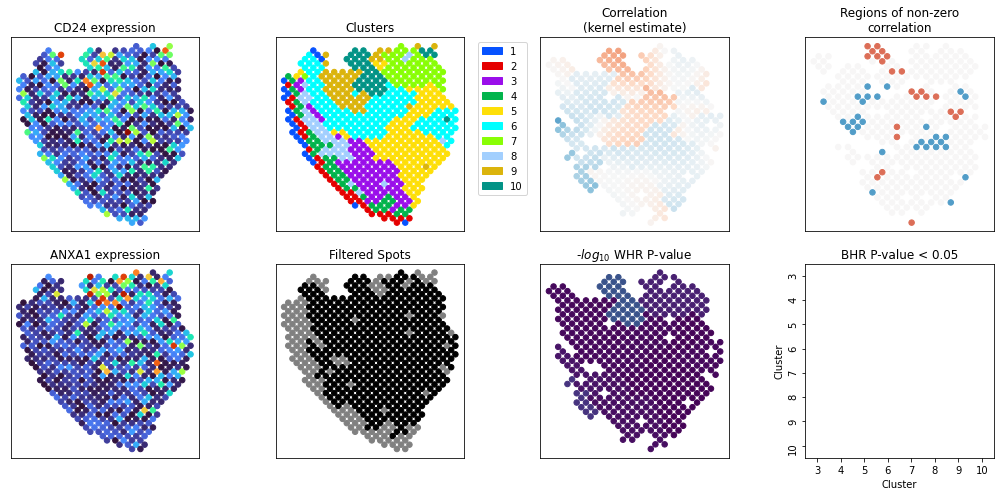

In [12]:
spatialcorr.analysis_pipeline_pair(
    'CD24',            
    'ANXA1',            
    adata,              
    bandwidth=5,        
    cond_key='BayesSpace_11', 
    max_perms=100,      
    dsize=30,           
    verbose=0
)

Kept 476/620 spots.


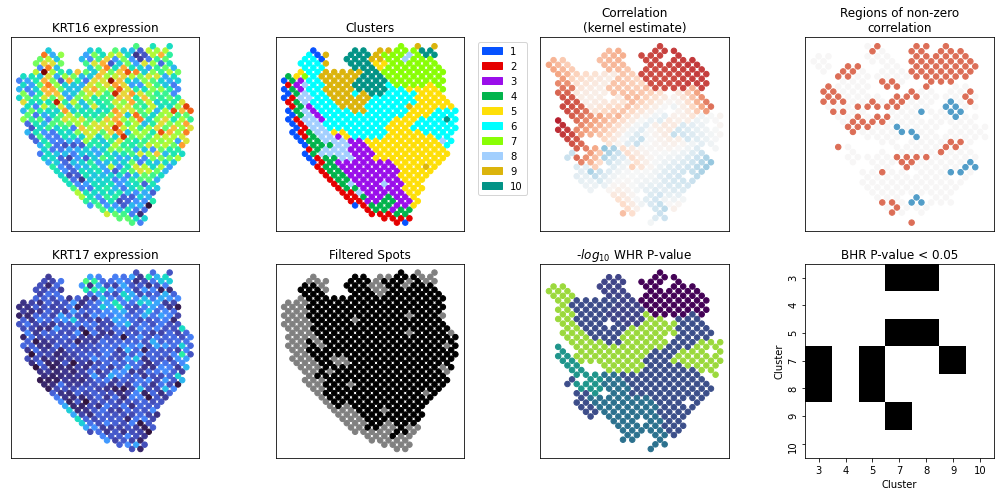

In [22]:
spatialcorr.analysis_pipeline_pair(
    'KRT16',            
    'KRT17',            
    adata,              
    bandwidth=5,        
    cond_key='BayesSpace_11', 
    max_perms=100,      
    dsize=30,           
    verbose=0
)

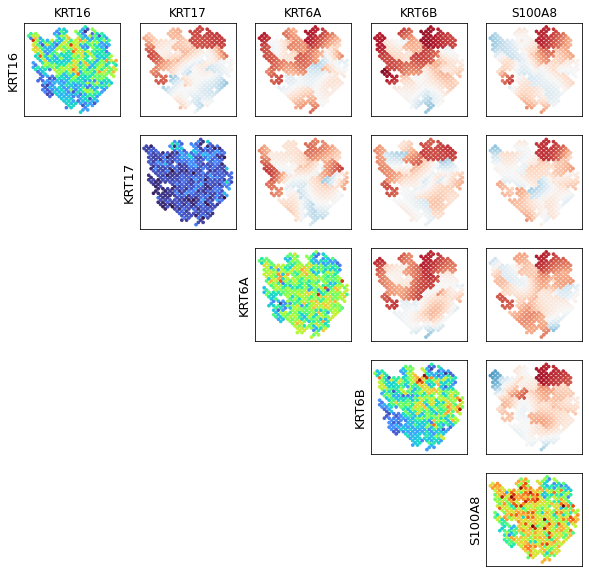

In [17]:
spatialcorr.plot.mult_genes_plot_correlation(
    ['KRT16', 'KRT17', 'KRT6A', 'KRT6B', 'S100A8'],
    adata,
    'BayesSpace_11',
    estimate_type='local'
)

In [17]:
def plot_within(g1, g2, condition='BayesSpace_11', sigma=5, dsize=10, ax=None, figure=None):
    plot_gene(g1, adata, cmap='turbo')
    plot_gene(g2, adata, cmap='turbo')
    corrs, kept_inds, _ = spatialcorr.plot_correlation(
        adata,
        g1, g2,
        sigma=sigma,
        contrib_thresh=10,
        kernel_matrix=None,
        row_key='row',
        col_key='col',
        condition=condition,
        cmap='RdBu_r',
        colorbar=True,
        ticks=True,
        ax=ax,
        figure=figure,
        estimate='local',
        dsize=dsize
    )
    #plt.show()
    return corrs, kept_inds

def plot_between(g1, g2, condition='BayesSpace_11'):
    plot_gene(g1, adata, cmap='turbo')
    plot_gene(g2, adata, cmap='turbo')
    corrs, kept_inds = spatialcorr.plot_correlation(
        adata,
        g1, g2,
        kernel_matrix=None,
        row_key='row',
        col_key='col',
        condition=condition,
        cmap='RdBu_r',
        colorbar=True,
        ticks=True,
        ax=None,
        figure=None,
        estimate='regional'
    )
    plt.show()
    return corrs, kept_inds

def run_full_analysis_pairwise(
        g1, 
        g2, 
        sigma=5, 
        max_perms=500, 
        n_procs=5, 
        test_between=False, 
        spot_to_neighbors=None, 
        spot_to_neighbors_clust=None
    ):
    plot_within(g1, g2, sigma=sigma);
    plt.show()

    p_val, t_obs, t_nulls, kept_inds, obs_spot_lls, spotwise_t_nulls, spot_p_vals = spatialcorr.run_test(
        adata,
        [g1, g2],
        sigma,
        cond_key='BayesSpace_11',
        contrib_thresh=10,
        row_key='row',
        col_key='col',
        verbose=1,
        n_procs=n_procs,
        test_between_conds=test_between,
        compute_spotwise_pvals=True,
        max_perms=max_perms,
        mc_pvals=False,
        spot_to_neighbors=spot_to_neighbors_clust
    )
    print("P-value: ", p_val)
    
    n_sig_0_05 = len([x for x in spot_p_vals if x < 0.05])
    print("Number of spotwise p-values < 0.05: ", n_sig_0_05)
    
    max_val = np.quantile([abs(x) for x in obs_spot_lls], 0.8)
    llrtp.plot_slide(
        adata.obs.iloc[kept_inds], 
        obs_spot_lls, 
        cmap='PRGn',
        colorbar=True,
        dsize=13,
        vmin=-1*np.log(2),
        vmax=np.log(2),
        title='Log-likelihood ratios'
    )
    plt.show()
    
    #print("Mean p-value: ", np.mean(spot_p_vals))
    #sns.histplot(-1 * np.log10(spot_p_vals))
    #plt.show()
    
    #llrtp.plot_slide(
    #    adata.obs.iloc[kept_inds], 
    #    spot_p_vals, 
    #    cmap='viridis_r',
    #    colorbar=True,
    #    #vmin=0,
    #    #vmax=-1 * np.log10(1/max_perms),
    #    dsize=13,
    #    title='p-value'
    #)
    #plt.show()
    
    llrtp.plot_slide(
        adata.obs.iloc[kept_inds], 
        -1 * np.log10(spot_p_vals), 
        cmap='viridis',
        colorbar=True,
        #vmin=0,
        #vmax=-1 * np.log10(1/max_perms),
        dsize=13,
        title=r'$-log_{10}$ p-value'
    )
    plt.show()
    
    #cs_pvals = compute_spotwise_significance(
    #    adata.obs.iloc[kept_inds], 
    #    spot_p_vals
    #)
    #cs_pvals_fdr, _, _, _ = multipletests(
    #    cs_pvals, 
    #    method='fdr_bh',
    #    alpha=0.05
    #)

    #llrtp.plot_slide(
    #    adata.obs.iloc[kept_inds], 
    #    cs_pvals_fdr, 
    #    cmap='categorical',
    #    colorbar=True,
    #    vmin=0,
    #    vmax=1,
    #    dsize=20
    #)
    #plt.show()
    
    #return cs_pvals_fdr, kept_inds

def run_full_analysis_gene_set(genes, sigma=5, test_between=False):
    #plot_within(g1, g2);
    #plt.show()

    p_val, t_obs, t_nulls, kept_inds, obs_spot_lls, spotwise_t_nulls, spot_p_vals = spatialcorr.run_test(
        adata,
        genes,
        sigma,
        cond_key='BayesSpace_11',
        contrib_thresh=10,
        row_key='row',
        col_key='col',
        verbose=1,
        n_procs=5,
        test_between_conds=False,
        compute_spotwise_pvals=True,
        max_perms=100
    )
    print("P-value: ", p_val)
    
    cs_pvals = compute_spotwise_significance(
        adata.obs.iloc[kept_inds], 
        spot_p_vals
    )

    cs_pvals_fdr, _, _, _ = multipletests(
        cs_pvals, 
        method='fdr_bh',
        alpha=0.1
    )
    
    llrtp.plot_slide(
        adata.obs.iloc[kept_inds], 
        spot_p_vals, 
        cmap='viridis_r',
        colorbar=True,
        vmin=0,
        vmax=1,
        dsize=15
    )
    plt.show()

    llrtp.plot_slide(
        adata.obs.iloc[kept_inds], 
        cs_pvals_fdr, 
        cmap='categorical',
        colorbar=True,
        vmin=0,
        vmax=1,
        dsize=20
    )
    plt.show()
    
    return cs_pvals_fdr, kept_inds

In [18]:
def full_analysis_pair_2(
        g1, 
        g2, 
        sigma=5, 
        max_perms=500, 
        n_procs=5, 
        test_between=False, 
        spot_to_neighbors=None, 
        spot_to_neighbors_clust=None
    ):
    fig, axarr = plt.subplots(
        2,
        3,
        figsize=(6,4)
    )  
    
    expr_1 = adata.obs_vector(g1)
    expr_2 = adata.obs_vector(g2)
    min_expr = min(list(expr_1) + list(expr_2))
    max_expr = max(list(expr_1) + list(expr_2))
        
    spatialcorr.plot_slide(
        adata.obs,
        expr_1,
        cmap='turbo',
        colorbar=False,
        vmin=min_expr,
        vmax=max_expr,
        title=f'{g1} expression',
        ax=axarr[0][0],
        figure=None,
        ticks=False,
        dsize=10,
        colorticks=None,
        row_key='row',
        col_key='col'
    )
    spatialcorr.plot_slide(
        adata.obs,
        expr_2,
        cmap='turbo',
        colorbar=False,
        vmin=min_expr,
        vmax=max_expr,
        title=f'{g2} expression',
        ax=axarr[1][0],
        figure=None,
        ticks=False,
        dsize=10,
        colorticks=None,
        row_key='row',
        col_key='col'
    )
    spatialcorr.plot_slide(
        adata.obs,
        adata.obs['BayesSpace_11'],
        cmap='categorical',
        colorbar=False,
        vmin=min_expr,
        vmax=max_expr,
        title=f'Clusters',
        ax=axarr[1][1],
        figure=None,
        ticks=False,
        dsize=10,
        colorticks=None,
        row_key='row',
        col_key='col'
    )
    
    if test_between:
        spatialcorr.plot_correlation(
            adata,
            g1,
            g2,
            sigma=5,
            contrib_thresh=10,
            row_key='row',
            col_key='col',
            condition='BayesSpace_11',
            cmap='RdBu_r',
            colorbar=False,
            ticks=False,
            ax=axarr[0][1],
            figure=fig,
            dsize=10,
            estimate='regional',
            title='Correlation\n(cluster estimate)'
        )
    else:
        spatialcorr.plot_correlation(
            adata,
            g1,
            g2,
            sigma=5,
            contrib_thresh=10,
            row_key='row',
            col_key='col',
            condition='BayesSpace_11',
            cmap='RdBu_r',
            colorbar=False,
            ticks=False,
            ax=axarr[0][1],
            figure=fig,
            dsize=10,
            estimate='local',
            title='Correlation\n(kernel estimate)'
        )
    
    if test_between:
        bin_corrs = corr_pos_neg_by_cluster(g1, g2, adata)
        keep_inds = np.arange(adata.shape[0])
    else:
        bin_corrs, keep_inds = corr_pos_neg(
            g1, g2, 
            adata, 
            neigh_thresh=10, 
            bc_to_neighs=spot_to_neighbors
        )
    spatialcorr.plot_slide(
        adata.obs.iloc[keep_inds],
        bin_corrs,
        cmap='RdBu_r',
        colorbar=False,
        vmin=-1.8,
        vmax=1.8,
        title=f'Regions of non-zero\ncorrelation',
        ax=axarr[0][2],
        figure=None,
        ticks=False,
        dsize=10,
        colorticks=None,
        row_key='row',
        col_key='col'
    )
    
    
    
    p_val, t_obs, t_nulls, kept_inds, obs_spot_lls, spotwise_t_nulls, spot_p_vals = spatialcorr.run_test(
        adata,
        [g1, g2],
        sigma,
        cond_key='BayesSpace_11',
        contrib_thresh=10,
        row_key='row',
        col_key='col',
        verbose=1,
        n_procs=n_procs,
        test_between_conds=test_between,
        compute_spotwise_pvals=True,
        max_perms=max_perms,
        mc_pvals=False,
        spot_to_neighbors=spot_to_neighbors_clust
    )
    print(f"P-value: {p_val}")
    spatialcorr.plot_slide(
        adata.obs.iloc[kept_inds],
        -1 * np.log10(spot_p_vals),
        cmap='viridis',
        colorbar=False,
        vmin=0,
        vmax=-1 * np.log10(1/max_perms),
        title=r'-$log_{10}$ p-value',
        ax=axarr[1][2],
        figure=None,
        ticks=False,
        dsize=10,
        colorticks=None,
        row_key='row',
        col_key='col'
    )
    
def huh():
    p_val, t_obs, t_nulls, kept_inds, obs_spot_lls, spotwise_t_nulls, spot_p_vals = spatialcorr.run_test(
        adata,
        [g1, g2],
        sigma,
        cond_key='BayesSpace_11',
        contrib_thresh=10,
        row_key='row',
        col_key='col',
        verbose=1,
        n_procs=n_procs,
        test_between_conds=test_between,
        compute_spotwise_pvals=True,
        max_perms=max_perms,
        mc_pvals=False,
        spot_to_neighbors=spot_to_neighbors
    )
    print("P-value: ", p_val)
    
    n_sig_0_05 = len([x for x in spot_p_vals if x < 0.05])
    print("Number of spotwise p-values < 0.05: ", n_sig_0_05)
    
    max_val = np.quantile([abs(x) for x in obs_spot_lls], 0.8)
    llrtp.plot_slide(
        adata.obs.iloc[kept_inds], 
        obs_spot_lls, 
        cmap='PRGn',
        colorbar=True,
        dsize=13,
        vmin=-1*np.log(2),
        vmax=np.log(2),
        title='Log-likelihood ratios'
    )
    plt.show()
    
    
    

In [16]:
def pairwise_clust_between(g1, g2):
    ct_to_ct_to_pval = spatialcorr.run_test_between_region_pairs(
        adata,
        [g1, g2],
        5,
        'BayesSpace_11',
        contrib_thresh=10,
        row_key='row',
        col_key='col',
        verbose=1,
        n_procs=5,
        standardize_var=False,
        max_perms=500,
        mc_pvals=True,
        spot_to_neighbors=None
    )
    da = []
    for ct_1 in sorted(set(ct_to_ct_to_pval.keys())):
        row = []
        for ct_2 in sorted(set(ct_to_ct_to_pval.keys())):
            if ct_1 == ct_2:
                row.append(False)
            else:
                row.append(ct_to_ct_to_pval[ct_1][ct_2] < 0.05)
        da.append(row)
    df_plot = pd.DataFrame(
        data=da,
        columns=sorted(set(ct_to_ct_to_pval.keys())),
        index=sorted(set(ct_to_ct_to_pval.keys()))
    )
    return df_plot

In [17]:
row_col_to_barcode = spatialcorr.utils.map_row_col_to_barcode(
    adata.obs,
    row_key='row',
    col_key='col'
)
bc_to_neighs = spatialcorr.utils.compute_neighbors(
    adata.obs,
    row_col_to_barcode,
    row_key='row',
    col_key='col',
    rad=3
)

In [18]:
clust_to_bcs = defaultdict(lambda: [])
for bc, clust in zip(adata.obs.index, adata.obs['BayesSpace_11']):
    clust_to_bcs[clust].append(bc)   
bc_to_index = {
    bc: bc_i
    for bc_i, bc in enumerate(adata.obs.index)
}
clust_to_indices = {
    clust: [bc_to_index[bc] for bc in bcs]
    for clust, bcs in clust_to_bcs.items()
}
bc_to_clust = {
    bc: clust
    for bc, clust in zip(adata.obs.index, adata.obs['BayesSpace_11'])
}
bc_to_neighs_clust_cond = {}
for bc, neighs in bc_to_neighs.items():
    curr_clust = bc_to_clust[bc]
    new_neighs = [
        x 
        for x in neighs
        if bc_to_clust[x] == curr_clust
    ]
    #print(new_neighs)
    bc_to_neighs_clust_cond[bc] = new_neighs
    
bc_to_neighs_full_clust = {
    bc: [adata.obs.index[ind] for ind in clust_to_indices[bc_to_clust[bc]]]
    for bc in bc_to_neighs_clust_cond
}

# Compute cluster markers

AttributeError: Can only use .cat accessor with a 'category' dtype

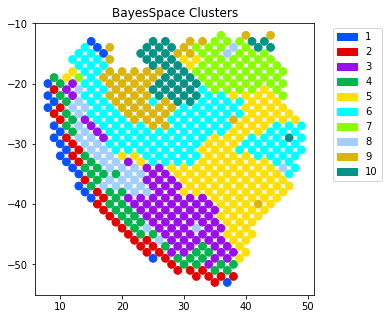

In [22]:
llrtp.plot_slide(
    adata.obs, 
    adata.obs['BayesSpace_11'], 
    cmap='categorical', 
    title="BayesSpace Clusters",
    dsize=60
)
sc.tl.rank_genes_groups(adata, 'BayesSpace_11', method='wilcoxon')
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=True, save=True)

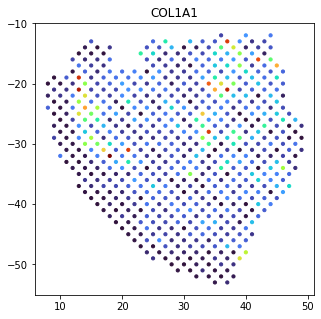

In [23]:
plot_gene('COL1A1', adata, cmap='turbo')

# Dig into results from running on GO terms

In [21]:
def plot_gene_set_result(data_res, gs, est_type, corr_magnitude=False, data_res_2=None, plot_pairwise_bar=False, plot_conf=True):
    if gs in data_res['gene_set_to_pairwise_pvals'].keys():
        if data_res_2 is not None:
            assert frozenset(data_res['gene_set_to_genes'].keys()) == frozenset(data_res_2['gene_set_to_genes'].keys())
            generate_gene_set_plots(
                data_res['gene_set_to_genes'][gs], 
                adata,
                condition='BayesSpace_11',
                estimate_type=est_type,
                sigma=7,
                pairwise_pvals=data_res['gene_set_to_pairwise_pvals'][gs],
                pairwise_pvals_2=data_res_2['gene_set_to_pairwise_pvals'][gs],
                corr_magnitude=corr_magnitude,
                plot_conf=plot_conf
            )
        else:
            generate_gene_set_plots(
                data_res['gene_set_to_genes'][gs], 
                adata,
                condition='BayesSpace_11',
                estimate_type=est_type,
                sigma=7,
                pairwise_pvals=data_res['gene_set_to_pairwise_pvals'][gs],
                corr_magnitude=corr_magnitude,
                plot_conf=plot_conf
            )
        plt.show()
        if plot_pairwise_bar:
            sns.histplot(list(data_res['gene_set_to_pairwise_pvals'][gs].values()))
            plt.show()
            p_vals_fdr, _, _, _ = multipletests(
                list(data_res['gene_set_to_pairwise_pvals'][gs].values()), 
                method='fdr_bh',
                alpha=0.05
            )
            print(Counter(p_vals_fdr))
    else:
        generate_gene_set_plots(
            data_res['gene_set_to_genes'][gs], 
            adata,
            condition='BayesSpace_11',
            estimate_type=est_type,
            sigma=7,
            corr_magnitude=corr_magnitude,
            plot_conf=plot_conf
        )

## GO Leukocyte Cell Cell Adhesion

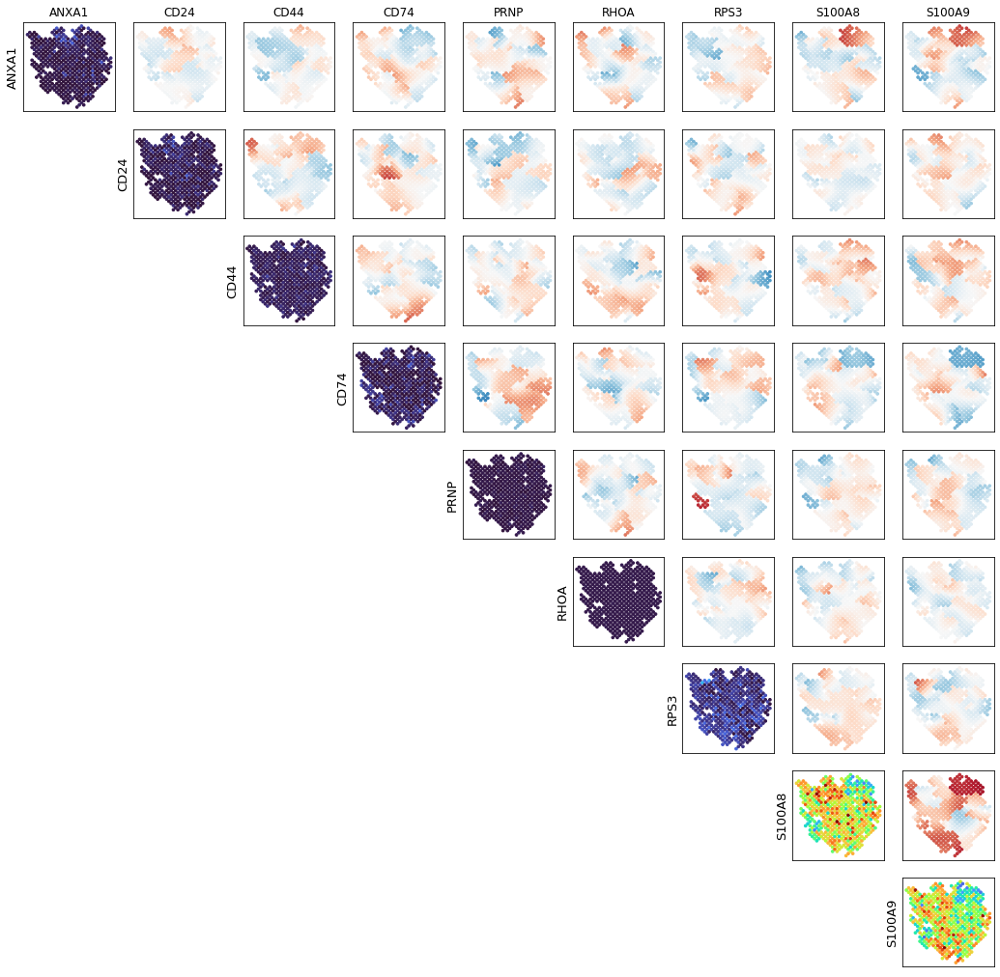

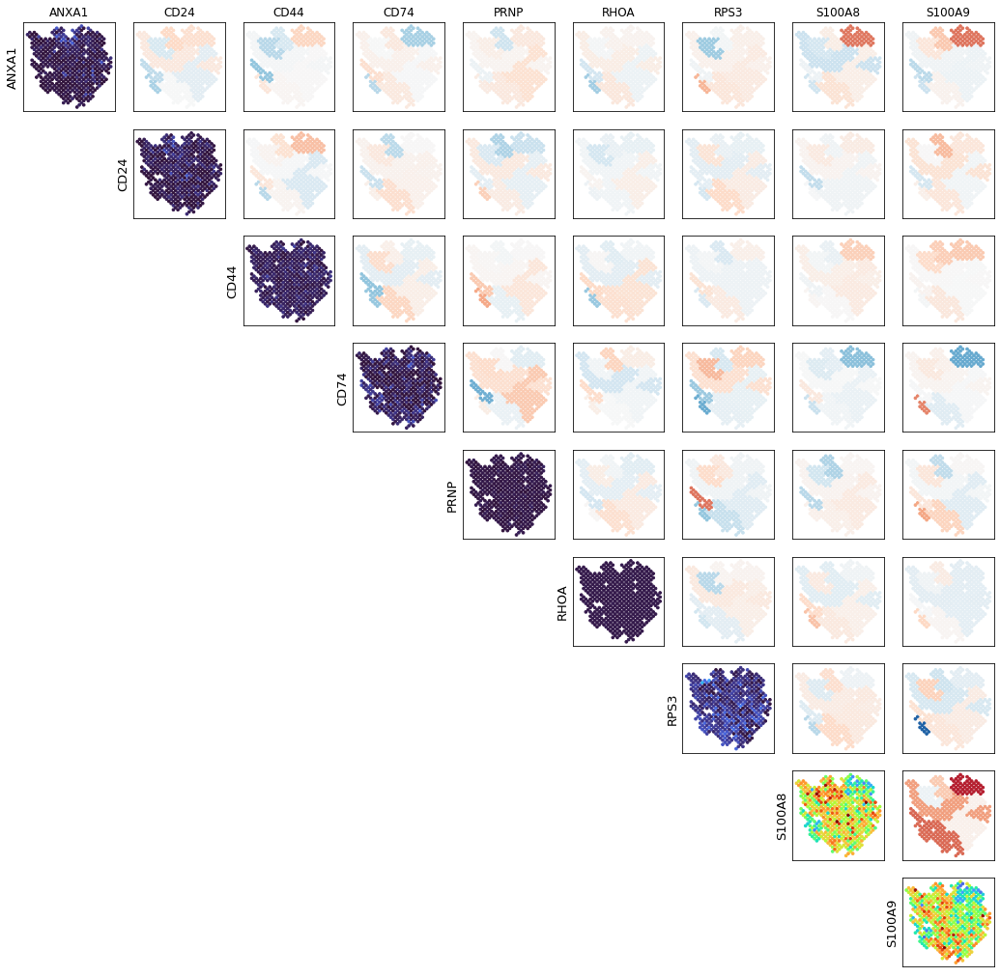

In [26]:
spatialcorr.plot.mult_genes_plot_correlation(
    j_cell_cell_adhesion_between['gene_set_to_genes']['GO_LEUKOCYTE_CELL_CELL_ADHESION'],
    adata,
    'BayesSpace_11',
    estimate_type='local'
)
spatialcorr.plot.mult_genes_plot_correlation(
    j_cell_cell_adhesion_between['gene_set_to_genes']['GO_LEUKOCYTE_CELL_CELL_ADHESION'],
    adata,
    'BayesSpace_11',
    estimate_type='regional'
)

# GO Cell Cell Adhesion

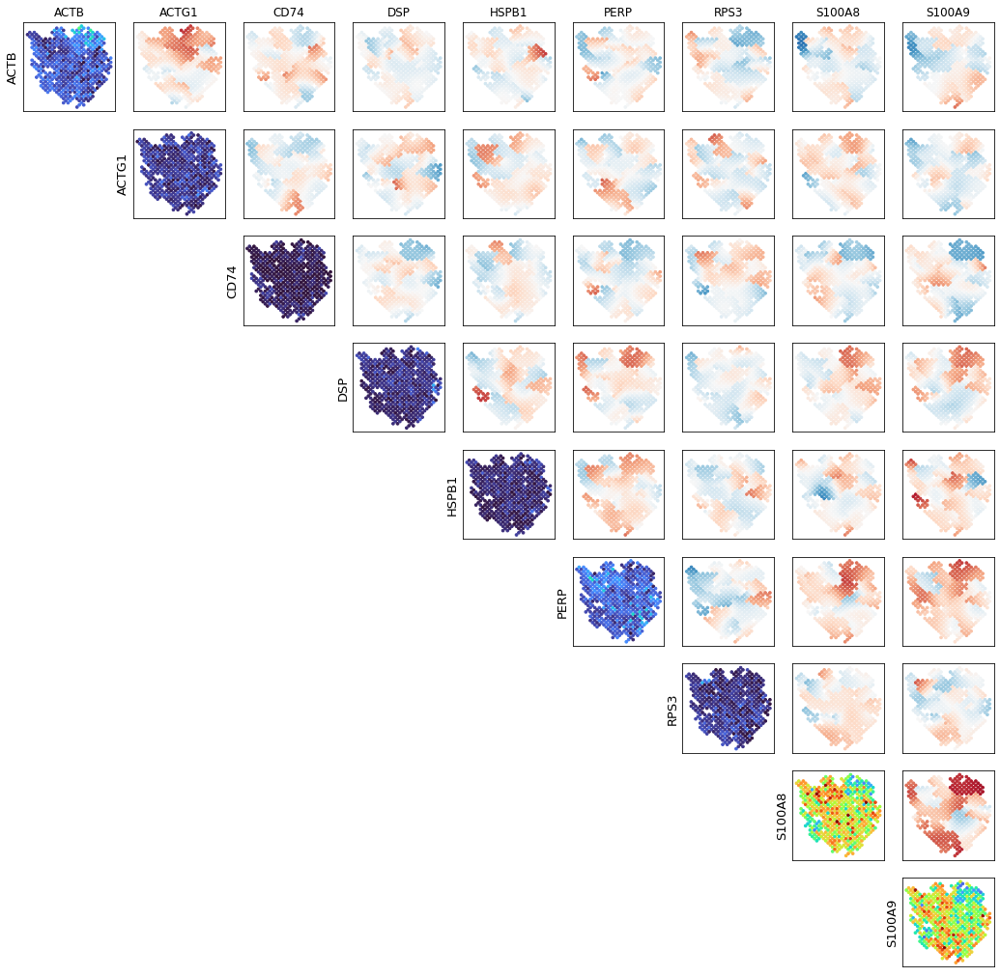

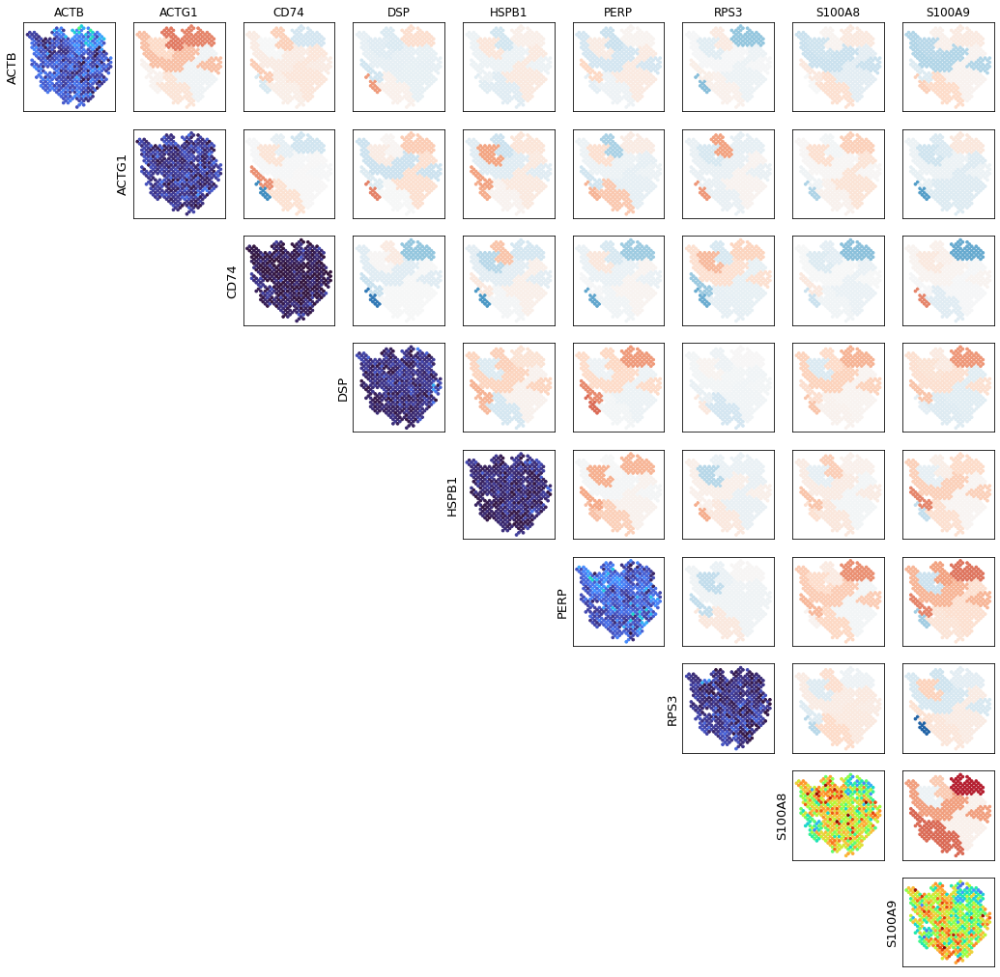

In [29]:
spatialcorr.plot.mult_genes_plot_correlation(
    j_cell_cell_adhesion_between['gene_set_to_genes']['GO_CELL_CELL_ADHESION'],
    adata,
    'BayesSpace_11',
    estimate_type='local'
)
spatialcorr.plot.mult_genes_plot_correlation(
    j_cell_cell_adhesion_between['gene_set_to_genes']['GO_CELL_CELL_ADHESION'],
    adata,
    'BayesSpace_11',
    estimate_type='regional'
)

# GO Keratinocyte Differentiation

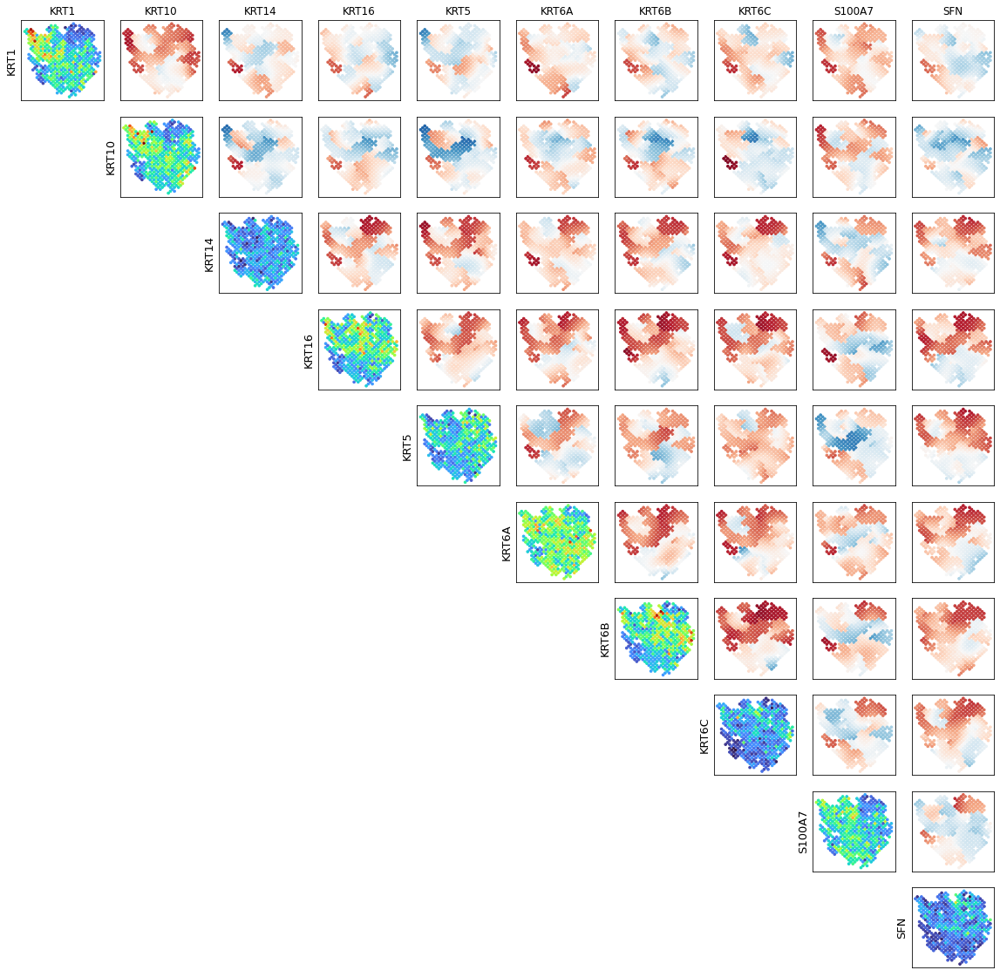

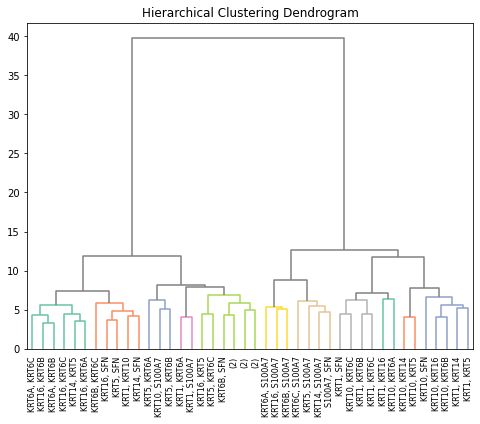

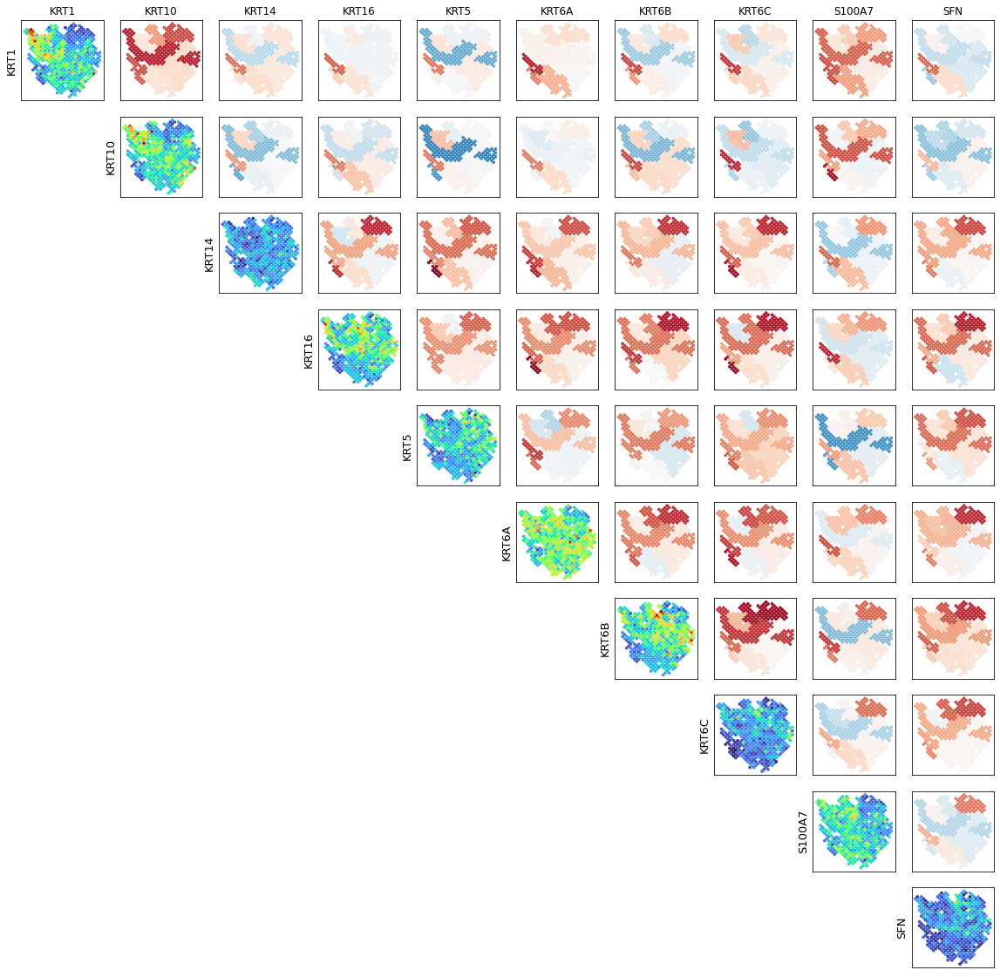

In [18]:
spatialcorr.plot.mult_genes_plot_correlation(
    j_keratinocyte_between['gene_set_to_genes']['GO_KERATINOCYTE_DIFFERENTIATION'],
    adata,
    'BayesSpace_11',
    estimate_type='local'
)
spatialcorr.plot.cluster_pairwise_correlations(
    j_keratinocyte_between['gene_set_to_genes']['GO_KERATINOCYTE_DIFFERENTIATION'],
    adata,
    'BayesSpace_11',
    sigma=5,
    row_key='row',
    col_key='col',
    color_thresh=7
)
spatialcorr.plot.mult_genes_plot_correlation(
    j_keratinocyte_between['gene_set_to_genes']['GO_KERATINOCYTE_DIFFERENTIATION'],
    adata,
    'BayesSpace_11',
    estimate_type='regional'
)

In [34]:
gps, all_corrs = compute_pairwise_corrs(j_keratinocyte_within['gene_set_to_pairwise_pvals']['GO_KERATINOCYTE_DIFFERENTIATION'])

['#66c2a5', '#fc8d62', '#8da0cb', '#e78ac3', '#a6d854', '#ffd92f', '#e5c494', '#b3b3b3']


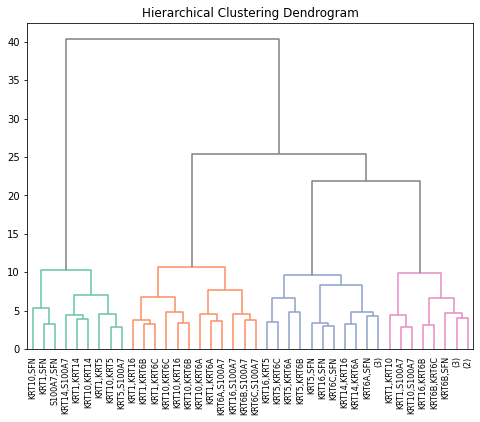

In [35]:
cluster_corrs(gps, all_corrs)

## Gene pair: KRT6B, KRT16

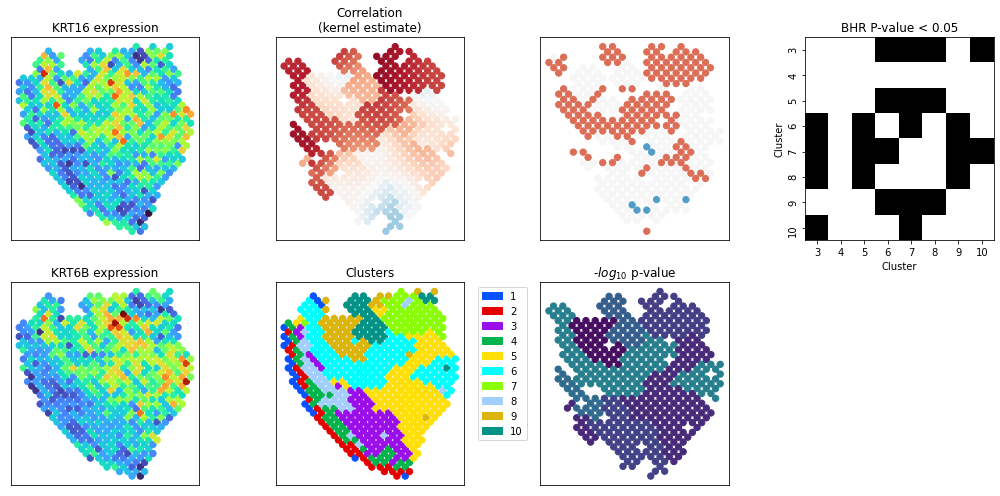

In [16]:
spatialcorr.analysis_pipeline_pair('KRT16', 'KRT6B', adata, 'BayesSpace_11', max_perms=500, dsize=40, verbose=0)

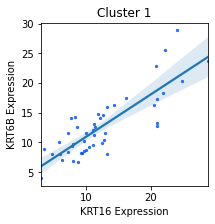

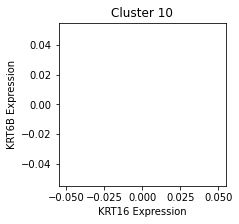

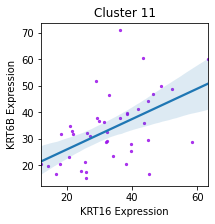

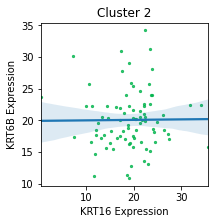

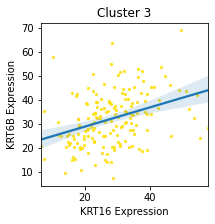

...

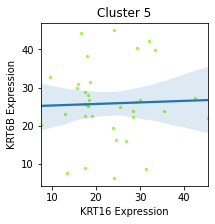

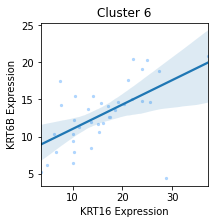

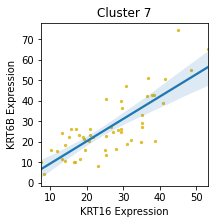

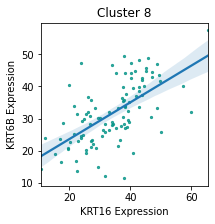

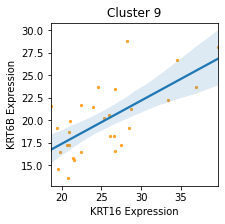

In [128]:
for c_i, i in enumerate([0, 9, 10, 1, 2, 3, 4, 5, 6, 7, 8]):
    clust = str(i+1)
    plot_cluster_scatter('KRT16', 'KRT6B', clust, color=spatialcorr.plot.PALETTE_MANY[c_i])#, xlim=(0, 50), ylim=(0,50))
    plt.title(f'Cluster {clust}')
    plt.show()

In [59]:
df_plot = pairwise_clust_between('KRT16', 'KRT6B')

Kept 468/620 spots.
For cluster pair (2, 1), kept 70/85 spots.
Number of nulls > obs has hit threshold of 20. Total permutations used: 66. P-value = 0.30303030303030304
For cluster pair (3, 1), kept 153/166 spots.
Number of nulls > obs has hit threshold of 20. Total permutations used: 50. P-value = 0.4
For cluster pair (3, 2), kept 223/227 spots.
Number of nulls > obs has hit threshold of 20. Total permutations used: 255. P-value = 0.0784313725490196
For cluster pair (5, 1), kept 27/39 spots.
Number of nulls > obs has hit threshold of 20. Total permutations used: 26. P-value = 0.7692307692307693
For cluster pair (5, 2), kept 97/100 spots.
Number of nulls > obs has hit threshold of 20. Total permutations used: 21. P-value = 0.9523809523809523
For cluster pair (5, 3), kept 180/181 spots.
Number of nulls > obs has hit threshold of 20. Total permutations used: 20. P-value = 1.0
For cluster pair (6, 1), kept 5/28 spots.
Number of nulls > obs has hit threshold of 20. Total permutations used:

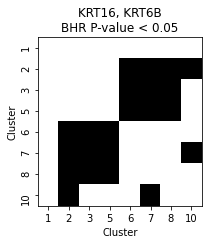

In [61]:
fig, ax = plt.subplots(1,1, figsize=(3, 3.5))
res = sns.heatmap(df_plot, cmap='Greys', cbar=False, ax=ax)
for _, spine in res.spines.items():
    spine.set_visible(True)
ax.set_title('KRT16, KRT6B\nBHR P-value < 0.05')
ax.set_ylabel('Cluster')
ax.set_xlabel('Cluster')
plt.tight_layout()
fig.savefig('./figures/Patient10_KRT16_KRT6B_pairwise_BHR_pvals.pdf', format='pdf')

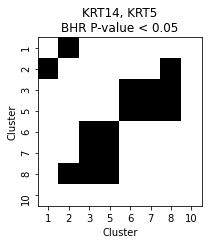

In [55]:
fig, ax = plt.subplots(1,1, figsize=(3, 3.5))
res = sns.heatmap(df_plot, cmap='Greys', cbar=False, ax=ax)
for _, spine in res.spines.items():
    spine.set_visible(True)
ax.set_title('KRT14, KRT5\nBHR P-value < 0.05')
ax.set_ylabel('Cluster')
ax.set_xlabel('Cluster')
plt.tight_layout()
fig.savefig('./figures/Patient10_KRT14_KRT5_pairwise_BHR_pvals.pdf', format='pdf')

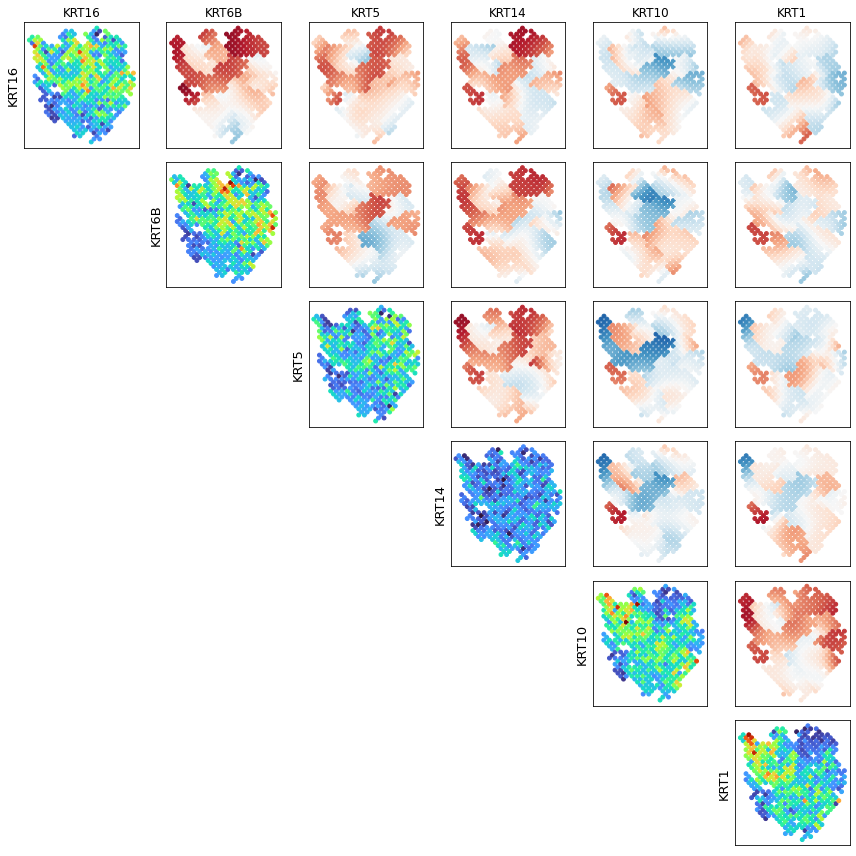

In [35]:
generate_gene_set_plots(
    ['KRT16', 'KRT6B', 'KRT5', 'KRT14', 'KRT10', 'KRT1'], 
    adata,
    condition='BayesSpace_11',
    estimate_type='local',
    sigma=5,
    #pairwise_pvals=data_res['gene_set_to_pairwise_pvals'][gs],
    #pairwise_pvals_2=data_res_2['gene_set_to_pairwise_pvals'][gs],
    corr_magnitude=False,
    plot_conf=False,
    dsize=15,
    fig_path='./figures/P10_keratin_pairwise.pdf'
)

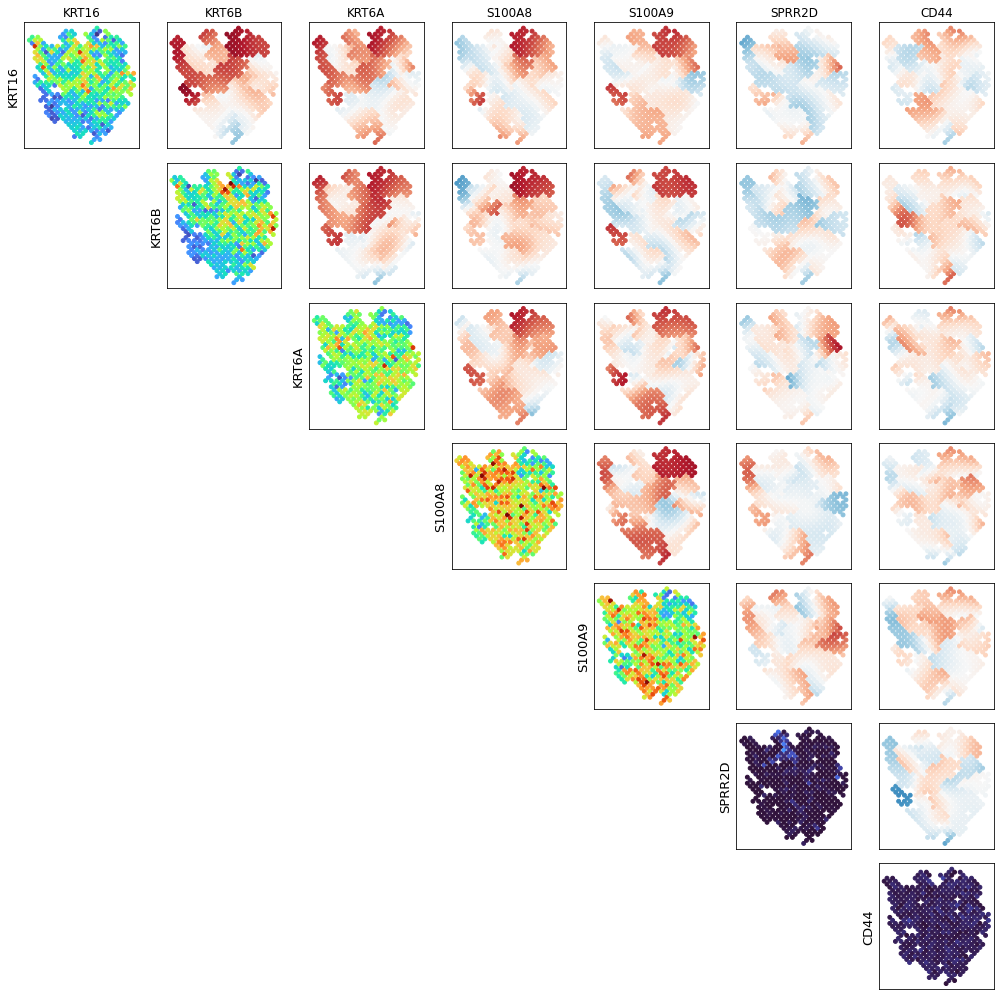

In [38]:

generate_gene_set_plots(
    ['KRT16', 'KRT6B', 'KRT6A', 'S100A8', 'S100A9', 'DEFB3', 'SPRR2D', 'STFA1', 'CD44', 'SERPINB3C'], 
    adata,
    condition='BayesSpace_11',
    estimate_type='local',
    sigma=5,
    #pairwise_pvals=data_res['gene_set_to_pairwise_pvals'][gs],
    #pairwise_pvals_2=data_res_2['gene_set_to_pairwise_pvals'][gs],
    corr_magnitude=False,
    plot_conf=False,
    dsize=15,
    fig_path='./figures/P10_keratin_pairwise.pdf'
)

Trying to set attribute `.obs` of view, copying.
/Users/matthewbernstein/Development/python3_dev/lib/python3.7/site-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "bbox_layout" which is no longer supported as of 3.3 and will become an error two minor releases later


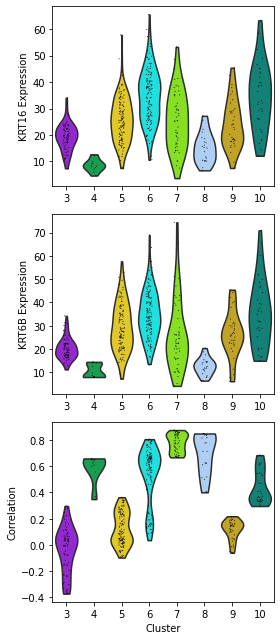

In [40]:


adata_keep = adata.copy()
corrs, keep_inds = spatialcorr.utils.compute_local_correlation(
    adata, 
    'KRT16', 'KRT6B',
    kernel_matrix=None, 
    row_key='row', 
    col_key='col', 
    condition='BayesSpace_11', 
    sigma=5,
    contrib_thresh=10
)
adata_keep = adata_keep[keep_inds,:]
adata_keep.obs['Correlation KRT16 & KRT6B'] = corrs

fig, axarr = plt.subplots(3,1, figsize=(4, 9))
cust_pal = np.array(spatialcorr.plot.PALETTE_MANY)[
    [2, 3, 4, 5, 6, 7, 8, 9, 10]
]
sc.pl.violin(
    adata_keep, 
    'KRT16', 
    groupby='BayesSpace_11', 
    palette=cust_pal, 
    ax=axarr[0], 
    show=False
)
sc.pl.violin(
    adata_keep, 
    'KRT6B', 
    groupby='BayesSpace_11', 
    palette=cust_pal, 
    ax=axarr[1], 
    show=False
)
sc.pl.violin(
    adata_keep, 
    'Correlation KRT16 & KRT6B', 
    groupby='BayesSpace_11', 
    palette=cust_pal, 
    ax=axarr[2], 
    show=False
)

axarr[0].set_xlabel('')
axarr[1].set_xlabel('')
axarr[2].set_xlabel('Cluster')
axarr[0].set_ylabel('KRT16 Expression')
axarr[1].set_ylabel('KRT6B Expression')
axarr[2].set_ylabel('Correlation')
#plt.show()

plt.tight_layout()
fig.savefig('./figures/P10_KRT16_KRT6B_expression_corr_distr_violin.pdf', bbox_layout='tight', format='pdf')

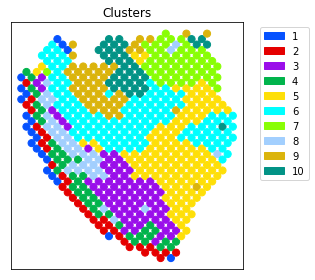

In [43]:
fig, ax = plt.subplots(1,1, figsize=(4.5, 4))
llrtp.plot_slide(
    adata.obs, 
    adata.obs['BayesSpace_11'], 
    cmap='categorical', 
    title="Clusters",
    dsize=50,
    ticks=False,
    figure=fig,
    ax=ax
)

plt.tight_layout()
fig.savefig('./figures/P10_clusters.pdf', format='pdf')


## Gene pair: KRT14, KRT5

Kept 468/620 spots.
P-value: 0.014
Kept 468/620 spots.
P-value: 0.002


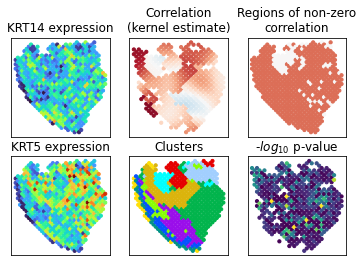

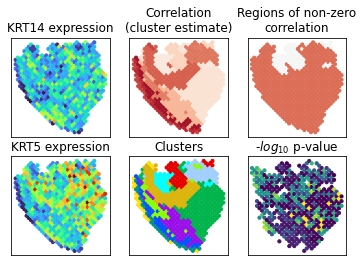

In [87]:
full_analysis_pair_2(
    'KRT14', 'KRT5',
    sigma=5, 
    max_perms=500, 
    n_procs=5, 
    test_between=False, 
    spot_to_neighbors=bc_to_neighs_full_clust
)
full_analysis_pair_2(
    'KRT14', 'KRT5', 
    sigma=5, 
    max_perms=500, 
    n_procs=5, 
    test_between=True, 
    spot_to_neighbors=bc_to_neighs_full_clust
)

Kept 468/620 spots.
P-value: 0.164
Kept 468/620 spots.
P-value: 0.162


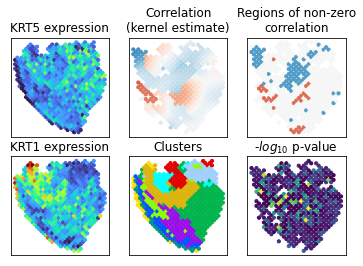

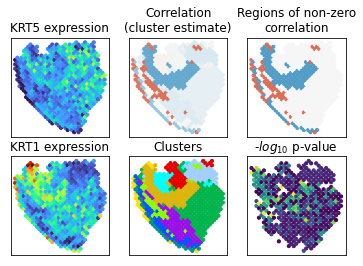

In [88]:
full_analysis_pair_2(
    'KRT5', 'KRT1',
    sigma=5, 
    max_perms=500, 
    n_procs=5, 
    test_between=False, 
    spot_to_neighbors=bc_to_neighs_clust_cond
)
full_analysis_pair_2(
    'KRT5', 'KRT1', 
    sigma=5, 
    max_perms=500, 
    n_procs=5, 
    test_between=True, 
    spot_to_neighbors=bc_to_neighs_full_clust
)

plot_gene_set_result(
    j_b_cell_between, 
    'GO_B_CELL_MEDIATED_IMMUNITY', 
    est_type='local',
    data_res_2=j_b_cell_within
)

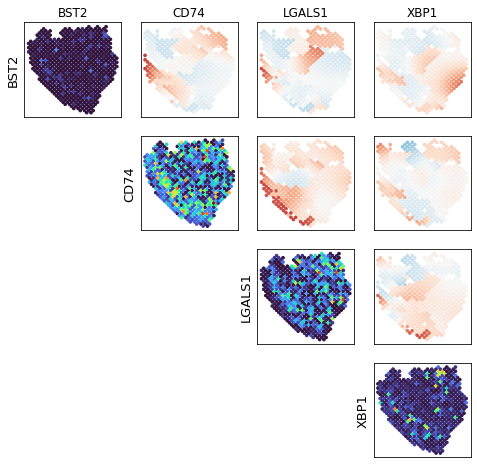

In [109]:
plot_gene_set_result(
    j_b_cell_between, 
    'GO_B_CELL_ACTIVATION', 
    est_type='local',
    data_res_2=j_b_cell_within,
    plot_conf=False
)

In [18]:
def compare_to_permutation(g1, g2, sigma=5):

    ct_to_indices = defaultdict(lambda: [])
    for i, ct in enumerate(adata.obs['BayesSpace_11']):
        ct_to_indices[ct].append(i)

    print("REAL:")
    expr = adata.obs_vector(g1)
    llrtp.plot_slide(
        adata.obs, 
        expr, 
        cmap='turbo', 
        title=g2,
        dsize=10
    )
    plt.title(g1)
    plt.show()


    expr = adata.obs_vector(g2)
    llrtp.plot_slide(
        adata.obs, 
        expr, 
        cmap='turbo', 
        title=g2,
        dsize=10
    )
    plt.title(g2)
    plt.show()
    corrs, kept_inds, _ = spatialcorr.plot_correlation(
        adata,
        g1, g2,
        sigma=sigma,
        contrib_thresh=10,
        kernel_matrix=None,
        row_key='row',
        col_key='col',
        condition='BayesSpace_11',
        cmap='RdBu_r',
        colorbar=True,
        ticks=True,
        estimate='local',
        dsize=13
    )
    plt.show()
    print("PERMUTED:")
    for i in range(5):
        adata_perm = adata.copy()
        perm_coords = spatialcorr.permute_coords(np.arange(adata.obs.shape[0]), ct_to_indices)
        adata_perm.obs = adata.obs.iloc[perm_coords]

        expr = adata_perm.obs_vector(g1)
        llrtp.plot_slide(
            adata_perm.obs, 
            expr, 
            cmap='turbo', 
            title=g1,
            dsize=10
        )
        plt.title(g1)
        plt.show()


        expr = adata_perm.obs_vector(g2)
        llrtp.plot_slide(
            adata_perm.obs, 
            expr, 
            cmap='turbo', 
            title=g2,
            dsize=10
        )
        plt.title(g2)
        plt.show()

        corrs, kept_inds, _ = spatialcorr.plot_correlation(
            adata_perm,
            g1, g2,
            sigma=sigma,
            contrib_thresh=10,
            kernel_matrix=None,
            row_key='row',
            col_key='col',
            condition='BayesSpace_11',
            cmap='RdBu_r',
            colorbar=True,
            ticks=True,
            estimate='local',
            dsize=13
        )
        plt.show()
        
        p_val, t_obs, t_nulls, kept_inds, obs_spot_lls, spotwise_t_nulls, spot_p_vals = spatialcorr.run_test(
            adata_perm,
            [g1, g2],
            sigma,
            cond_key='BayesSpace_11',
            contrib_thresh=10,
            row_key='row',
            col_key='col',
            verbose=1,
            n_procs=5,
            test_between_conds=False,
            compute_spotwise_pvals=True,
            max_perms=500,
            mc_pvals=False
        )
        print("P-value: ", p_val)

#compare_to_permutation('CD74', 'IGHG3')  # Sig
#compare_to_permutation('CD74', 'IGHG4')   # Not sig



#compare_to_permutation('IGHG3', 'IGLC2')

#compare_to_permutation('IGKC', 'IGHG3') # Not sig

In [ ]:
p_val, t_obs, t_nulls, kept_inds, obs_spot_lls, spotwise_t_nulls, spot_p_vals_1 = spatialcorr.run_test(
    adata,
    ['IGKC', 'IGHG3'],
    5,
    cond_key='BayesSpace_11',
    contrib_thresh=10,
    row_key='row',
    col_key='col',
    verbose=1,
    n_procs=5,
    test_between_conds=False,
    compute_spotwise_pvals=True,
    max_perms=500,
    mc_pvals=False
)
p_val, t_obs, t_nulls, kept_inds, obs_spot_lls, spotwise_t_nulls, spot_p_vals_2 = spatialcorr.run_test(
    adata,
    ['CD74', 'IGHG3'],
    5,
    cond_key='BayesSpace_11',
    contrib_thresh=10,
    row_key='row',
    col_key='col',
    verbose=1,
    n_procs=5,
    test_between_conds=False,
    compute_spotwise_pvals=True,
    max_perms=500,
    mc_pvals=False
)

sns.kdeplot(spot_p_vals_1, color='red')
sns.kdeplot(spot_p_vals_2, color='blue')
plt.show()

sns.histplot(spot_p_vals_1, color='red', alpha=0.2, bins=30)
sns.histplot(spot_p_vals_2, color='blue', alpha=0.2, bins=30)
plt.show()

sns.histplot(-1 * np.log10(spot_p_vals_1), color='red', alpha=0.2)
sns.histplot(-1 * np.log10(spot_p_vals_2), color='blue', alpha=0.2)
plt.show()

sns.kdeplot(-1 * np.log10(spot_p_vals_1), color='red')
sns.kdeplot(-1 * np.log10(spot_p_vals_2), color='blue')
plt.show()

In [ ]:
corrs, kept_inds = plot_within('CD74', 'IGHG3', sigma=7)
spatialcorr.plot_local_scatter(
    adata[kept_inds,:],
    'CD74', 'IGHG3',
    62,
    60,
    corrs,
    color_spots=None,
    row_key='row',
    col_key='col',
    condition='BayesSpace_11',
    cmap='RdBu_r',
    neighb_color='red'
)

#### Why did the WHR-Test not reject on the pair IGHG4, IGLC2?

It looks like this is due to an outlier

In [ ]:
corrs, kept_inds = plot_within('IGHG4', 'IGLC2', sigma=7)
spatialcorr.plot_local_scatter(
    adata[kept_inds,:],
    'IGHG4', 'IGLC2',
    11,
    39,
    corrs,
    color_spots=None,
    row_key='row',
    col_key='col',
    condition='BayesSpace_11',
    cmap='RdBu_r',
    neighb_color='red'
)

# GO Interferon Gamma Mediated Signaling Pathway

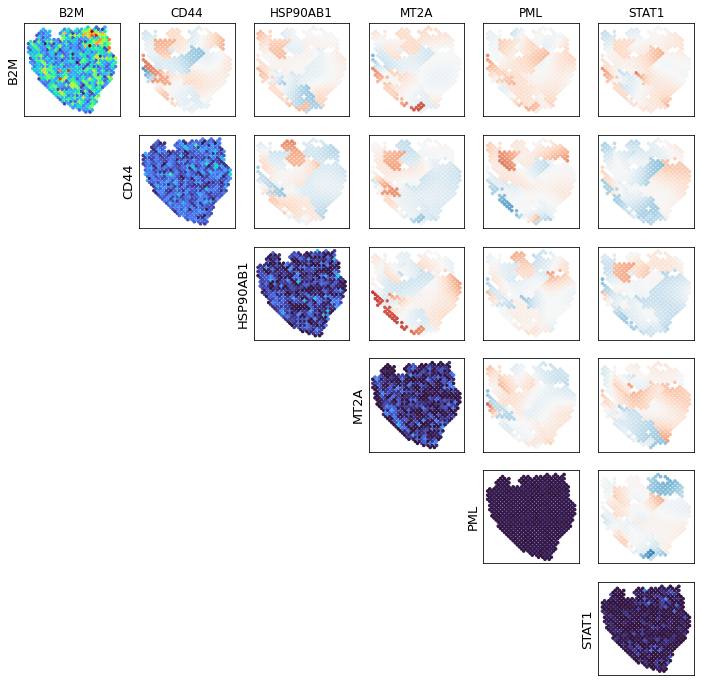

In [130]:
plot_gene_set_result(
    j_interferon_between, 
    'GO_INTERFERON_GAMMA_MEDIATED_SIGNALING_PATHWAY', 
    est_type='local',
    data_res_2=j_interferon_within,
    plot_conf=False
)

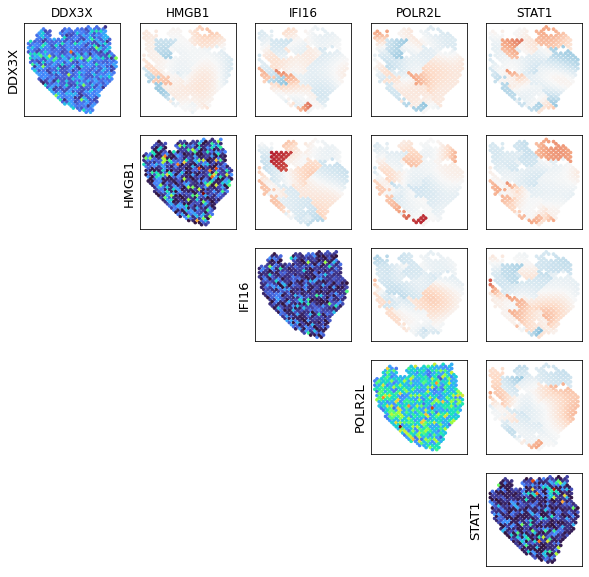

In [125]:
plot_gene_set_result(
    j_interferon_between, 
    'GO_POSITIVE_REGULATION_OF_TYPE_I_INTERFERON_PRODUCTION', 
    est_type='local',
    data_res_2=j_interferon_within,
    plot_conf=False,
)

# GO Epidermis Development

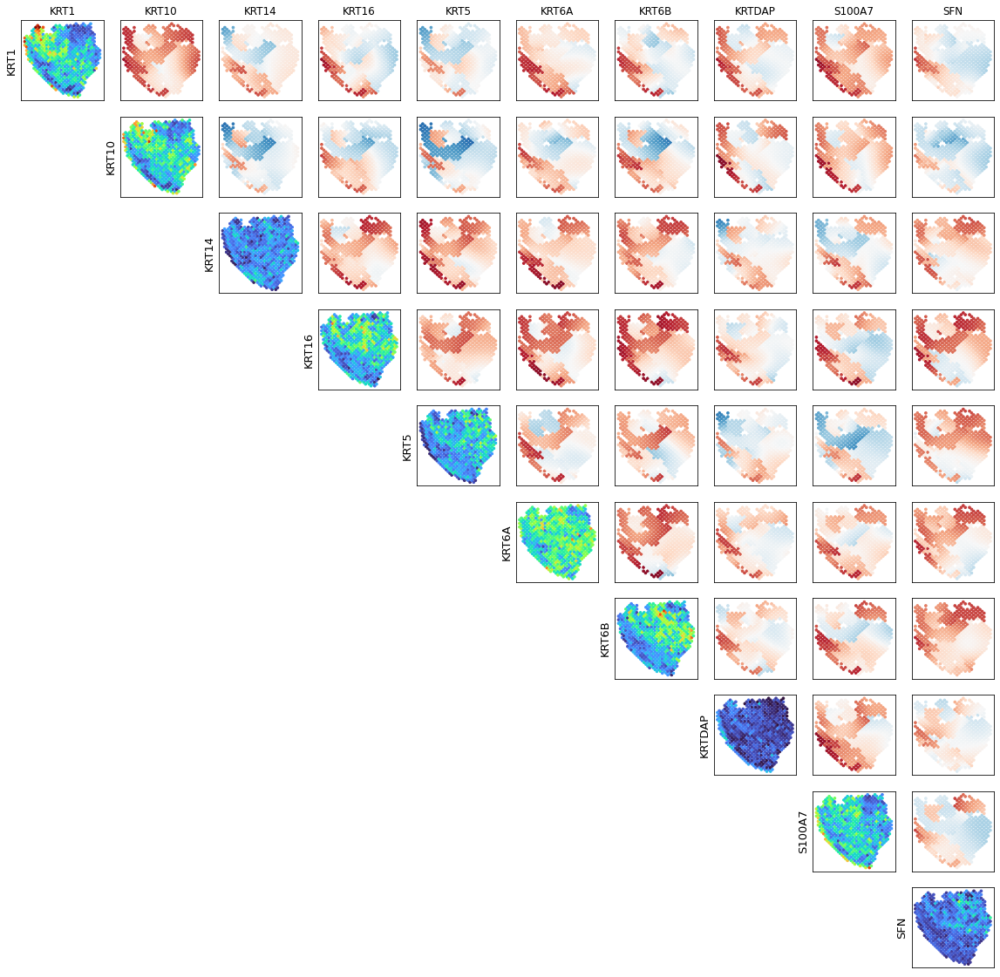

In [126]:
plot_gene_set_result(
    j_epidermis_dev_between, 
    'GO_EPIDERMIS_DEVELOPMENT', 
    est_type='local',
    data_res_2=j_epidermis_dev_within,
    plot_conf=False  
)

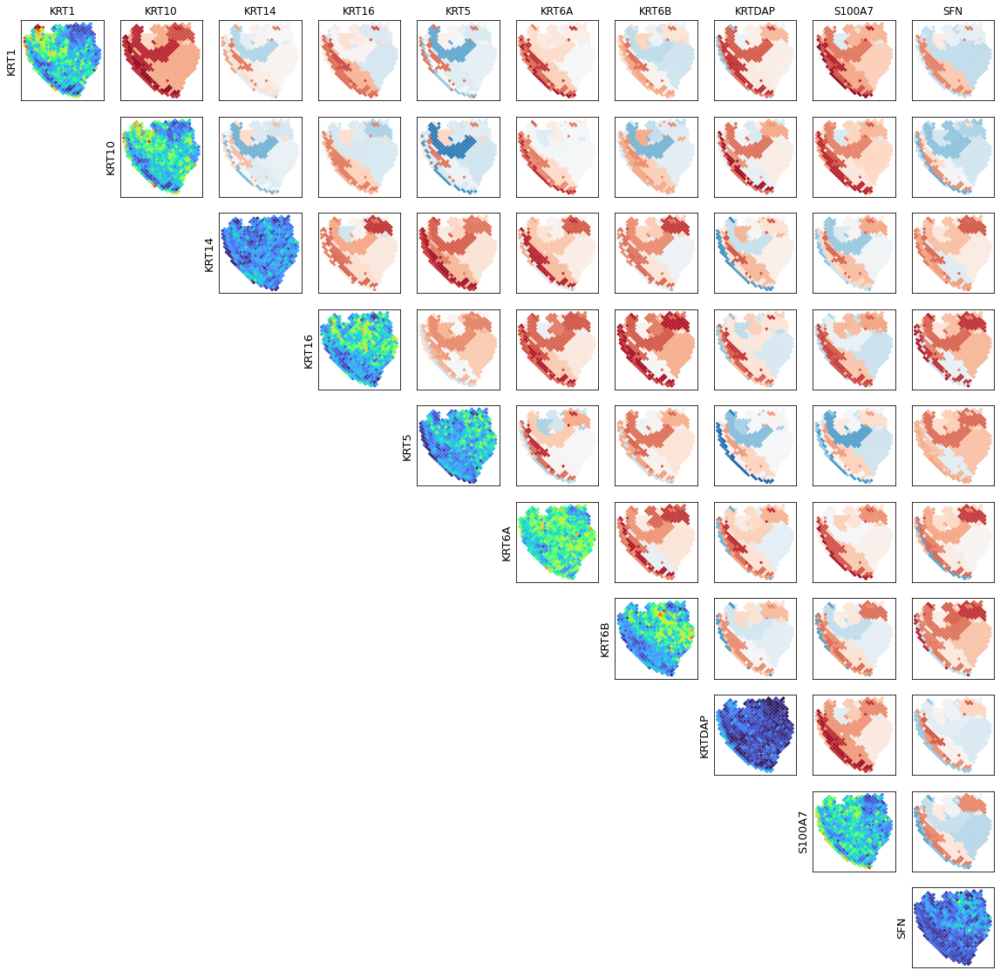

In [127]:
plot_gene_set_result(
    j_epidermis_dev_between, 
    'GO_EPIDERMIS_DEVELOPMENT', 
    est_type='regional',
    data_res_2=j_epidermis_dev_within,
    plot_conf=False  
)

## Gene pair of interest:  S100A7 and KRT5

Kept 3424/3820 spots.
Shape of neighborhood nulls matrix:  (3424, 100)
P-value: 0.002
Kept 3424/3820 spots.
Shape of neighborhood nulls matrix:  (3424, 100)
P-value: 0.002


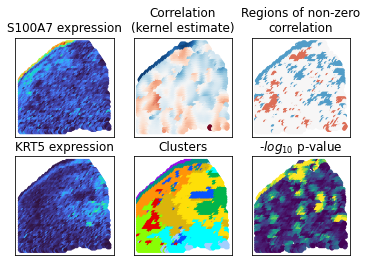

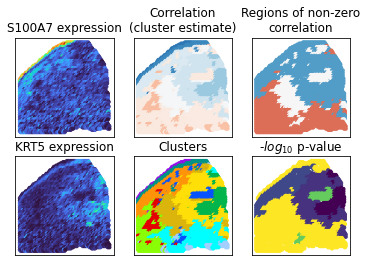

In [122]:
full_analysis_pair_2(
    'S100A7', 'KRT5',
    sigma=5, 
    max_perms=500, 
    n_procs=5, 
    test_between=False, 
    spot_to_neighbors=bc_to_neighs_clust_cond
)
full_analysis_pair_2(
    'S100A7', 'KRT5', 
    sigma=5, 
    max_perms=500, 
    n_procs=5, 
    test_between=True, 
    spot_to_neighbors=bc_to_neighs_full_clust
)

In [ ]:
##

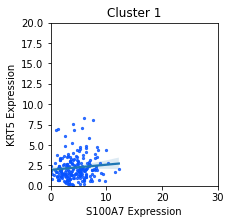

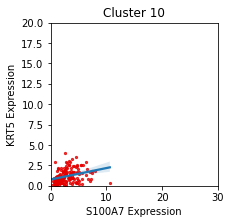

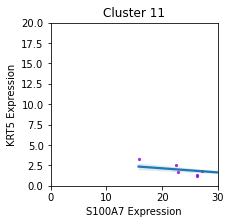

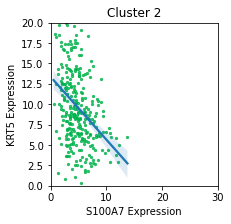

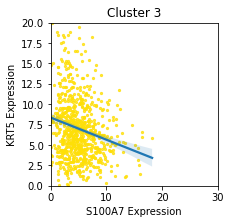

...

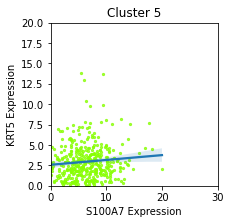

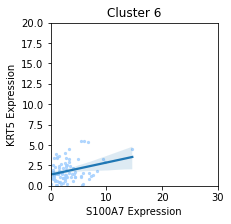

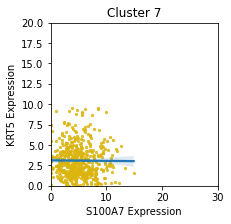

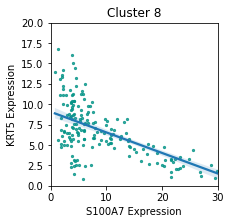

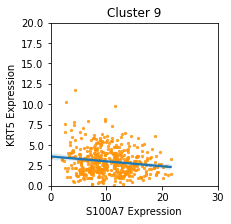

In [83]:
import matplotlib as mpl
for c_i, i in enumerate([0, 9, 10, 1, 2, 3, 4, 5, 6, 7, 8]):
    clust = str(i+1)
    plot_cluster_scatter('S100A7', 'KRT5', clust, color=spatialcorr.plot.PALETTE_MANY[c_i], xlim=(0, 30), ylim=(0,20))
    #plot_cluster_mvn('S100A7', 'KRT5', clust, xlim=(0, 30), ylim=(0,20))
    plt.title(f'Cluster {clust}')
    plt.show()

## Gene pair of interest KRT16 and S100A8

Kept 3424/3820 spots.
Shape of neighborhood nulls matrix:  (3424, 100)


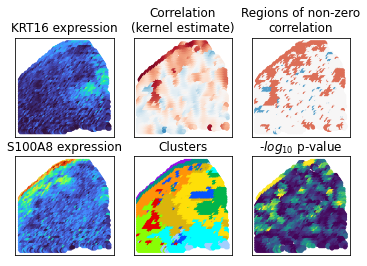

In [56]:
full_analysis_pair_2(
    'KRT16', 'S100A8', 
    sigma=5, 
    max_perms=500, 
    n_procs=5, 
    test_between=False, 
    spot_to_neighbors=bc_to_neighs_clust_cond
)

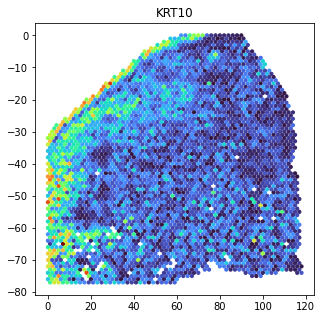

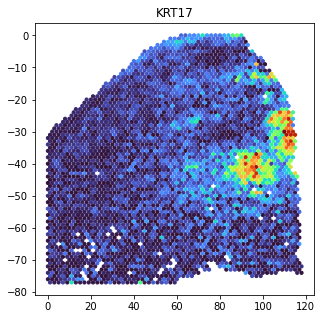

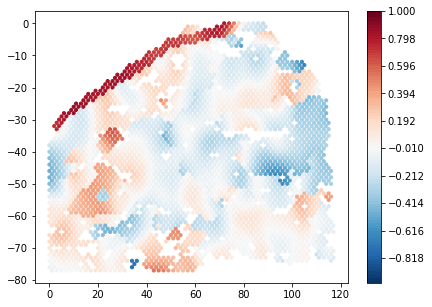

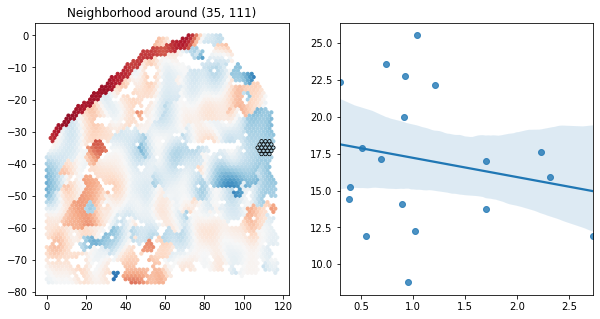

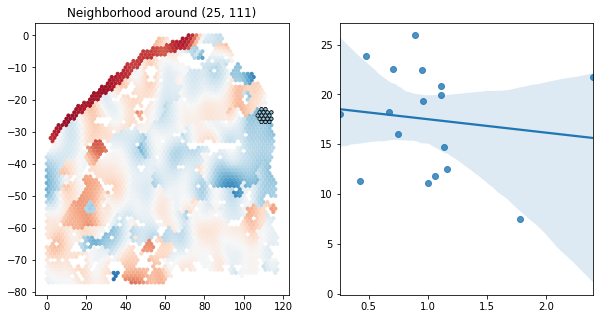

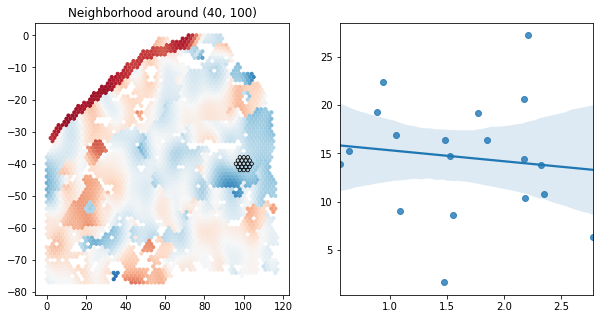

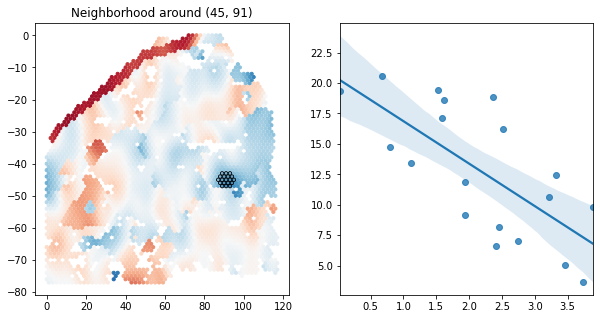

In [105]:
corrs, kept_inds = plot_within('KRT10', 'KRT17', condition='BayesSpace_11', sigma=5, dsize=10)
spatialcorr.plot_local_scatter(
    adata[kept_inds,:],
    'KRT10', 'KRT17',
    35,
    111,
    corrs,
    color_spots=None,
    row_key='row',
    col_key='col',
    condition='BayesSpace_11',
    cmap='RdBu_r',
    neighb_color='black'
)
spatialcorr.plot_local_scatter(
    adata[kept_inds,:],
    'KRT10', 'KRT17',
    25,
    111,
    corrs,
    color_spots=None,
    row_key='row',
    col_key='col',
    condition='BayesSpace_11',
    cmap='RdBu_r',
    neighb_color='black'
)
spatialcorr.plot_local_scatter(
    adata[kept_inds,:],
    'KRT10', 'KRT17',
    40,
    100,
    corrs,
    color_spots=None,
    row_key='row',
    col_key='col',
    condition='BayesSpace_11',
    cmap='RdBu_r',
    neighb_color='black'
)
spatialcorr.plot_local_scatter(
    adata[kept_inds,:],
    'KRT10', 'KRT17',
    45,
    91,
    corrs,
    color_spots=None,
    row_key='row',
    col_key='col',
    condition='BayesSpace_11',
    cmap='RdBu_r',
    neighb_color='black'
)

# GO Regulation of Epidermis Development

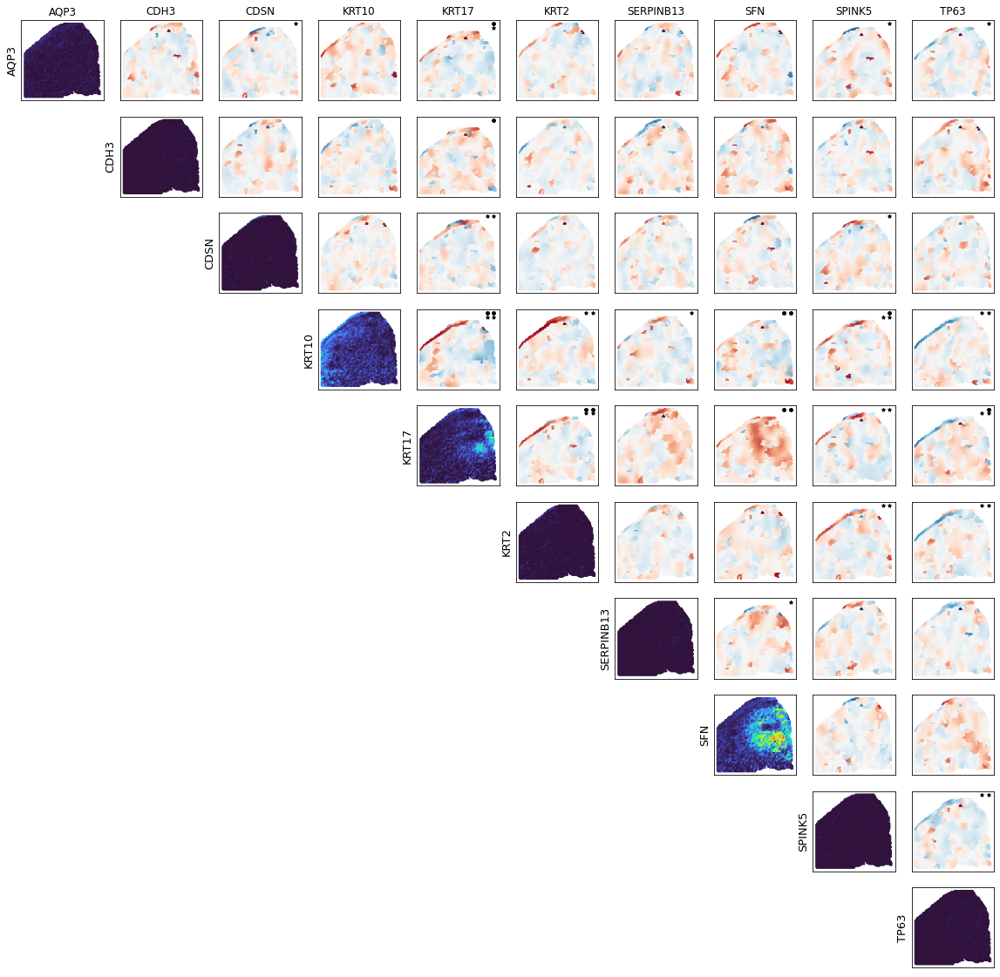

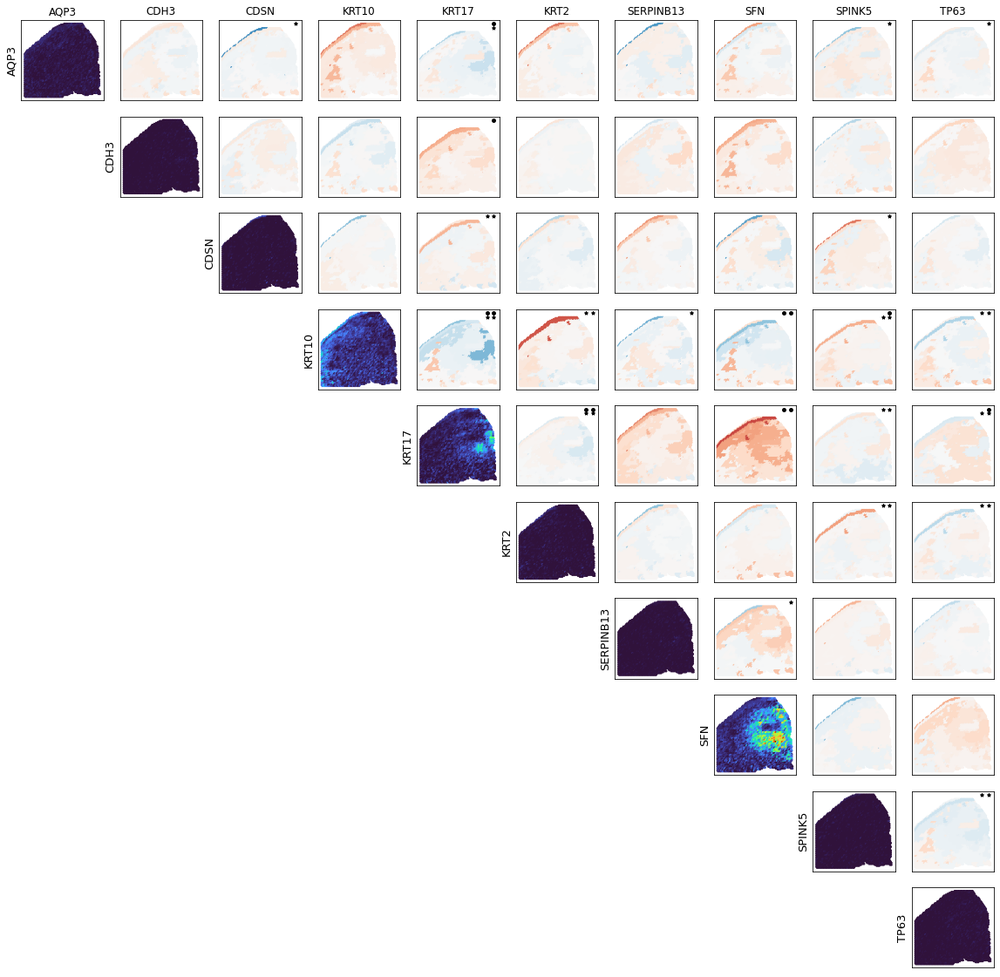

In [190]:
plot_gene_set_result(
    j_epidermis_dev_between, 
    'GO_REGULATION_OF_EPIDERMIS_DEVELOPMENT', 
    est_type='local',
    data_res_2=j_epidermis_dev_within
    
)
plot_gene_set_result(
    j_epidermis_dev_between, 
    'GO_REGULATION_OF_EPIDERMIS_DEVELOPMENT', 
    est_type='regional',
    data_res_2=j_epidermis_dev_within
    
)

Kept 3424/3820 spots.
P-value: 0.002
Kept 3424/3820 spots.
P-value: 0.132


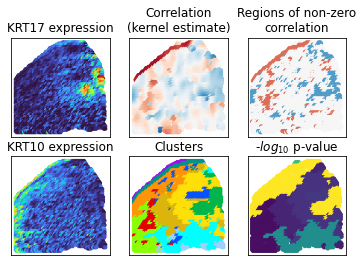

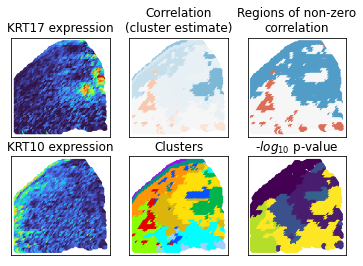

In [60]:
full_analysis_pair_2(
    'KRT17', 'KRT10',
    sigma=5, 
    max_perms=500, 
    n_procs=5, 
    test_between=False, 
    spot_to_neighbors=bc_to_neighs_clust_cond,
    spot_to_neighbors_clust=bc_to_neighs_full_clust
)
full_analysis_pair_2(
    'KRT17', 'KRT10', 
    sigma=5, 
    max_perms=500, 
    n_procs=5, 
    test_between=True, 
    spot_to_neighbors=bc_to_neighs_full_clust,
    spot_to_neighbors_clust=bc_to_neighs_full_clust
)

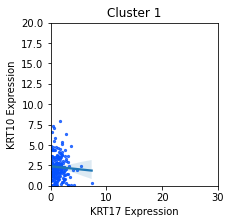

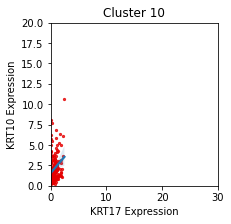

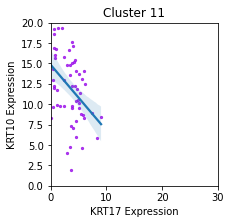

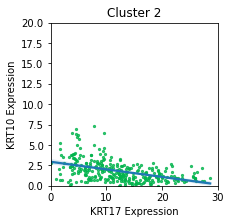

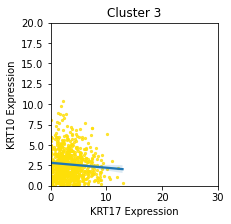

...

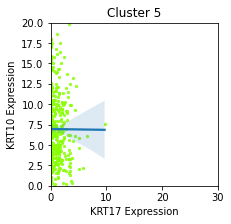

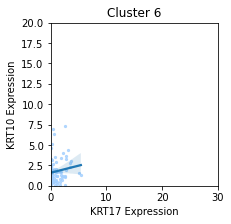

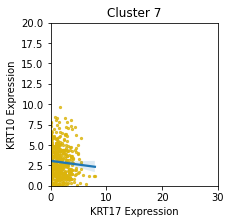

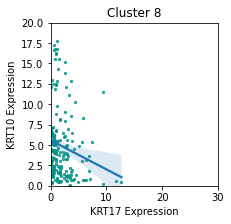

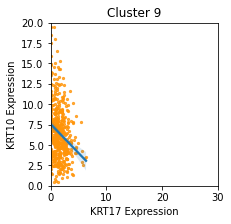

In [61]:
import matplotlib as mpl
for c_i, i in enumerate([0, 9, 10, 1, 2, 3, 4, 5, 6, 7, 8]):
    clust = str(i+1)
    plot_cluster_scatter('KRT17', 'KRT10', clust, color=spatialcorr.plot.PALETTE_MANY[c_i], xlim=(0, 30), ylim=(0,20))
    #plot_cluster_mvn('S100A7', 'KRT5', clust, xlim=(0, 30), ylim=(0,20))
    plt.title(f'Cluster {clust}')
    plt.show()

# GO Apoptotic signalling pathway

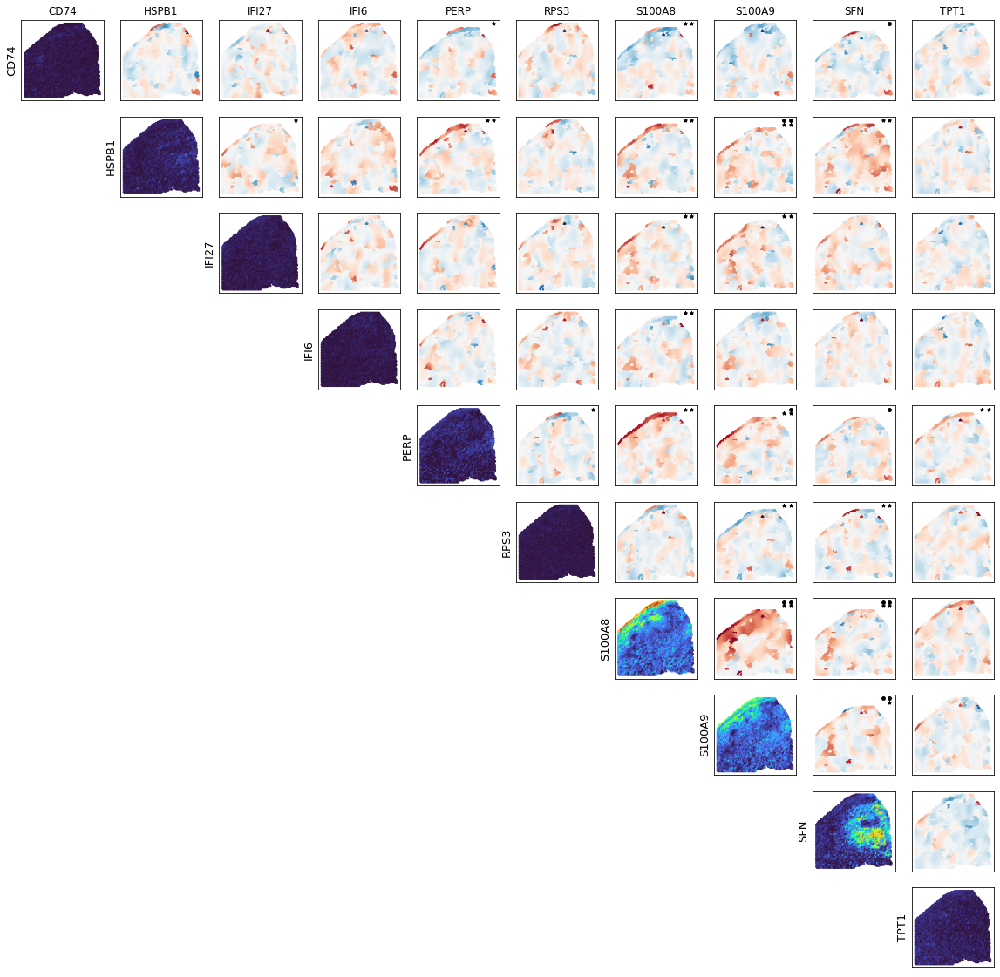

In [95]:
plot_gene_set_result(
    j_apoptosis_between, 
    'GO_APOPTOTIC_SIGNALING_PATHWAY', 
    est_type='local',
    data_res_2=j_apoptosis_within
    
)

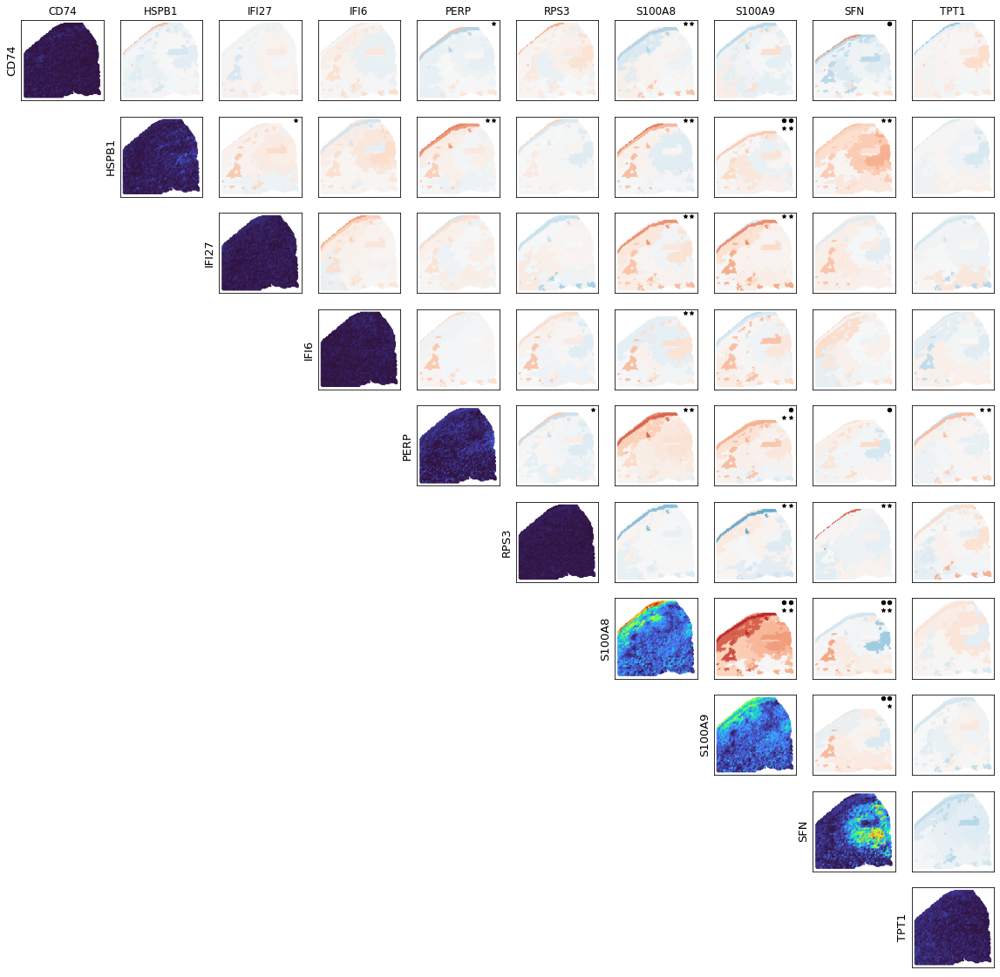

In [33]:
plot_gene_set_result(
    j_apoptosis_between, 
    'GO_APOPTOTIC_SIGNALING_PATHWAY', 
    est_type='regional',
    data_res_2=j_apoptosis_within,
    plot_conf=False
)

## GO Positive Regulation of Apoptotic Signaling Pathway

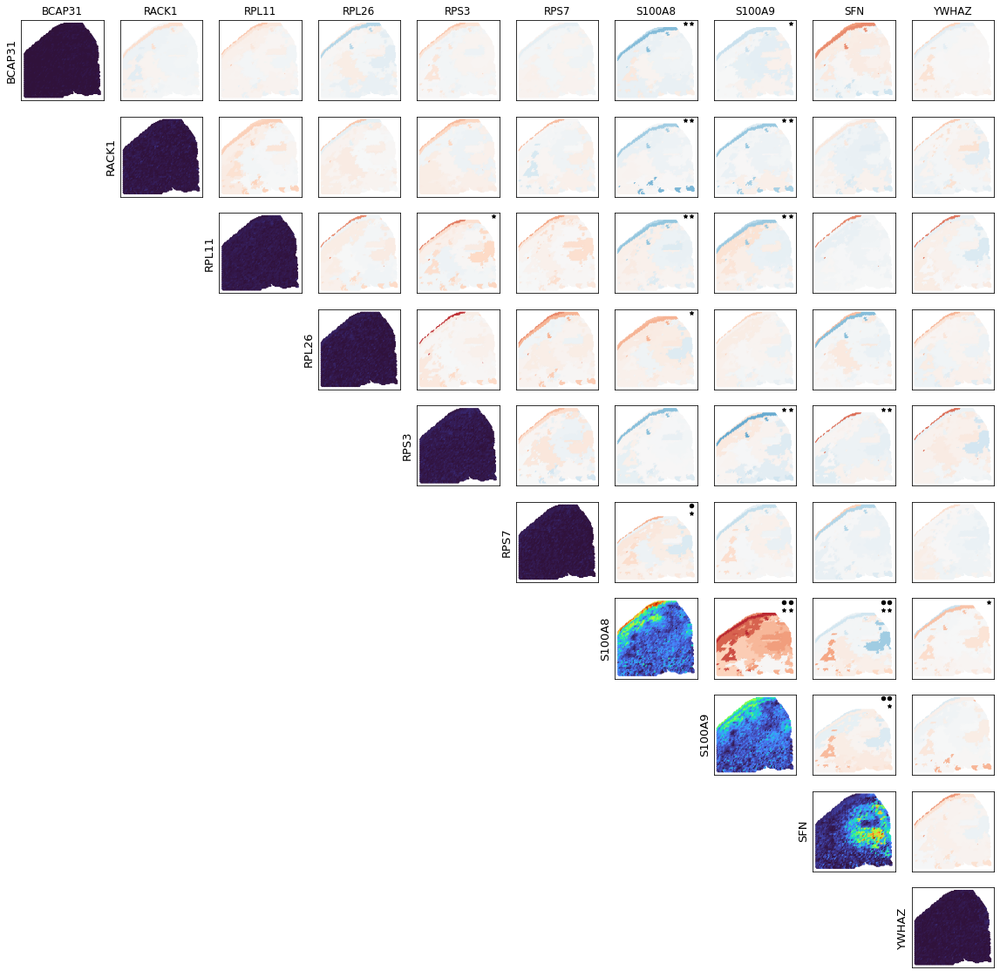

In [58]:
plot_gene_set_result(
    j_apoptosis_between, 
    'GO_POSITIVE_REGULATION_OF_APOPTOTIC_SIGNALING_PATHWAY', 
    est_type='regional',
    data_res_2=j_apoptosis_within,
    plot_conf=False
)

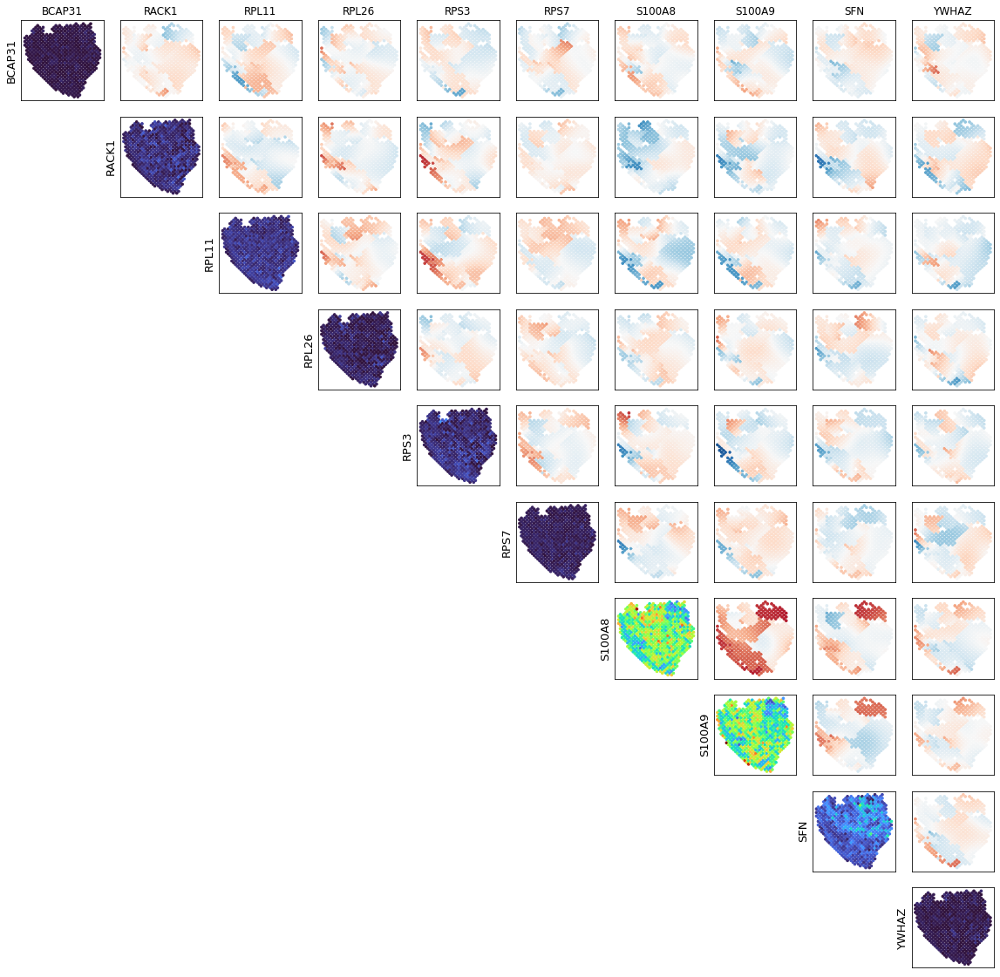

In [131]:
plot_gene_set_result(
    j_apoptosis_between, 
    'GO_POSITIVE_REGULATION_OF_APOPTOTIC_SIGNALING_PATHWAY', 
    est_type='local',
    data_res_2=j_apoptosis_within,
    plot_conf=False
)

# GO Intrinsic Apoptotic Signaling Pathway in Response to DNA Damage by P53 Class Mediator

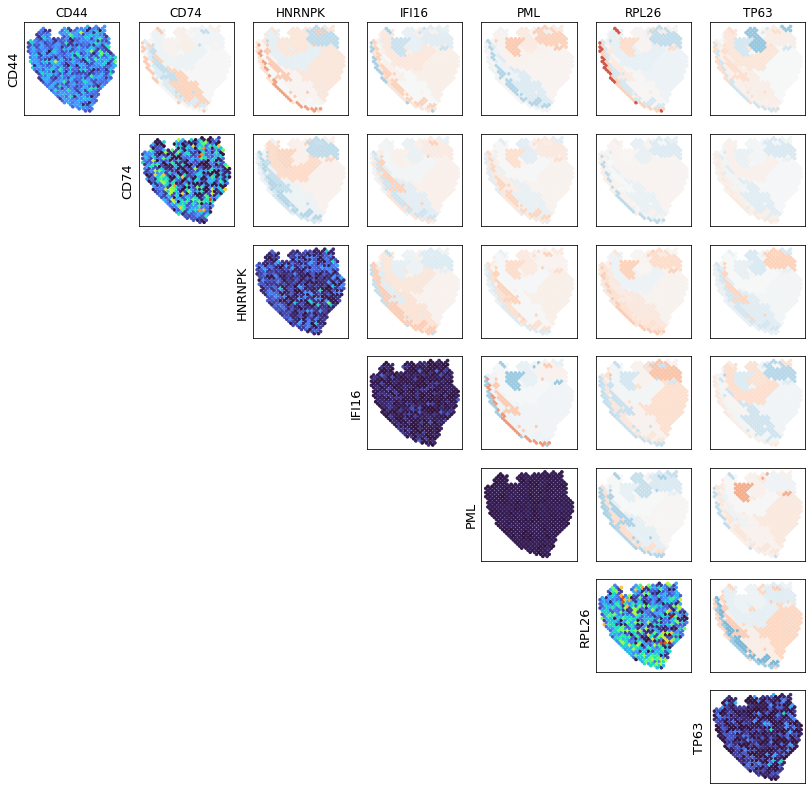

In [132]:
plot_gene_set_result(
    j_apoptosis_between, 
    'GO_INTRINSIC_APOPTOTIC_SIGNALING_PATHWAY_IN_RESPONSE_TO_DNA_DAMAGE_BY_P53_CLASS_MEDIATOR', 
    est_type='regional',
    data_res_2=j_apoptosis_within,
    plot_conf=False
)


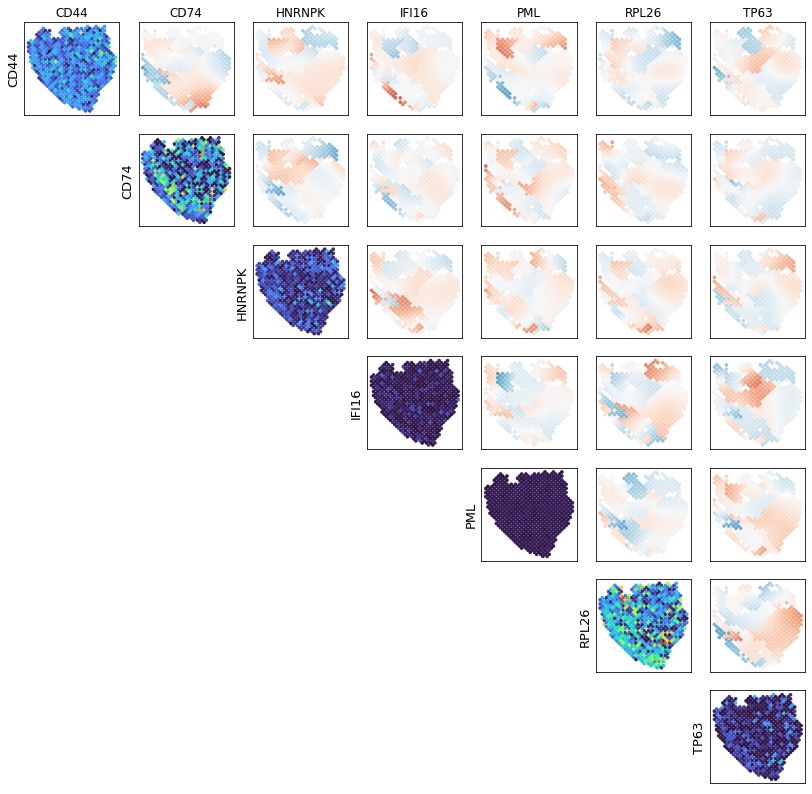

In [133]:
plot_gene_set_result(
    j_apoptosis_between, 
    'GO_INTRINSIC_APOPTOTIC_SIGNALING_PATHWAY_IN_RESPONSE_TO_DNA_DAMAGE_BY_P53_CLASS_MEDIATOR', 
    est_type='local',
    data_res_2=j_apoptosis_within,
    plot_conf=False
)



## Gene pair of interest: RPL26, TP63

Kept 468/620 spots.
P-value: 0.408
Kept 468/620 spots.
P-value: 0.01


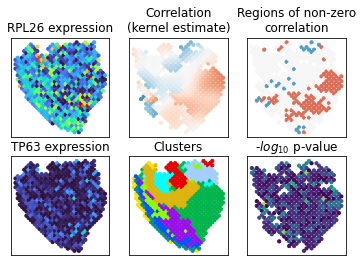

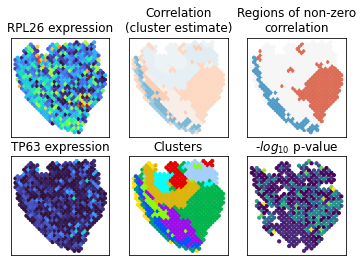

In [134]:
full_analysis_pair_2(
    'RPL26', 'TP63',
    sigma=5, 
    max_perms=500, 
    n_procs=5, 
    test_between=False, 
    spot_to_neighbors=bc_to_neighs_clust_cond
)
full_analysis_pair_2(
    'RPL26', 'TP63', 
    sigma=5, 
    max_perms=500, 
    n_procs=5, 
    test_between=True, 
    spot_to_neighbors=bc_to_neighs_full_clust
)

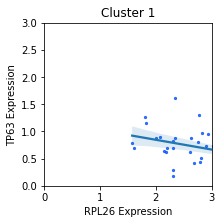

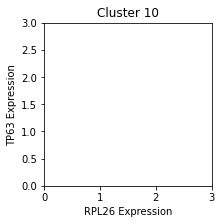

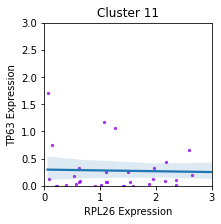

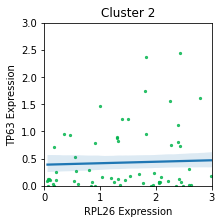

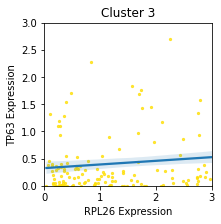

...

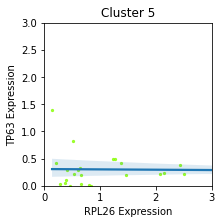

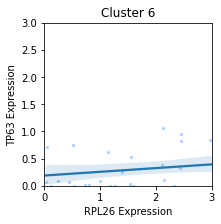

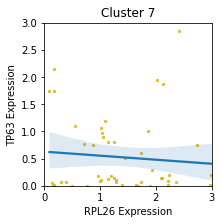

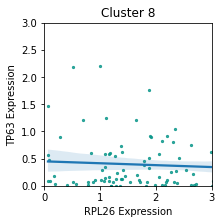

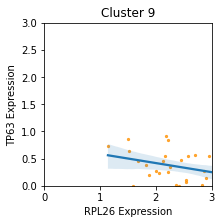

In [135]:
for c_i, i in enumerate([0, 9, 10, 1, 2, 3, 4, 5, 6, 7, 8]):
    clust = str(i+1)
    plot_cluster_scatter('RPL26', 'TP63', clust, color=spatialcorr.plot.PALETTE_MANY[c_i], xlim=(0, 3), ylim=(0,3))
    plt.title(f'Cluster {clust}')
    plt.show()

Kept 3424/3820 spots.
Shape of neighborhood nulls matrix:  (3424, 100)
P-value: 0.354
Kept 3424/3820 spots.
Shape of neighborhood nulls matrix:  (3424, 100)
P-value: 0.006


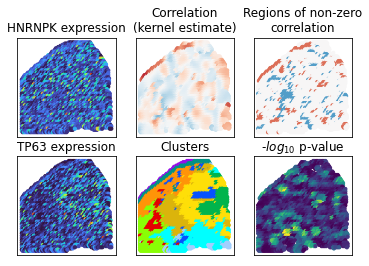

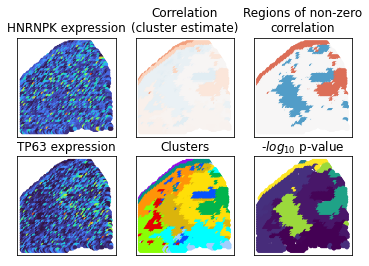

In [115]:
full_analysis_pair_2(
    'HNRNPK', 'TP63',
    sigma=5, 
    max_perms=500, 
    n_procs=5, 
    test_between=False, 
    spot_to_neighbors=bc_to_neighs_clust_cond
)
full_analysis_pair_2(
    'HNRNPK', 'TP63', 
    sigma=5, 
    max_perms=500, 
    n_procs=5, 
    test_between=True, 
    spot_to_neighbors=bc_to_neighs_full_clust
)

# GO Regulation of T Cell Activation

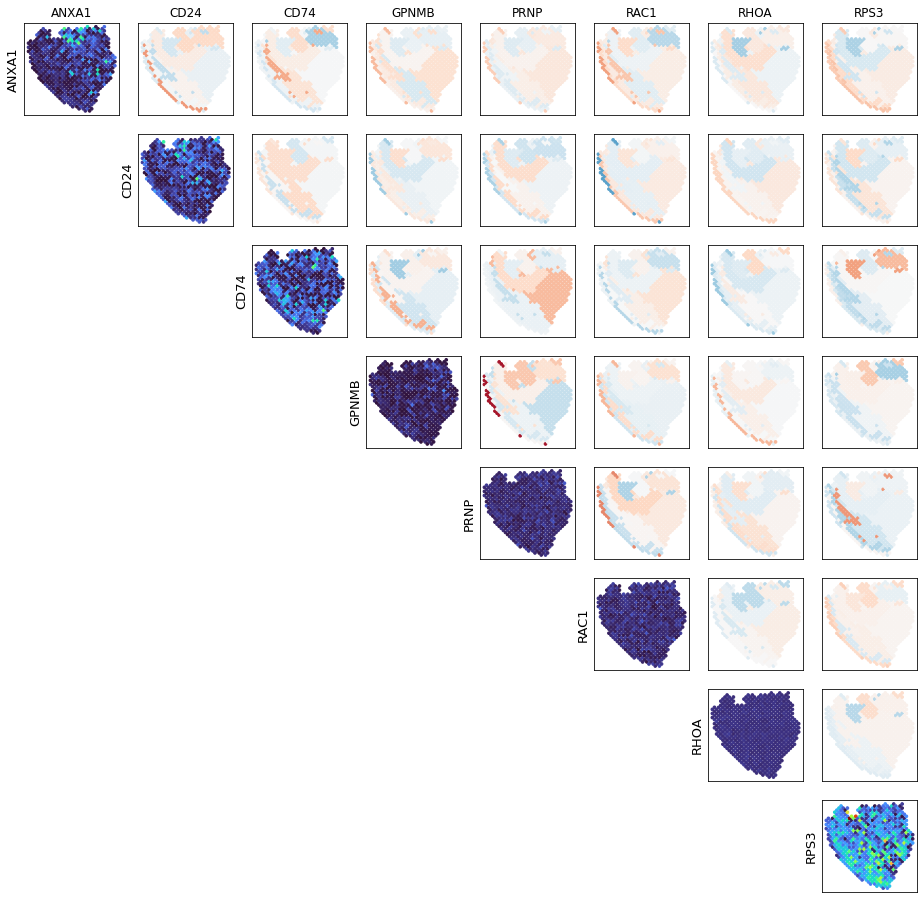

In [136]:
plot_gene_set_result(
    j_t_cell_between, 
    'GO_REGULATION_OF_T_CELL_ACTIVATION', 
    est_type='regional',
    data_res_2=j_t_cell_within,
    plot_conf=False
)

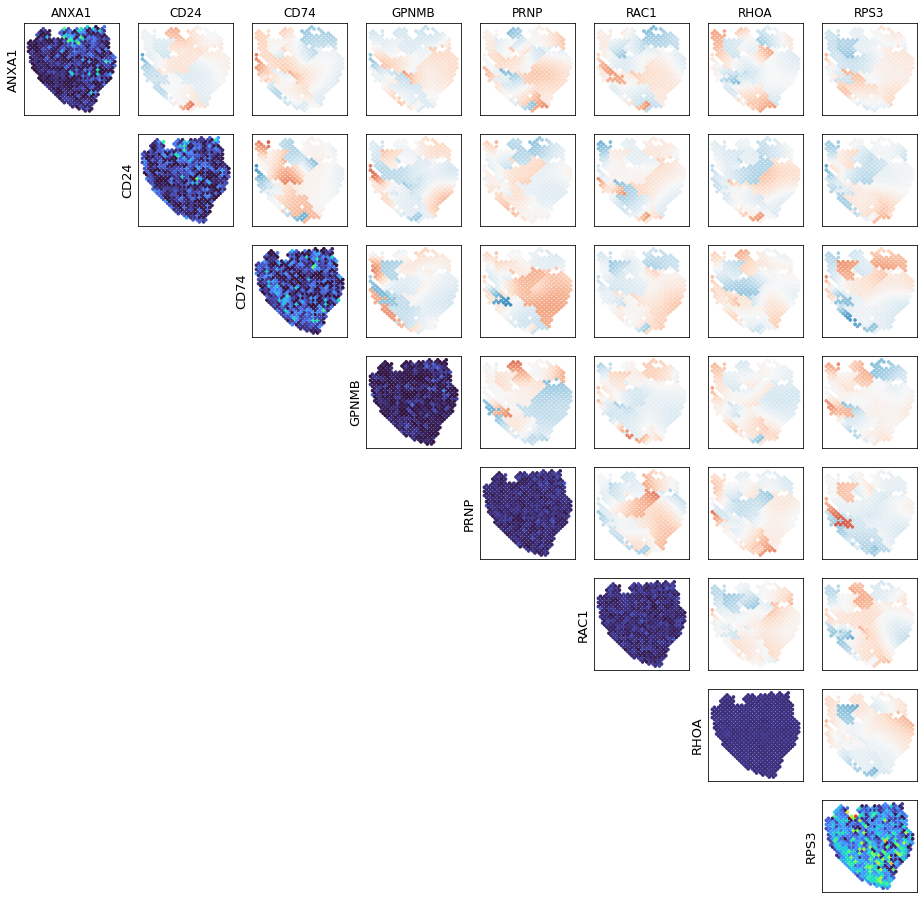

In [137]:
plot_gene_set_result(
    j_t_cell_between, 
    'GO_REGULATION_OF_T_CELL_ACTIVATION', 
    est_type='local',
    data_res_2=j_t_cell_within,
    plot_conf=False
)

In [138]:
gps, all_corrs = compute_pairwise_corrs(j_t_cell_within['gene_set_to_pairwise_pvals']['GO_REGULATION_OF_T_CELL_ACTIVATION'])

KeyError: 'Could not find key HLA-DPA1 in .var_names or .obs.columns.'

['#66c2a5', '#fc8d62', '#8da0cb', '#e78ac3', '#a6d854', '#ffd92f', '#e5c494', '#b3b3b3']


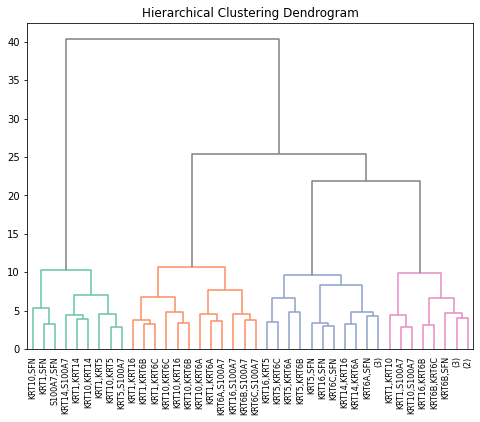

In [139]:
cluster_corrs(gps, all_corrs, color_thresh=12)

## Gene pair of interest: CD24, ANXA1

Kept 468/620 spots.
P-value: 0.834
Kept 468/620 spots.
P-value: 0.698


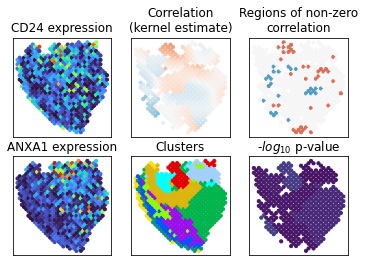

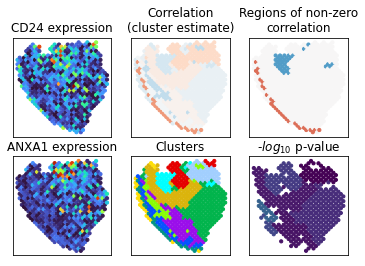

In [140]:
full_analysis_pair_2(
    'CD24', 'ANXA1',
    sigma=5, 
    max_perms=500, 
    n_procs=5, 
    test_between=False, 
    spot_to_neighbors=bc_to_neighs_clust_cond,
    spot_to_neighbors_clust=bc_to_neighs_full_clust
)
full_analysis_pair_2(
    'CD24', 'ANXA1', 
    sigma=5, 
    max_perms=500, 
    n_procs=5, 
    test_between=True, 
    spot_to_neighbors=bc_to_neighs_full_clust,
    spot_to_neighbors_clust=bc_to_neighs_full_clust
)

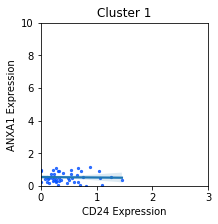

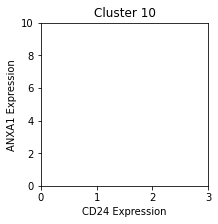

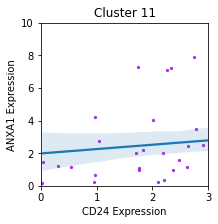

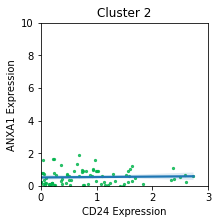

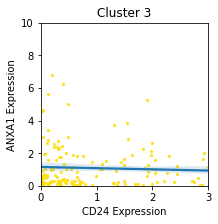

...

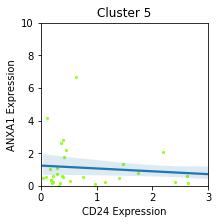

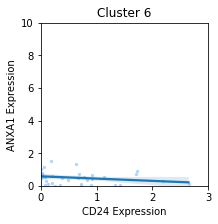

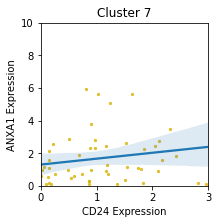

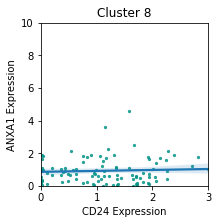

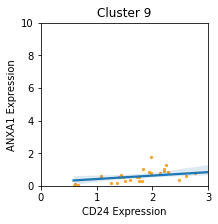

In [141]:
for c_i, i in enumerate([0, 9, 10, 1, 2, 3, 4, 5, 6, 7, 8]):
    clust = str(i+1)
    plot_cluster_scatter('CD24', 'ANXA1', clust, color=spatialcorr.plot.PALETTE_MANY[c_i], xlim=(0, 3), ylim=(0,10))
    plt.title(f'Cluster {clust}')
    plt.show()

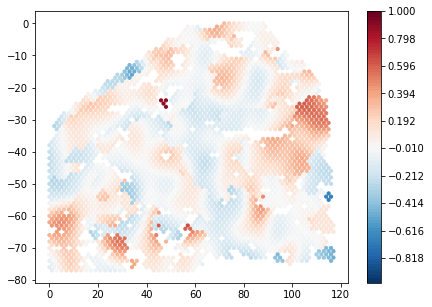

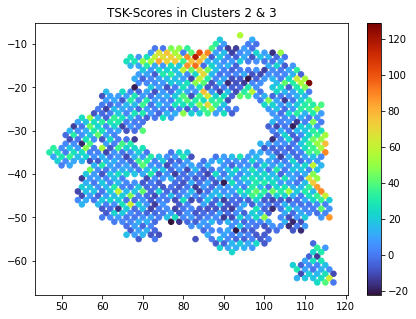

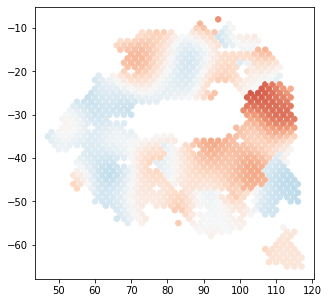

In [67]:
#corrs, keep_inds = corr_pos_neg('ANXA1', 'CD24', adata, bc_to_neighs=bc_to_neighs)
#corrs, keep_inds = plot_within('ANXA1', 'CD24', adata)
corrs, keep_inds, _ = spatialcorr.plot_correlation(
    adata,
    'ANXA1', 'CD24',
    sigma=5,
    contrib_thresh=10,
    kernel_matrix=None,
    row_key='row',
    col_key='col',
    condition='BayesSpace_11',
    cmap='RdBu_r',
    colorbar=True,
    ticks=True,
    estimate='local',
    dsize=10
)

plot_inds = sorted(set(clust_to_indices['3']+clust_to_indices['2']) & set(keep_inds))
corrs_restrict = [
    corr
    for corr, ind
    in zip(corrs, keep_inds)
    if ind in set(plot_inds)
]
inds_restrict = [
    ind
    for corr, ind
    in zip(corrs, keep_inds)
    if ind in set(plot_inds)
]
llrtp.plot_slide(
    adata.obs.iloc[plot_inds], 
    tsk_scores[plot_inds], 
    cmap='turbo',
    #vmin=-25,
    #vmax=100,
    colorbar=True,
    title='TSK-Scores in Clusters 2 & 3',
    dsize=30
)
plt.show()
llrtp.plot_slide(
    adata.obs.iloc[inds_restrict], 
    corrs_restrict, 
    cmap='RdBu_r',
    vmin=-1,
    vmax=1,
    dsize=30
)
plt.show()


JUNK?

In [ ]:
corrs, kept_inds, _ = spatialcorr.plot_correlation(
    adata,
    'IRF3', 'IRF7',
    sigma=7,
    contrib_thresh=10,
    kernel_matrix=None,
    row_key='row',
    col_key='col',
    condition='BayesSpace_11',
    corr_magnitude=False,
    cmap='RdBu_r',
    colorbar=False,
    ticks=False,
    ax=None,
    figure=None,
    estimate='local',
    dsize=3
)
plt.show()
spatialcorr.plot_local_scatter(
    adata[kept_inds,:],
    'IRF3', 'IRF7',
    47,
    21,
    corrs,
    color_spots=None,
    row_key='row',
    col_key='col',
    condition='BayesSpace_11',
    cmap='RdBu_r',
    neighb_color='red'
)

In [ ]:
plot_gene_set_result_between(j_interferon_between, 'GO_POSITIVE_REGULATION_OF_INTERFERON_GAMMA_BIOSYNTHETIC_PROCESS')

In [ ]:
sns.histplot(adata.obs_vector('KRT10'))
plt.show()

sns.histplot(adata.obs_vector('KRT17'))
plt.show()

sns.histplot(adata.obs_vector('SFN'))
plt.show()

In [ ]:
generate_gene_set_plots(
    ['HLA-E', 'IFI27', 'IFI6'], 
    adata,
    condition='BayesSpace_11',
    estimate_type='local',
    sigma=7
)
generate_gene_set_plots(
    ['HLA-E', 'IFI27', 'IFI6'], 
    adata,
    condition='BayesSpace_11',
    estimate_type='regional',
    sigma=7
)

In [ ]:
generate_gene_set_plots(
    ['RPL3', 'RPS2'], 
    adata,
    condition='BayesSpace_11',
    estimate_type='local',
    sigma=7
)
generate_gene_set_plots(
    ['RPL3', 'RPS2'],
    adata,
    condition='BayesSpace_11',
    estimate_type='regional',
    sigma=7
)


In [ ]:
generate_gene_set_plots(
    ['CD74', 'HSPB1', 'IFI27', 'IFI6', 'PERP', 'RPS3', 'S100A8', 'S100A9', 'SFN', 'TPT1'], 
    adata,
    condition='BayesSpace_11',
    estimate_type='local',
    sigma=7
)
generate_gene_set_plots(
    ['CD74', 'HSPB1', 'IFI27', 'IFI6', 'PERP', 'RPS3', 'S100A8', 'S100A9', 'SFN', 'TPT1'],
    adata,
    condition='BayesSpace_11',
    estimate_type='regional',
    sigma=7
)

In [ ]:
generate_gene_set_plots(
    [
        "CD74",
        "HSPB1",
        "IFI6",
        "RPS3",
        "S100A8",
        "S100A9",
        "SFN",
        "TPT1"
    ], 
    adata,
    condition='BayesSpace_11',
    estimate_type='local',
    sigma=7
)
generate_gene_set_plots(
    [
        "CD74",
        "HSPB1",
        "IFI6",
        "RPS3",
        "S100A8",
        "S100A9",
        "SFN",
        "TPT1"
    ], 
    adata,
    condition='BayesSpace_11',
    estimate_type='regional',
    sigma=7
)

In [ ]:
p_val, t_obs, t_nulls, keep_inds, obs_spot_lls, spotwise_t_nulls, spot_p_vals = spatialcorr.run_test(
    adata,
    ['KRT10', 'KRT17'],
    sigma=5,
    cond_key='BayesSpace_11',
    contrib_thresh=10,
    row_key='row',
    col_key='col',
    verbose=1,
    n_procs=5,
    test_between_conds=True,
    compute_spotwise_pvals=True,
    max_perms=500,
    standardize_var=False
)
print("P-value: ", p_val)

p_val, t_obs, t_nulls, keep_inds, obs_spot_lls, spotwise_t_nulls, spot_p_vals = spatialcorr.run_test(
    adata,
    ['KRT10', 'KRT17'],
    sigma=5,
    cond_key='BayesSpace_11',
    contrib_thresh=10,
    row_key='row',
    col_key='col',
    verbose=1,
    n_procs=5,
    test_between_conds=True,
    compute_spotwise_pvals=True,
    max_perms=500,
    standardize_var=True
)
print("P-value: ", p_val)

In [ ]:
p_val, t_obs, t_nulls, keep_inds, obs_spot_lls, spotwise_t_nulls, spot_p_vals = spatialcorr.run_test(
    adata,
    ['KRT14', 'KRT16'],
    sigma=5,
    cond_key='BayesSpace_11',
    contrib_thresh=10,
    row_key='row',
    col_key='col',
    verbose=1,
    n_procs=5,
    test_between_conds=True,
    compute_spotwise_pvals=True,
    max_perms=500,
    standardize_var=False
)
print("P-value: ", p_val)

p_val, t_obs, t_nulls, keep_inds, obs_spot_lls, spotwise_t_nulls, spot_p_vals = spatialcorr.run_test(
    adata,
    ['KRT14', 'KRT16'],
    sigma=5,
    cond_key='BayesSpace_11',
    contrib_thresh=10,
    row_key='row',
    col_key='col',
    verbose=1,
    n_procs=5,
    test_between_conds=False,
    compute_spotwise_pvals=True,
    max_perms=500,
    standardize_var=True
)
print("P-value: ", p_val)

In [ ]:
p_val, t_obs, t_nulls, keep_inds, obs_spot_lls, spotwise_t_nulls, spot_p_vals = spatialcorr.run_test(
    adata,
    ['S100A7', 'KRT1'],
    sigma=5,
    cond_key='BayesSpace_11',
    contrib_thresh=10,
    row_key='row',
    col_key='col',
    verbose=1,
    n_procs=5,
    test_between_conds=True,
    compute_spotwise_pvals=True,
    max_perms=500,
    standardize_var=False
)
print("P-value: ", p_val)

p_val, t_obs, t_nulls, keep_inds, obs_spot_lls, spotwise_t_nulls, spot_p_vals = spatialcorr.run_test(
    adata,
    ['S100A7', 'KRT1'],
    sigma=5,
    cond_key='BayesSpace_11',
    contrib_thresh=10,
    row_key='row',
    col_key='col',
    verbose=1,
    n_procs=5,
    test_between_conds=False,
    compute_spotwise_pvals=True,
    max_perms=500,
    standardize_var=True
)
print("P-value: ", p_val)

In [ ]:
p_val, t_obs, t_nulls, keep_inds, obs_spot_lls, spotwise_t_nulls, spot_p_vals = spatialcorr.run_test(
    adata,
    ['SFN', 'KRT1'],
    sigma=5,
    cond_key='BayesSpace_11',
    contrib_thresh=10,
    row_key='row',
    col_key='col',
    verbose=1,
    n_procs=5,
    test_between_conds=True,
    compute_spotwise_pvals=False,
    max_perms=500,
    standardize_var=False
)
print("P-value: ", p_val)

p_val, t_obs, t_nulls, keep_inds, obs_spot_lls, spotwise_t_nulls, spot_p_vals = spatialcorr.run_test(
    adata,
    ['SFN', 'KRT1'],
    sigma=5,
    cond_key='BayesSpace_11',
    contrib_thresh=10,
    row_key='row',
    col_key='col',
    verbose=1,
    n_procs=5,
    test_between_conds=False,
    compute_spotwise_pvals=False,
    max_perms=500,
    standardize_var=True
)
print("P-value: ", p_val)

In [ ]:
generate_gene_set_plots(
    ['KRT1', 'KRT14', 'KRT16', 'KRT6A', 'KRT6B', 'S100A7', 'SFN'], 
    adata,
    condition='BayesSpace_11',
    estimate_type='local',
    sigma=7
)
generate_gene_set_plots(
    ['KRT1', 'KRT14', 'KRT16', 'KRT6A', 'KRT6B', 'S100A7', 'SFN'],
    adata,
    condition='BayesSpace_11',
    estimate_type='regional',
    sigma=7
)

In [ ]:
generate_gene_set_plots(
    ['CALML5', 'CSTA', 'DSP', 'FABP5', 'KRT1', 'KRT10', 'KRT14', 'KRT16', 'KRT17', 'KRT5', 'KRT6A', 'KRT6B', 'KRT6C', 'KRTDAP', 'PERP', 'PI3', 'S100A7', 'SFN', 'SPRR1B'], 
    adata,
    condition='BayesSpace_11',
    estimate_type='local',
    sigma=7
)
generate_gene_set_plots(
    ['CALML5', 'CSTA', 'DSP', 'FABP5', 'KRT1', 'KRT10', 'KRT14', 'KRT16', 'KRT17', 'KRT5', 'KRT6A', 'KRT6B', 'KRT6C', 'KRTDAP', 'PERP', 'PI3', 'S100A7', 'SFN', 'SPRR1B'],
    adata,
    condition='BayesSpace_11',
    estimate_type='regional',
    sigma=7
)


In [ ]:

generate_gene_set_plots(
    ['FBXW7', 'MCL1', 'PARK7', 'SFPQ', 'SOD1'], 
    adata,
    condition='BayesSpace_11',
    estimate_type='regional'
)
generate_gene_set_plots(
    ['FBXW7', 'MCL1', 'PARK7', 'SFPQ', 'SOD1'], 
    adata,
    condition='BayesSpace_11',
    estimate_type='local',
    sigma=5
)

In [ ]:
# Apoptosis-related
generate_gene_set_plots(
    ['BNIP3', 'LAMP1', 'SRGN', 'UBE4B'], 
    adata,
    condition='BayesSpace_11',
    estimate_type='regional'
)
generate_gene_set_plots(
    ['BNIP3', 'LAMP1', 'SRGN', 'UBE4B'], 
    adata,
    condition='BayesSpace_11',
    estimate_type='local',
    sigma=5
)

In [ ]:
j_epidermis_dev_within

In [ ]:
plot_gene_set_result_between(j_epidermis_dev_within, 'GO_POSITIVE_REGULATION_OF_EPIDERMIS_DEVELOPMENT')

In [ ]:
generate_gene_set_plots(
    j_epidermis_dev_within['gene_set_to_genes']['GO_NEGATIVE_REGULATION_OF_EPIDERMIS_DEVELOPMENT'], 
    adata,
    condition='BayesSpace_11',
    estimate_type='regional'
)

In [ ]:
generate_gene_set_plots(
    j_keratinocyte_within['gene_set_to_genes']['GO_POSITIVE_REGULATION_OF_KERATINOCYTE_PROLIFERATION'], 
    adata,
    condition='BayesSpace_11',
    sigma=10
)

In [ ]:
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
generate_gene_set_plots(
    j_keratinocyte_within['gene_set_to_genes']['GO_NEGATIVE_REGULATION_OF_KERATINOCYTE_PROLIFERATION'], 
    adata,
    sigma=10
)